In [1]:
import os
import re
import sys

import itertools
import numpy as np
import pandas as pd
from scipy.stats import zscore, iqr, probplot

import pytorch_lightning as pl
import scanpy as sc
import torch
import torch.nn as nn

import matplotlib.pyplot as plt
from matplotlib import cm, colors
from matplotlib.lines import Line2D
import seaborn as sns
import textwrap
from textwrap import wrap

import gseapy as gp

pl.seed_everything(32)

sys.path.append("/data/danai/scripts/LIVI/")
from src.analysis._utils import select_important_genes_for_factor_IQR, calculate_GxC_effect, calculate_GxC_gene_effect
from src.analysis.plotting import QQplot, make_gp_dotplot, plot_ct_gex_vs_gt, plot_gene_loadings_for_factor, plot_gene_loadings_for_associated_variable, visualize_GxC_effect

Seed set to 32
/data/danai/miniforge3/envs/LIVIenv_py311/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
Seed set to 32


In [2]:
adata = sc.read_h5ad("/data/danai/Data/OneK1K/LogNorm_counts_across_celltypes_DCRM_protein-coding_Azimuth_only-immune-cells_HVG-HEX-10K.h5ad")
adata

AnnData object with n_obs × n_vars = 1172790 × 14212
    obs: 'orig_ident', 'nCount_RNA', 'nFeature_RNA', 'pool', 'individual', 'percent_mt', 'latent', 'nCount_SCT', 'nFeature_SCT', 'cell_type', 'cell_label', 'sex', 'age', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_MITO', 'log1p_total_counts_MITO', 'pct_counts_MITO', 'total_counts_RIBO', 'log1p_total_counts_RIBO', 'pct_counts_RIBO', 'total_counts_ERCC', 'log1p_total_counts_ERCC', 'pct_counts_ERCC', 'n_genes', 'Norm_factors', 'major_celltype', 'predicted_celltype_l0', 'predicted_celltype_l1', 'predicted_celltype_l2', 'original_celltype', 'new_predicted_celltype_l2', 'new_predicted_celltype_l0', 'new_predicted_celltype_l1'
    var: 'GeneSymbol', 'features', 'MITO', 'RIBO', 'ERCC', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'downregulated_NK', '

In [3]:
gene_anno = pd.read_csv("/data/danai/Data/OneK1K/OneK1K_HVG-HEX-10K_geneIDs_Biomart.txt", sep="\t", index_col=0)
gene_anno.rename(columns={"Gene stable ID":"feature_id", 
                         "Gene name":"gene_name",
                         "Chromosome/scaffold name":"gene_chromosome", 
                         "Gene start (bp)":"gene_start", 
                         "Gene end (bp)":"gene_end"},
                inplace=True)
gene_anno

,gene_start,gene_chromosome,gene_end,gene_name
Gene stable ID,,,,
ENSG00000000419,49551404,20,49575092,DPM1
ENSG00000000457,169818772,1,169863408,SCYL3
ENSG00000000460,169631245,1,169823221,C1orf112
ENSG00000000938,27938575,1,27961788,FGR
ENSG00000000971,196621008,1,196716634,CFH
...,...,...,...,...
ENSG00000273269,47293080,2,47403650,RP11-761B3.1
ENSG00000273274,32930670,1,32962287,ZBTB8B
ENSG00000273294,33987279,5,34124633,RP11-1084J3.4


In [4]:
adata.var.GeneSymbol = adata.var.GeneSymbol.str.strip()
adata.var = adata.var.merge(gene_anno.filter(["gene_chromosome", "gene_start", "gene_end"]), right_index=True, left_index=True)
adata.var = adata.var.assign(upstream_5MB = adata.var.apply(lambda x: max(0, x.gene_start - 5000000), axis=1),
                             downstream_5MB = adata.var.apply(lambda x: x.gene_end + 5000000, axis=1))
adata.var

,GeneSymbol,features,MITO,RIBO,ERCC,n_cells_by_counts,mean_counts,log1p_mean_counts,pct_dropout_by_counts,total_counts,...,downregulated_B,upregulated_Mono,downregulated_Mono,upregulated_DC,downregulated_DC,gene_chromosome,gene_start,gene_end,upstream_5MB,downstream_5MB
ENSG00000257019,OR13C2,OR13C2,False,False,False,3,0.000002,0.000002,99.999764,3.0,...,False,False,False,False,False,9,107366924,107367951,102366924,112367951
ENSG00000166987,MBD6,MBD6,False,False,False,34604,0.027840,0.027459,97.280605,35426.0,...,True,True,False,False,True,12,57914493,57923931,52914493,62923931
ENSG00000170624,SGCD,SGCD,False,False,False,1844,0.001487,0.001486,99.855087,1892.0,...,True,True,True,False,True,5,155297354,156194799,150297354,161194799
ENSG00000140519,RHCG,RHCG,False,False,False,2,0.000002,0.000002,99.999843,2.0,...,False,False,False,False,False,15,89998680,90039844,84998680,95039844
ENSG00000117115,PADI2,PADI2,False,False,False,2728,0.002279,0.002276,99.785617,2900.0,...,True,True,False,True,True,1,17393256,17445948,12393256,22445948
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ENSG00000185811,IKZF1,IKZF1,False,False,False,338926,0.332737,0.287235,73.365114,423404.0,...,True,True,True,False,True,7,50343720,50472799,45343720,55472799
ENSG00000234465,PINLYP,PINLYP,False,False,False,3098,0.002490,0.002487,99.756540,3168.0,...,False,False,False,False,False,19,44080952,44088116,39080952,49088116
ENSG00000170615,SLC26A5,SLC26A5,False,False,False,685,0.000540,0.000540,99.946168,687.0,...,False,False,False,False,False,7,102993177,103086624,97993177,108086624
ENSG00000151778,SERP2,SERP2,False,False,False,2513,0.002013,0.002011,99.802513,2561.0,...,True,True,True,False,True,13,44947801,44971850,39947801,49971850


In [5]:
# COLORS FROM THE ORIGINAL PUBLICATION
cell_label_colors = {
    "CD4 SOX4": "#D6C1DE", # SOX4+ CD4 T cells
    "CD4 NC": "#882E72", # CD4 naive T cells
    "CD4 ET": "#B178A6", # CD4 effector T cells
    "CD8 NC": "#5289C7", # CD8 naive T cells
    "CD8 S100B": "#7BAFDE", # S100B+ CD8 cells
    "CD8 ET": "#1965B0", # CD8 effector cells 
    "NK": "#4EB265",
    "NK R": "#90C987", # NK recruiting cells
    "B IN": "#F6C141",
    "B Mem": "#F7EE55",
    "Mono C": "#F1932D", # classical monocytes
    "Mono NC": "#E8601C", # non-classical monocytes
    "DC": "#DC050C",
    "Plasma": "#CAE0AB",
}

# matching colros for major (L1) celltype
major_celltype_colors = {
    "CD4T": "darkmagenta",
    "CD8T": "steelblue", 
    "NK": "mediumseagreen",
    "B": "gold",
    "Mono": "orange",
    "DC": "#DC050C",
    "Plasma": "#CAE0AB",
}

In [6]:
adata.uns["cell_label_colors"] = [cell_label_colors[ct] for ct in adata.obs.cell_label.cat.categories]

In [7]:
background_genes = adata.var.GeneSymbol

names = gp.get_library_name("Human")

# databases_bio = ["GO_Biological_Process_2023", "Elsevier_Pathway_Collection",  "GO_Molecular_Function_2023", "KEGG_2021_Human", "Reactome_2022"] 
databases_bio = ["GO_Biological_Process_2023", "GO_Molecular_Function_2023", "KEGG_2021_Human", "Reactome_2022"] 

databases_disease = ["DisGeNET", "Disease_Signatures_from_GEO_up_2014", "Disease_Signatures_from_GEO_down_2014", "RNA-Seq_Disease_Gene_and_Drug_Signatures_from_GEO",
                     "Human_Phenotype_Ontology", "UK_Biobank_GWAS_v1"]

databases_disease_min = ["DisGeNET", "Disease_Signatures_from_GEO_up_2014", "Disease_Signatures_from_GEO_down_2014", "Human_Phenotype_Ontology", "UK_Biobank_GWAS_v1"]


In [8]:
cis_eQTLGen_hvgs = pd.read_csv("/data/danai/Data/eQTLGen_cis-eQTLs_trans-eQTLGen-disease-associated-SNPs_OneK1K-10K-HVG-HEX.tsv", sep="\t")
cis_eQTLGen_hvgs

,Pvalue,SNP,SNPChr,SNPPos,AssessedAllele,OtherAllele,Zscore,Gene,GeneSymbol,GeneChr,GenePos,NrCohorts,NrSamples,FDR,BonferroniP,snp_id
0,3.271700e-310,rs2910686,5,96252589,C,T,163.6570,ENSG00000164308,ERAP2,5,96233531,34,26454,0.000000,4.166200e-302,5:96252589
1,3.271700e-310,rs27290,5,96350088,G,A,160.0384,ENSG00000164308,ERAP2,5,96233531,35,26568,0.000000,4.166200e-302,5:96350088
2,3.271700e-310,rs1363907,5,96252803,A,G,151.8370,ENSG00000164308,ERAP2,5,96233531,34,26454,0.000000,4.166200e-302,5:96252803
3,3.271700e-310,rs2549794,5,96244549,C,T,150.5419,ENSG00000164308,ERAP2,5,96233531,33,26070,0.000000,4.166200e-302,5:96244549
4,3.271700e-310,rs4761234,12,69732105,C,T,-143.3691,ENSG00000090382,LYZ,12,69745067,35,31353,0.000000,4.166200e-302,12:69732105
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25958,2.013400e-05,rs114676850,6,32208324,T,C,-4.2634,ENSG00000204444,APOM,6,31623090,12,7715,0.049865,1.000000e+00,6:32208324
25959,2.013400e-05,rs116035112,6,31364707,A,G,-4.2634,ENSG00000204386,NEU1,6,31828059,13,8491,0.049865,1.000000e+00,6:31364707
25960,2.015200e-05,rs116026314,6,31870326,A,G,-4.2630,ENSG00000234745,HLA-B,6,31323307,11,7487,0.049906,1.000000e+00,6:31870326
25961,2.018800e-05,rs11230201,11,59996994,G,C,-4.2628,ENSG00000134812,GIF,11,59604857,12,12009,0.049997,1.000000e+00,11:59996994


In [9]:
trans_eQTLGen_sign = pd.read_csv("/data/danai/Data/OneK1K/trans-eQTLGen-FDR005_OneK1K.tsv", sep="\t")
trans_eQTLGen_sign = trans_eQTLGen_sign.assign(snp_id = [i[0]+":"+i[1] for i in trans_eQTLGen_sign.SNP_id1.str.split("_")])
trans_eQTLGen_sign = trans_eQTLGen_sign.assign(QTL = trans_eQTLGen_sign.apply(lambda x: x.Gene+"-"+x.snp_id, axis=1))
trans_eQTLGen_sign.head()

,Pvalue,SNP,SNPChr,SNPPos,AssessedAllele,OtherAllele,Zscore,Gene,GeneSymbol,GeneChr,GenePos,NrCohorts,NrSamples,FDR,BonferroniP,SNP_id1,SNP_id2,snp_id,QTL
0,1.128895e-308,rs1354034,3,56849749,T,C,-57.2518,ENSG00000163736,PPBP,4,74853334,37,31684,0.0,6.659500e-302,3_56849749_T_C,3_56849749_C_T,3:56849749,ENSG00000163736-3:56849749
1,1.128895e-308,rs1354034,3,56849749,T,C,-50.8175,ENSG00000198478,SH3BGRL2,6,80377186,37,31684,0.0,6.659500e-302,3_56849749_T_C,3_56849749_C_T,3:56849749,ENSG00000198478-3:56849749
2,1.128895e-308,rs1354034,3,56849749,T,C,-50.6486,ENSG00000005961,ITGA2B,17,42458210,36,31470,0.0,6.659500e-302,3_56849749_T_C,3_56849749_C_T,3:56849749,ENSG00000005961-3:56849749
3,1.128895e-308,rs1354034,3,56849749,T,C,-49.9996,ENSG00000122786,CALD1,7,134542241,36,31644,0.0,6.659500e-302,3_56849749_T_C,3_56849749_C_T,3:56849749,ENSG00000122786-3:56849749
4,1.128895e-308,rs1354034,3,56849749,T,C,-45.3023,ENSG00000166091,CMTM5,14,23847499,37,31684,0.0,6.659500e-302,3_56849749_T_C,3_56849749_C_T,3:56849749,ENSG00000166091-3:56849749


In [11]:
# known_cis_eqtls = pd.read_csv("/data/danai/Data/OneK1K/Known_cis_associations_for_LIVI_HVG-HEX-10K.tsv", sep="\t", index_col=0)
# known_cis_eqtls

In [10]:
tensorqtl_results = pd.read_csv("/data/danai/Data/OneK1K/Benchmarks/TensorQTL/All_celltypes_results_tensorQTL_significant-within-celltype_BH_005.tsv", sep="\t")
tensorqtl_results.head()

,SNP_id,gene,p_value,effect_size,effect_size_se,ref_allele,alt_allele,celltype,Storey_q,BH_corrected_pvalue
0,1:3091587,ENSG00000129691,1.626467e-07,0.379141,0.071849,C,T,CD4-ET,0.027284,0.027432
1,1:4193551,ENSG00000226209,2.383485e-08,0.137090,0.024354,G,A,CD4-ET,0.006458,0.006493
2,1:4668670,ENSG00000184925,2.701358e-07,0.250460,0.048347,G,A,CD4-ET,0.039608,0.039823
3,1:11171226,ENSG00000270800,2.312485e-08,0.116015,0.020590,C,T,CD4-ET,0.006313,0.006347
4,1:11280994,ENSG00000270800,2.312485e-08,0.116015,0.020590,T,C,CD4-ET,0.006313,0.006347


In [11]:
tensorqtl_results.shape

(30268, 10)

In [12]:
GT_matrix = pd.read_csv("/data/danai/Data/OneK1K/GT_matrix_trans-eQTLGen_in_OneK1K.tsv", sep="\t", index_col=0)
GT_matrix

,1_1,2_2,3_3,4_4,6_6,7_7,8_8,9_9,10_10,11_11,...,1079_1080,1080_1081,1081_1082,1083_1084,1084_1085,1096_845_2,1100_914_2,1102_932_2,1103_926_2,1104_920_2
SNP_id,,,,,,,,,,,,,,,,,,,,,
1_1247494_C_T,2.0,2.0,2.0,2.0,2.0,2.0,1.0,1.0,2.0,2.0,...,2.0,2.0,1.0,2.0,1.0,2.0,1.0,2.0,2.0,1.0
1_1894284_T_C,2.0,2.0,1.0,1.0,1.0,1.0,2.0,1.0,2.0,2.0,...,2.0,1.0,1.0,2.0,1.0,2.0,2.0,2.0,0.0,1.0
1_2069172_C_T,2.0,2.0,1.0,2.0,1.0,0.0,0.0,0.0,1.0,2.0,...,1.0,1.0,1.0,1.0,1.0,0.0,2.0,1.0,2.0,2.0
1_2146165_C_A,2.0,2.0,1.0,1.0,2.0,2.0,2.0,2.0,2.0,2.0,...,1.0,2.0,2.0,2.0,2.0,2.0,1.0,2.0,2.0,2.0
1_2233961_G_A,1.0,1.0,2.0,2.0,2.0,2.0,1.0,2.0,2.0,1.0,...,2.0,1.0,2.0,2.0,0.0,2.0,2.0,2.0,2.0,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22_50971752_C_A,1.0,2.0,1.0,1.0,2.0,1.0,1.0,2.0,2.0,2.0,...,2.0,0.0,2.0,1.0,2.0,2.0,1.0,1.0,1.0,2.0
22_50991033_T_C,1.0,2.0,1.0,1.0,1.0,1.0,1.0,2.0,1.0,2.0,...,0.0,1.0,2.0,1.0,2.0,2.0,1.0,1.0,0.0,2.0
22_51063477_T_C,2.0,2.0,2.0,2.0,2.0,1.0,1.0,2.0,2.0,2.0,...,2.0,1.0,2.0,2.0,2.0,2.0,1.0,2.0,2.0,2.0


In [13]:
hg_mapping = pd.read_csv("/data/danai/Data/OneK1K/trans-eQTL-Gen_liftOver_results.tsv", sep="\t")
hg_mapping

,SNP_id_hg38,SNP_id_hg19
0,1:1312114,1:1247494
1,1:1962845,1:1894284
2,1:2137733,1:2069172
3,1:2214726,1:2146165
4,1:2302522,1:2233961
...,...,...
9299,22:50533323,22:50971266
9300,22:50552604,22:50971752
9301,22:50625049,22:50991033
9302,22:50663510,22:51063477


In [14]:
rsids = pd.read_csv("/data/danai/Data/OneK1K/ALL_chroms.dose.filtered.R2_0.8_001MAF_HWE_trans-eQTLGen_rsIDs.bim",
                    sep="\t", index_col=False, names=["chr", "rsID", "bla", "position", "a0", "a1"])
rsids

,chr,rsID,bla,position,a0,a1
0,1,1:1247494,0,1247494,T,C
1,1,rs4648739,0,1894284,C,T
2,1,rs425277,0,2069172,T,C
3,1,rs78265569,0,2146165,A,C
4,1,rs11576356,0,2233961,A,G
...,...,...,...,...,...,...
9300,22,22:50971752,0,50971752,A,C
9301,22,22:50991033,0,50991033,C,T
9302,22,rs6151429,0,51063477,C,T
9303,22,rs6010044,0,51101938,C,A


In [15]:
rsids = rsids.assign(SNP_id_hg19 = rsids.chr.astype(str) + ":" + rsids.position.astype(str))
rsids

,chr,rsID,bla,position,a0,a1,SNP_id_hg19
0,1,1:1247494,0,1247494,T,C,1:1247494
1,1,rs4648739,0,1894284,C,T,1:1894284
2,1,rs425277,0,2069172,T,C,1:2069172
3,1,rs78265569,0,2146165,A,C,1:2146165
4,1,rs11576356,0,2233961,A,G,1:2233961
...,...,...,...,...,...,...,...
9300,22,22:50971752,0,50971752,A,C,22:50971752
9301,22,22:50991033,0,50991033,C,T,22:50991033
9302,22,rs6151429,0,51063477,C,T,22:51063477
9303,22,rs6010044,0,51101938,C,A,22:51101938


In [16]:
snp_mapping = hg_mapping.merge(rsids.filter(["SNP_id_hg19", "rsID", "a0", "a1"]), how="left", on="SNP_id_hg19")
snp_mapping

,SNP_id_hg38,SNP_id_hg19,rsID,a0,a1
0,1:1312114,1:1247494,1:1247494,T,C
1,1:1962845,1:1894284,rs4648739,C,T
2,1:2137733,1:2069172,rs425277,T,C
3,1:2214726,1:2146165,rs78265569,A,C
4,1:2302522,1:2233961,rs11576356,A,G
...,...,...,...,...,...
9311,22:50533323,22:50971266,22:50971266,T,C
9312,22:50552604,22:50971752,22:50971752,A,C
9313,22:50625049,22:50991033,22:50991033,C,T
9314,22:50663510,22:51063477,rs6151429,C,T


In [17]:
snp_mapping = snp_mapping.drop_duplicates()
snp_mapping.shape

(9310, 5)

In [18]:
snp_mapping.rsID.nunique()

9304

In [19]:
snp_mapping.SNP_id_hg38.nunique()

9298

In [20]:
snp_mapping.SNP_id_hg19.nunique()

9298

In [21]:
SNP_dict = dict(zip(GT_matrix.index, [i[0]+":"+i[1] for i in GT_matrix.index.str.split("_")]))
SNP_dict_inv = {v:k for k,v in SNP_dict.items()}
SNP_dict

{'1_1247494_C_T': '1:1247494',
 '1_1894284_T_C': '1:1894284',
 '1_2069172_C_T': '1:2069172',
 '1_2146165_C_A': '1:2146165',
 '1_2233961_G_A': '1:2233961',
 '1_2387101_C_T': '1:2387101',
 '1_2392648_G_C': '1:2392648',
 '1_2501338_C_T': '1:2501338',
 '1_2501516_A_G': '1:2501516',
 '1_2502780_T_C': '1:2502780',
 '1_2513216_C_T': '1:2513216',
 '1_2528133_C_T': '1:2528133',
 '1_2529097_C_T': '1:2529097',
 '1_2539400_T_C': '1:2539400',
 '1_2709164_C_A': '1:2709164',
 '1_2980277_T_C': '1:2980277',
 '1_2996602_C_T': '1:2996602',
 '1_3083712_T_C': '1:3083712',
 '1_3091587_C_T': '1:3091587',
 '1_3255539_G_A': '1:3255539',
 '1_3691528_A_G': '1:3691528',
 '1_4183006_A_G': '1:4183006',
 '1_4193551_G_A': '1:4193551',
 '1_4604104_A_T': '1:4604104',
 '1_4668670_G_A': '1:4668670',
 '1_6149122_G_A': '1:6149122',
 '1_6279370_G_C': '1:6279370',
 '1_6530189_G_A': '1:6530189',
 '1_7794289_G_A': '1:7794289',
 '1_7879063_C_T': '1:7879063',
 '1_7961206_T_C': '1:7961206',
 '1_8021973_G_T': '1:8021973',
 '1_8022

In [22]:
results_dir = "/data/danai/Data/OneK1K/LIVI2_testing_results/"
model = "2024-12-05_10-20_LIVIcis-cell-state_zdim15_700-gxc_5-persistent_60-0-warm-up_no-adversary_Gseed200_hvg-hex-10K_larger-encoder_best"
model_results_dir = os.path.join(results_dir, model)
os.path.isdir(model_results_dir)

True

In [23]:
sc.settings.figdir = os.path.join(model_results_dir, "Figures")

In [24]:
# zbase = pd.DataFrame(results_LIVI_st["cell-state_latent"].detach().numpy(), index=adata.obs.index, columns=[f"Factor{f}" for f in range(1, results_LIVI_st["cell-state_latent"].size(1)+1)])
zbase = pd.read_csv(os.path.join(model_results_dir,
                                    f"{model}_cell-state_latent.tsv"),
                               sep="\t", index_col=0)

In [26]:
base_decoder = pd.read_csv(os.path.join(model_results_dir,
                                    f"{model}_cell-state_decoder.tsv"),
                               sep="\t", index_col=0)

In [25]:
umap_base = pd.read_csv(os.path.join(model_results_dir, 
                                     f"{model}_cell-state_latent_UMAP.tsv"),
                        sep="\t", index_col=0)
umap_base

,UMAP1,UMAP2
barcode,,
AAACCTGAGAATGTTG-1,11.114731,-0.032576
AAACCTGAGAGAACAG-1,7.623209,6.374956
AAACCTGAGCATGGCA-1,10.390140,-4.561501
AAACCTGAGTATTGGA-1,10.588090,4.197966
AAACCTGAGTGTCCCG-1,9.551620,4.313600
...,...,...
TTTGTCATCCGCTGTT-9,11.031625,12.578114
TTTGTCATCCGTTGTC-9,11.443354,-2.383449
TTTGTCATCGCCGTGA-9,11.493034,-4.194935


In [26]:
adata.obsm["X_umap"] = umap_base.loc[adata.obs.index].to_numpy()

In [27]:
assignment_matrix = pd.read_csv(
    os.path.join(model_results_dir, f"{model}_factor_assignment_matrix.tsv"),
    sep="\t", index_col=0
)
assignment_matrix

,U_Factor1,U_Factor2,U_Factor3,U_Factor4,U_Factor5,U_Factor6,U_Factor7,U_Factor8,U_Factor9,U_Factor10,...,U_Factor691,U_Factor692,U_Factor693,U_Factor694,U_Factor695,U_Factor696,U_Factor697,U_Factor698,U_Factor699,U_Factor700
Cell-state_Factor1,8.437773e-07,7.903217e-08,0.000149,2.960464e-08,1.052879e-01,9.999727e-01,5.675518e-07,0.958925,2.873756e-04,0.000158,...,5.023212e-06,4.209568e-06,1.000000e+00,4.168299e-03,9.999992e-01,2.091357e-01,7.841858e-02,6.167789e-07,0.018491,1.407721e-01
Cell-state_Factor2,1.292795e-06,6.067657e-08,0.000136,6.915393e-08,1.059085e-01,1.794856e-02,5.106163e-07,0.115423,2.631726e-02,0.000138,...,1.773568e-07,6.894123e-06,7.097198e-02,2.241115e-07,8.517019e-07,4.772369e-02,1.982911e-03,7.762388e-07,0.000035,4.198599e-02
Cell-state_Factor3,9.953613e-07,6.230532e-08,0.000141,1.447328e-06,4.369442e-06,4.638549e-07,9.892867e-01,0.965989,5.854719e-04,0.000156,...,2.023449e-07,2.216382e-06,5.867200e-05,5.172464e-03,6.707507e-07,1.328094e-01,1.249463e-03,1.094831e-06,0.938939,1.547735e-01
Cell-state_Factor4,6.680752e-07,6.124807e-02,0.000136,3.778137e-08,1.143405e-02,4.063994e-07,9.991040e-01,0.019197,8.095721e-03,0.000136,...,2.121831e-07,3.456871e-07,4.101363e-08,3.866343e-07,6.646220e-07,1.024371e-01,1.296003e-02,7.976132e-07,0.000011,3.286937e-02
Cell-state_Factor5,4.728630e-06,2.615931e-08,0.000146,6.789284e-04,1.237816e-01,2.302163e-07,5.004259e-07,1.000000,3.059431e-01,0.000152,...,8.162028e-08,3.348259e-02,3.075602e-08,2.127417e-07,4.462411e-07,8.085923e-02,2.884260e-01,5.094969e-07,0.029717,2.714525e-01
Cell-state_Factor6,9.999322e-01,4.609572e-08,0.000140,5.337527e-08,3.681984e-02,9.848793e-07,4.156005e-06,0.837080,4.801746e-03,0.000154,...,1.835024e-07,5.268766e-08,2.900381e-08,2.648156e-07,4.216614e-07,6.734983e-02,1.485123e-07,9.812329e-01,0.000001,4.904288e-02
Cell-state_Factor7,8.848816e-04,4.144417e-08,0.000171,2.503935e-08,7.618824e-02,3.479813e-07,7.262373e-07,0.258661,3.501588e-01,0.000157,...,1.997454e-07,4.610532e-05,2.670870e-08,9.560621e-01,5.530579e-07,8.596881e-02,1.190066e-05,5.720223e-07,0.000008,8.303037e-02
Cell-state_Factor8,1.136152e-06,1.740751e-07,0.000134,4.542688e-08,5.613364e-02,4.735218e-06,6.645669e-07,0.869501,2.828810e-04,0.000138,...,8.269620e-08,4.141860e-06,3.642555e-07,4.444366e-07,6.135534e-07,6.151829e-03,9.775971e-07,3.348763e-04,0.000008,1.020545e-06
Cell-state_Factor9,9.894364e-01,2.217324e-07,0.000134,8.317852e-08,1.610755e-03,9.816635e-01,6.390773e-07,0.980414,1.310002e-02,0.000141,...,4.868451e-06,2.745850e-06,1.652634e-01,3.112640e-07,7.362058e-01,1.000030e-03,4.295744e-05,2.829697e-07,0.023939,1.960837e-02
Cell-state_Factor10,1.152762e-06,1.184790e-06,0.000140,6.404507e-08,7.889420e-03,2.636182e-07,1.744888e-06,0.941897,2.942594e-04,0.000139,...,9.089991e-08,4.976798e-07,4.306234e-08,2.599173e-07,4.509569e-07,2.611385e-02,2.280514e-07,8.108989e-07,0.015783,6.806477e-03


In [28]:
U = pd.read_csv(os.path.join(model_results_dir,
                            f"{model}_U_embedding.tsv"),
                               sep="\t", index_col=0)
U

,U_Factor1,U_Factor2,U_Factor3,U_Factor4,U_Factor5,U_Factor6,U_Factor7,U_Factor8,U_Factor9,U_Factor10,...,U_Factor691,U_Factor692,U_Factor693,U_Factor694,U_Factor695,U_Factor696,U_Factor697,U_Factor698,U_Factor699,U_Factor700
individual,,,,,,,,,,,,,,,,,,,,,
691_692,-1.042473,-3.014132,1.014801,1.139763,-0.087979,-0.651705,0.490216,-0.437837,-0.698968,-0.075018,...,-1.559727,-2.399024,-0.448335,-0.562907,1.627759,0.417358,-0.134628,0.011702,-0.679321,0.457391
693_694,0.204075,-1.975144,-0.909941,-3.882647,-2.031409,-1.043576,-0.600040,0.700274,-1.798226,1.284830,...,-4.333742,-0.440545,3.113877,-1.716786,-1.533546,0.933507,1.020350,0.339764,-1.053410,0.119764
688_689,-0.265995,-0.624907,-0.622831,-2.176815,0.853737,-0.117719,0.055314,0.302469,0.608836,-1.786304,...,-0.670751,-1.207303,8.913930,-0.353388,-0.325745,-1.125641,0.403694,-0.928585,0.525144,-0.484701
683_684,0.416159,-2.862958,-0.515983,1.572177,0.868042,-0.119366,-0.109651,0.556453,1.886532,-1.681124,...,-2.243293,-1.778274,0.387456,0.630929,-0.590417,0.165828,-2.937147,0.222008,-0.201923,0.057328
684_685,-1.244226,-4.169203,-0.287462,-0.519455,3.750650,-1.336222,0.230874,-0.624908,1.064494,0.636243,...,0.699778,-3.021685,-0.273128,-0.655736,-0.635290,0.228497,1.079147,-1.051518,0.797644,0.003049
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
840_841,-0.751418,-5.816171,-0.328341,-1.870143,1.636930,-0.460628,0.469605,1.251108,0.182321,1.833012,...,-0.803448,-0.624590,0.666369,0.859079,0.324981,0.612761,0.448878,2.150842,0.068799,-0.125685
801_802,1.168300,-4.835076,1.361882,-2.070070,-0.261419,-0.654932,-1.345857,1.246695,-0.657730,0.286154,...,-1.582404,-0.452165,3.482999,0.477112,1.236911,-1.420353,0.921176,-0.063443,0.876317,0.504440
797_798,-0.187302,-2.320944,1.052988,-0.537570,-0.598346,-0.889474,0.045391,0.749125,-1.680160,-0.911165,...,0.864292,0.898600,-0.526442,2.037253,-0.172628,0.964238,1.423292,-0.511975,0.483013,-0.211937


In [29]:
GxC_effects = pd.read_csv(
    os.path.join(model_results_dir, f"{model}_LMM_results_BH-0.05_Ucontext.tsv"),
    sep="\t"
)
GxC_effects

,Factor,SNP_id,effect_size,effect_size_se,p_value,assessed_allele,corrected_pvalue
0,U_Factor1,14:81884515,0.128089,0.029964,1.747683e-05,G,3.124271e-02
1,U_Factor5,19:58963530,0.585091,0.071890,1.218412e-16,G,8.928493e-13
2,U_Factor11,6:161111700,1.012741,0.201583,4.265749e-07,C,1.083497e-03
3,U_Factor12,3:39555580,0.505091,0.055674,1.831975e-20,A,1.759641e-16
4,U_Factor14,2:232579379,-0.201663,0.025578,1.112895e-15,G,7.537058e-12
...,...,...,...,...,...,...,...
3989,U_Factor696,6:35402805,2.013616,0.270934,4.697587e-14,C,2.723306e-10
3990,U_Factor698,22:37918472,0.315602,0.064524,8.591598e-07,T,2.062331e-03
3991,U_Factor698,22:38175477,0.298677,0.057110,1.387957e-07,T,3.829152e-04
3992,U_Factor700,2:102957291,-0.758697,0.154228,7.418975e-07,A,1.806789e-03


In [30]:
GxC_effects.SNP_id.nunique()

941

In [31]:
GxC_decoder = pd.read_csv(
    os.path.join(model_results_dir, f"{model}_GxC_decoder.tsv"),
    sep="\t", index_col=0
)
GxC_decoder

,GxC_Factor1,GxC_Factor2,GxC_Factor3,GxC_Factor4,GxC_Factor5,GxC_Factor6,GxC_Factor7,GxC_Factor8,GxC_Factor9,GxC_Factor10,...,GxC_Factor691,GxC_Factor692,GxC_Factor693,GxC_Factor694,GxC_Factor695,GxC_Factor696,GxC_Factor697,GxC_Factor698,GxC_Factor699,GxC_Factor700
Geneid,,,,,,,,,,,,,,,,,,,,,
ENSG00000257019,0.000003,-0.000156,0.000261,-0.000105,0.000109,-0.000148,0.000145,0.000002,0.000106,-0.000083,...,-0.000125,-0.000088,0.000062,-0.000037,-0.000043,-0.000013,-0.000199,-0.000141,0.000042,0.000049
ENSG00000166987,-0.000101,-0.000302,0.000002,-0.000025,0.000096,-0.000122,0.000290,-0.000218,-0.000033,0.000128,...,-0.000093,-0.000059,-0.000712,0.000007,-0.000217,0.000056,0.000027,0.000117,-0.000141,0.000014
ENSG00000170624,-0.000007,-0.000096,-0.000228,0.000753,-0.000033,-0.000042,-0.000032,0.001457,0.000291,-0.000079,...,-0.000690,0.000181,-0.004836,0.000014,-0.000040,0.000021,0.000080,0.000070,-0.000669,-0.000014
ENSG00000140519,0.000013,-0.000071,0.000062,-0.000007,-0.000070,0.000082,-0.000036,0.000126,-0.000059,-0.000021,...,0.000164,0.000251,-0.000099,0.000035,-0.000080,-0.000019,-0.000139,0.000042,-0.000011,-0.000129
ENSG00000117115,-0.000463,-0.000236,0.000113,-0.000527,0.000036,0.000147,-0.000130,-0.000716,-0.000064,0.000002,...,0.000046,0.000210,0.000123,-0.000185,-0.000235,0.000060,-0.000145,0.000712,-0.000128,-0.000025
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ENSG00000185811,-0.000110,0.002336,-0.000056,0.000462,-0.000005,0.000142,0.000071,-0.009100,0.000140,0.000063,...,-0.000346,-0.000582,-0.000197,0.000033,0.000525,0.000056,0.000059,0.000055,-0.000600,-0.000257
ENSG00000234465,-0.000032,0.000183,-0.000025,0.000108,0.000133,0.000220,-0.000154,0.000586,-0.000165,-0.000111,...,-0.000250,0.000015,0.000105,0.000068,0.000117,-0.000131,0.000086,-0.000222,0.000342,-0.000027
ENSG00000170615,0.000065,0.000413,0.000010,0.000060,-0.000052,-0.000140,0.000233,-0.000027,-0.000191,-0.000071,...,0.000147,-0.000052,0.000095,0.000084,-0.000187,0.000040,-0.000055,-0.000071,0.000049,-0.000059


In [32]:
# Rename SNPs for plotting
GxC_effects = GxC_effects.assign(SNP = GxC_effects.SNP_id)
GxC_effects = GxC_effects.assign(SNP_id = GxC_effects.SNP.map(SNP_dict_inv))
GxC_effects

,Factor,SNP_id,effect_size,effect_size_se,p_value,assessed_allele,corrected_pvalue,SNP
0,U_Factor1,14_81884515_G_A,0.128089,0.029964,1.747683e-05,G,3.124271e-02,14:81884515
1,U_Factor5,19_58963530_G_A,0.585091,0.071890,1.218412e-16,G,8.928493e-13,19:58963530
2,U_Factor11,6_161111700_C_T,1.012741,0.201583,4.265749e-07,C,1.083497e-03,6:161111700
3,U_Factor12,3_39555580_A_G,0.505091,0.055674,1.831975e-20,A,1.759641e-16,3:39555580
4,U_Factor14,2_232579379_G_A,-0.201663,0.025578,1.112895e-15,G,7.537058e-12,2:232579379
...,...,...,...,...,...,...,...,...
3989,U_Factor696,6_35402805_C_A,2.013616,0.270934,4.697587e-14,C,2.723306e-10,6:35402805
3990,U_Factor698,22_37918472_T_C,0.315602,0.064524,8.591598e-07,T,2.062331e-03,22:37918472
3991,U_Factor698,22_38175477_T_G,0.298677,0.057110,1.387957e-07,T,3.829152e-04,22:38175477
3992,U_Factor700,2_102957291_A_G,-0.758697,0.154228,7.418975e-07,A,1.806789e-03,2:102957291


### SNPs discovered both by LIVI and tensor, but affecting one gene in tensor

In [33]:
effects_livi_and_tensor = GxC_effects.loc[GxC_effects.SNP.isin(tensorqtl_results.SNP_id)]
effects_livi_and_tensor.SNP_id.nunique()

386

In [34]:
effects_livi_and_tensor[["SNP_chrom", "SNP_pos"]] = effects_livi_and_tensor.SNP.str.split(":", expand=True)
effects_livi_and_tensor_not6 = effects_livi_and_tensor.loc[effects_livi_and_tensor.SNP_chrom != "6"]
effects_livi_and_tensor_not6.sort_values("effect_size", ascending=False).head(20)

/tmp/ipykernel_1000940/3179750561.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/tmp/ipykernel_1000940/3179750561.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


,Factor,SNP_id,effect_size,effect_size_se,p_value,assessed_allele,corrected_pvalue,SNP,SNP_chrom,SNP_pos
3968,U_Factor693,10_6027721_C_T,1.932845,0.433356,7.358653e-06,C,1.474512e-02,10:6027721,10,6027721
929,U_Factor132,22_38328597_A_G,1.907322,0.456366,2.690952e-05,A,4.488522e-02,22:38328597,22,38328597
1185,U_Factor277,21_47961386_G_A,1.612816,0.071615,2.806291e-157,G,1.016797e-151,21:47961386,21,47961386
1183,U_Factor277,21_47633789_C_G,1.109420,0.062396,5.562896e-85,C,5.415023e-80,21:47633789,21,47633789
996,U_Factor149,10_80949988_C_T,1.098771,0.262867,2.683985e-05,C,4.480339e-02,10:80949988,10,80949988
2150,U_Factor419,20_30294682_T_C,1.077166,0.238325,5.531662e-06,T,1.143976e-02,20:30294682,20,30294682
1200,U_Factor288,12_96858362_A_T,1.003554,0.231449,1.318861e-05,A,2.458971e-02,12:96858362,12,96858362
1172,U_Factor256,20_43042364_C_T,0.992034,0.224112,8.633160e-06,C,1.702589e-02,20:43042364,20,43042364
2977,U_Factor553,12_56435929_G_C,0.928163,0.122316,1.326351e-14,G,8.207141e-11,12:56435929,12,56435929
327,U_Factor57,1_45810865_G_A,0.919408,0.111662,5.215887e-17,G,3.937864e-13,1:45810865,1,45810865


In [42]:
effects_livi_and_tensor_not6.shape #.SNP_id.nunique()

(157, 10)

In [36]:
# Keep SNPs affecting only 1 factor
one2one = effects_livi_and_tensor_not6.groupby("SNP_id").apply(lambda x: x.Factor.nunique() ==1, include_groups=False)[
effects_livi_and_tensor_not6.groupby("SNP_id").apply(lambda x: x.Factor.nunique() ==1, include_groups=False)
].index
effects_livi_and_tensor_not6 = effects_livi_and_tensor_not6.loc[effects_livi_and_tensor_not6.SNP_id.isin(one2one)]

In [37]:
# SNPs associated only with a single-gene in tensor
spns1gene = tensorqtl_results.groupby("SNP_id").apply(lambda x: x.gene.nunique() == 1, include_groups=False)[
tensorqtl_results.groupby("SNP_id").apply(lambda x: x.gene.nunique() == 1, include_groups=False)].index

In [38]:
effects_livi_and_tensor_not6.loc[effects_livi_and_tensor_not6.SNP.isin(spns1gene)].SNP.nunique()

82

In [39]:
effects_livi_and_tensor.loc[effects_livi_and_tensor.SNP.isin(spns1gene)].SNP.nunique()

178

In [40]:
effects_livi_and_tensor_not6.loc[effects_livi_and_tensor_not6.SNP.isin(spns1gene)].sort_values("effect_size", ascending=False).head(20)

,Factor,SNP_id,effect_size,effect_size_se,p_value,assessed_allele,corrected_pvalue,SNP,SNP_chrom,SNP_pos
1132,U_Factor241,22_39747050_G_A,0.767126,0.039995,2.776586e-102,G,4.211306e-97,22:39747050,22,39747050
2065,U_Factor391,19_10350649_C_T,0.635794,0.075773,1.258048e-17,C,9.897305e-14,19:10350649,19,10350649
376,U_Factor67,17_27059666_A_T,0.502410,0.066056,1.148388e-14,A,7.139821e-11,17:27059666,17,27059666
1853,U_Factor355,15_31540989_G_A,0.421311,0.096176,1.071281e-05,G,2.053125e-02,15:31540989,15,31540989
1074,U_Factor185,4_155542248_C_T,0.411643,0.091827,6.604747e-06,C,1.344429e-02,4:155542248,4,155542248
1073,U_Factor185,4_155525276_G_A,0.395176,0.092369,1.720285e-05,G,3.084830e-02,4:155525276,4,155525276
1072,U_Factor185,4_155520930_G_A,0.395176,0.092369,1.720285e-05,G,3.084830e-02,4:155520930,4,155520930
1127,U_Factor239,7_150238359_G_A,0.338381,0.027393,5.952846e-38,G,1.443266e-33,7:150238359,7,150238359
2062,U_Factor391,9_16901228_C_T,0.328619,0.062991,1.490843e-07,C,4.089487e-04,9:16901228,9,16901228
2063,U_Factor391,9_16915021_T_C,0.319199,0.065168,8.287074e-07,T,1.996582e-03,9:16915021,9,16915021


In [46]:
adata.var.loc[GxC_decoder["GxC_Factor355"].abs().nlargest(10).index].filter(like="ene")

,GeneSymbol,gene_chromosome,gene_start,gene_end
Geneid,,,,
ENSG00000231500,RPS18,6,33239787,33244287
ENSG00000112306,RPS12,6,133135580,133138703
ENSG00000198918,RPL39,X,118920467,118925606
ENSG00000089157,RPLP0,12,120634489,120639038
ENSG00000164587,RPS14,5,149822753,149829319
ENSG00000144713,RPL32,3,12875984,12883087
ENSG00000204475,NCR3,6,31556672,31560762
ENSG00000104894,CD37,19,49838428,49846592
ENSG00000233276,GPX1,3,49394609,49396033


/data/danai/scripts/LIVI/src/analysis/plotting.py:2176: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/data/danai/scripts/LIVI/src/analysis/plotting.py:2180: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.


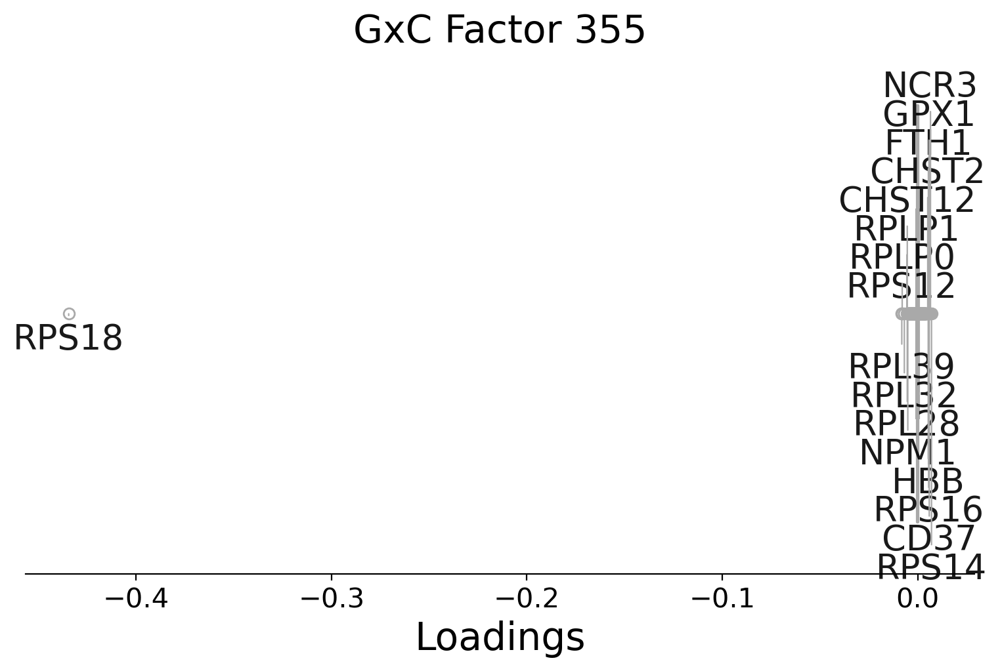

In [47]:
plot_gene_loadings_for_factor(
    GxC_decoder=GxC_decoder,
    factor="GxC_Factor355",
    adata_var=adata.var,
    gene_name_column="GeneSymbol",
    color="darkgrey",
    spines_invisible=True,
    n_top_genes=17,
    genes_to_annotate=None,
    annotation_fontsize=19,
    offset=0.055,
    x_distance=2e-2,
    savefig=None, #os.path.join(model_results_dir, "Figures", "Boxplots_gene-loadings_GxC355_grey.eps"),
)

## SNP 8:22966769 (rs12550612) on U232

In [48]:
snp_mapping.loc[snp_mapping.SNP_id_hg19 == "8:22966769"]

,SNP_id_hg38,SNP_id_hg19,rsID,a0,a1
4743,8:23109256,8:22966769,8:22966769,G,A


In [49]:
cis_eQTLGen_hvgs.loc[cis_eQTLGen_hvgs.snp_id == "8:22966769"] # associated with leukocyte count, myeloid white blood cell count, granulocyte count..; mapped gene TNFRSF10C

,Pvalue,SNP,SNPChr,SNPPos,AssessedAllele,OtherAllele,Zscore,Gene,GeneSymbol,GeneChr,GenePos,NrCohorts,NrSamples,FDR,BonferroniP,snp_id
722,3.271700e-310,rs12550612,8,22966769,G,A,48.9398,ENSG00000120889,TNFRSF10B,8,22902169,36,31470,0.0,4.166200e-302,8:22966769


/data/danai/scripts/LIVI/src/analysis/plotting.py:2487: UserWarning: Neither `cell_indices` nor `celltype` were provided.
Aggregating gene expression over all cells.


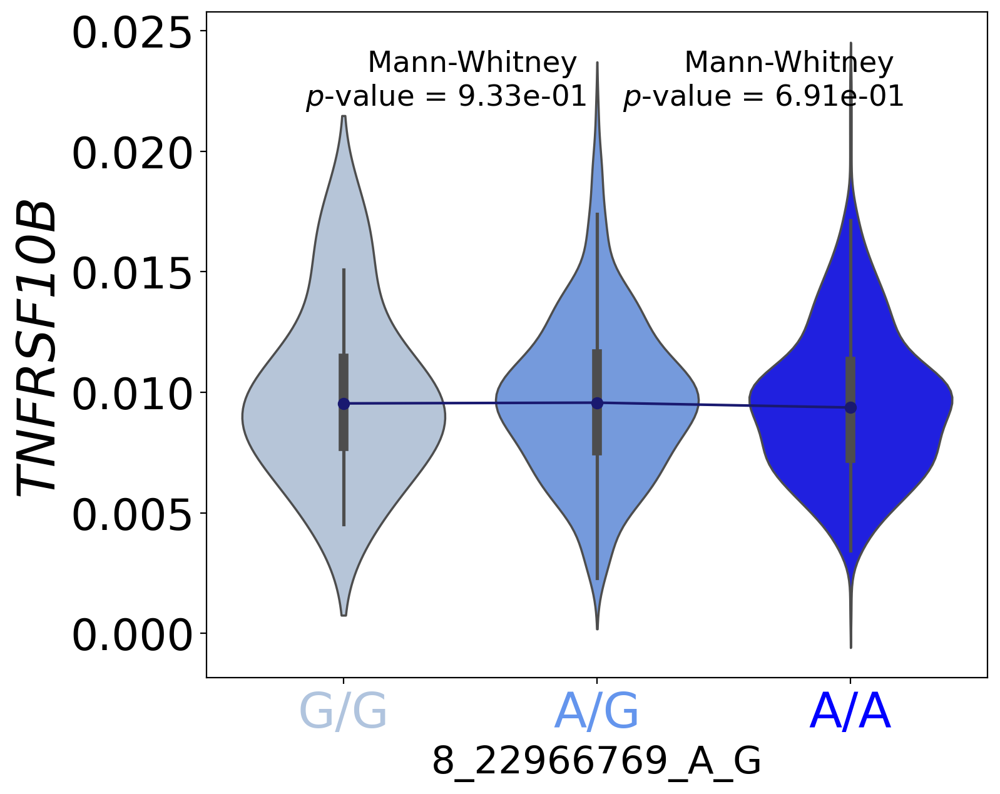

In [71]:
plot_ct_gex_vs_gt(
    adata=adata,
    gene="ENSG00000120889",
    filter_maf=False,
    annotation_fontsize=28,
    cell_indices=None,
    celltype=None,
    celltype_column="cell_label",
    iid_column="individual",
    GT_matrix=GT_matrix,
    SNP_id=SNP_dict_inv["8:22966769"],
    GxC_associations = GxC_effects,
    hgnc_column="GeneSymbol",
    savefig=True,
    output_dir=os.path.join(model_results_dir, "Figures"),
    output_prefix="All-cells",
    format="png",
)

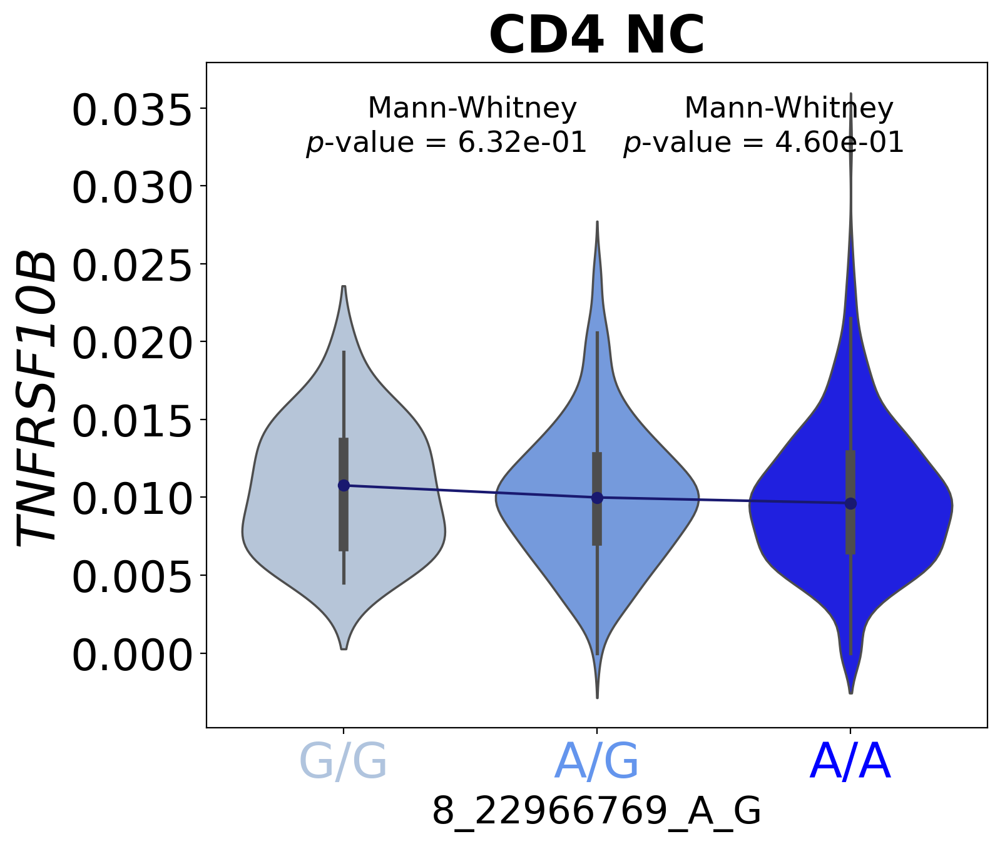

In [64]:
plot_ct_gex_vs_gt(
    adata=adata,
    gene="ENSG00000120889",
    filter_maf=False,
    annotation_fontsize=28,
    cell_indices=None,
    celltype=["CD4 NC"],
    celltype_column="cell_label",
    iid_column="individual",
    GT_matrix=GT_matrix,
    SNP_id=SNP_dict_inv["8:22966769"],
    GxC_associations = GxC_effects,
    hgnc_column="GeneSymbol",
    savefig=True,
    output_dir=os.path.join(model_results_dir, "Figures"),
    output_prefix=None,
    format="eps",
)

In [54]:
trans_eQTLGen_sign.loc[trans_eQTLGen_sign.snp_id == "8:22966769"]

,Pvalue,SNP,SNPChr,SNPPos,AssessedAllele,OtherAllele,Zscore,Gene,GeneSymbol,GeneChr,GenePos,NrCohorts,NrSamples,FDR,BonferroniP,SNP_id1,SNP_id2,snp_id,QTL


In [50]:
rsid = cis_eQTLGen_hvgs.loc[cis_eQTLGen_hvgs.snp_id == "8:22966769"].SNP.iloc[0]
rsid

'rs12550612'

In [51]:
tensorqtl_results.loc[tensorqtl_results.SNP_id == "8:22966769"] #.celltype.unique()

,SNP_id,gene,p_value,effect_size,effect_size_se,ref_allele,alt_allele,celltype,Storey_q,BH_corrected_pvalue


In [52]:
tensorqtl_all_8_22966769 = pd.read_csv("/data/danai/Data/OneK1K/Benchmarks/TensorQTL/tensorqtl_results_all_8_22966769.tsv", 
                                       sep="\t", names=["SNP_id", "Gene", "p_value", "ref_allele", "alt_allele", "celltype", "eQTL"])
tensorqtl_all_8_22966769.head()

,SNP_id,Gene,p_value,ref_allele,alt_allele,celltype,eQTL
0,8:22966769,ENSG00000166987,0.611406,A,G,CD4-ET,8_22966769_A_G__ENSG00000166987__CD4-ET
1,8:22966769,ENSG00000170624,0.082484,A,G,CD4-ET,8_22966769_A_G__ENSG00000170624__CD4-ET
2,8:22966769,ENSG00000117115,0.374887,A,G,CD4-ET,8_22966769_A_G__ENSG00000117115__CD4-ET
3,8:22966769,ENSG00000137078,0.036125,A,G,CD4-ET,8_22966769_A_G__ENSG00000137078__CD4-ET
4,8:22966769,ENSG00000082213,0.464676,A,G,CD4-ET,8_22966769_A_G__ENSG00000082213__CD4-ET


In [53]:
tensorqtl_all_8_22966769 = tensorqtl_all_8_22966769.set_index("Gene").merge(
    adata.var.GeneSymbol, right_index=True, left_index=True, how="left").reset_index()
tensorqtl_all_8_22966769 = tensorqtl_all_8_22966769.assign(mlog10_pval = -np.log10(tensorqtl_all_8_22966769.p_value))
tensorqtl_all_8_22966769.head()

,Gene,SNP_id,p_value,ref_allele,alt_allele,celltype,eQTL,GeneSymbol,mlog10_pval
0,ENSG00000166987,8:22966769,0.611406,A,G,CD4-ET,8_22966769_A_G__ENSG00000166987__CD4-ET,MBD6,0.213671
1,ENSG00000170624,8:22966769,0.082484,A,G,CD4-ET,8_22966769_A_G__ENSG00000170624__CD4-ET,SGCD,1.083633
2,ENSG00000117115,8:22966769,0.374887,A,G,CD4-ET,8_22966769_A_G__ENSG00000117115__CD4-ET,PADI2,0.426100
3,ENSG00000137078,8:22966769,0.036125,A,G,CD4-ET,8_22966769_A_G__ENSG00000137078__CD4-ET,SIT1,1.442198
4,ENSG00000082213,8:22966769,0.464676,A,G,CD4-ET,8_22966769_A_G__ENSG00000082213__CD4-ET,C5orf22,0.332850


In [353]:
GxC_effects.loc[GxC_effects.SNP == "8:22966769"]

,Factor,SNP_id,effect_size,effect_size_se,p_value,assessed_allele,corrected_pvalue,SNP
1117,U_Factor232,8_22966769_A_G,0.485567,0.107709,0.000006,A,0.012032,8:22966769


In [354]:
GxC_effects.loc[GxC_effects.Factor == "U_Factor232"]

,Factor,SNP_id,effect_size,effect_size_se,p_value,assessed_allele,corrected_pvalue,SNP
1117,U_Factor232,8_22966769_A_G,0.485567,0.107709,0.000006,A,0.012032,8:22966769


In [363]:
tmp = pd.merge(U["U_Factor232"], GT_matrix.loc[SNP_dict_inv["8:22966769"]].astype(int), right_index=True, left_index=True, how="left")
# tmp["8_22966769_A_G"] = tmp["8_22966769_A_G"].replace({0: "G/G", 1: "A/G", 2:"A/A"})
tmp

,U_Factor232,8_22966769_A_G
individual,,
691_692,0.346650,2
693_694,-3.003477,2
688_689,-0.741752,1
683_684,2.312345,1
684_685,-0.249947,1
...,...,...
840_841,-1.697949,2
801_802,-1.577916,0
797_798,2.392730,2


/tmp/ipykernel_33257/1980132838.py:3: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


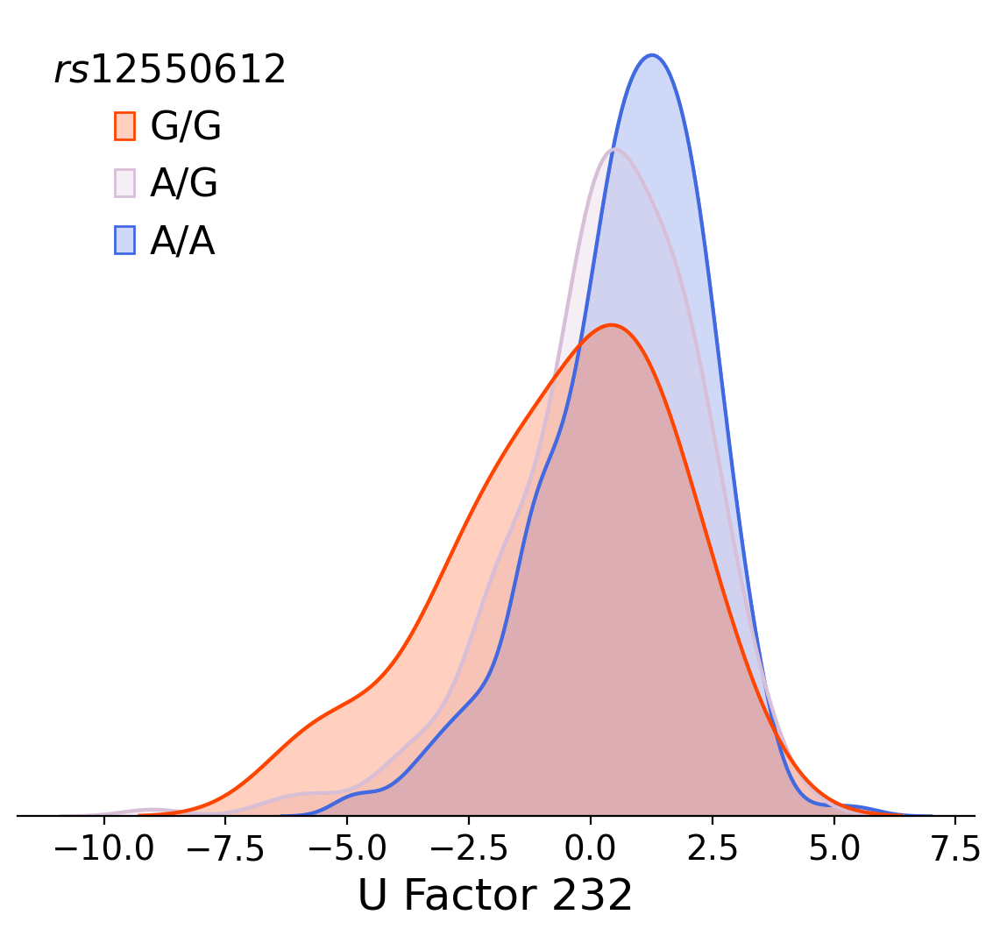

In [39]:
tmp = pd.merge(U["U_Factor232"], GT_matrix.loc[SNP_dict_inv["8:22966769"]].astype(int), right_index=True, left_index=True, how="left")
labels_dict = dict(zip([0, 1, 2], ["G/G", "A/G", "A/A"]))
tmp["8_22966769_A_G"].replace(labels_dict, inplace=True)
tmp.rename(columns={"8_22966769_A_G":f"${rsid}$"}, inplace=True)

legend_handles = []
legend_labels = []

p = sns.kdeplot(x="U_Factor232", hue=f"${rsid}$", fill=True, data=tmp, palette=["orangered", "thistle", "royalblue"], 
                hue_order=["G/G", "A/G", "A/A"], legend=True, common_norm=False)
p = sns.kdeplot(x="U_Factor232", hue=f"${rsid}$", fill=False, data=tmp, palette=["orangered", "thistle", "royalblue"], 
                hue_order=["G/G", "A/G", "A/A"], legend=False, common_norm=False)

p.set_xlabel("U Factor 232", fontsize=18)
p.tick_params(axis="x", labelsize=14) 
p.set_ylabel("")
p.set_yticks([])
p.spines["left"].set_visible(False)
p.spines["right"].set_visible(False)
p.spines["top"].set_visible(False)

leg = p.get_legend()
legend_labels = [t.get_text() for t in leg.get_texts()]
legend_handles = leg.legend_handles

p.legend(title=f"${rsid}$", handles=legend_handles, labels=legend_labels, frameon=False, title_fontsize=16, fontsize=16)

plt.savefig(os.path.join(model_results_dir, "Figures", "KDEplot_U232_colored-by_8-22966769_2_wo-y-axis.png"), 
            transparent=True, dpi=400, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", "KDEplot_U232_colored-by_8-22966769_2_wo-y-axis.eps"), 
            transparent=True, dpi=400, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", "KDEplot_U232_colored-by_8-22966769_2_wo-y-axis.pdf"), 
            transparent=True, dpi=400, bbox_inches="tight")

In [44]:
pd.merge(GxC_decoder["GxC_Factor232"].abs().nlargest(50), adata.var.loc[GxC_decoder["GxC_Factor232"].abs().nlargest(50).index].GeneSymbol, 
         right_index=True, left_index=True).set_index("GeneSymbol")

,GxC_Factor232
GeneSymbol,
SOCS3,0.336213
STAT3,0.183103
SOCS1,0.111517
UBALD2,0.111120
PIM1,0.106868
NFKBIZ,0.102210
BTG2,0.101538
MYC,0.098476
CDKN2D,0.096756


In [50]:
GxC_decoder["GxC_Factor232"].abs().sort_values(ascending=False).index.get_loc("ENSG00000101166") # TensorQTL gene

2817

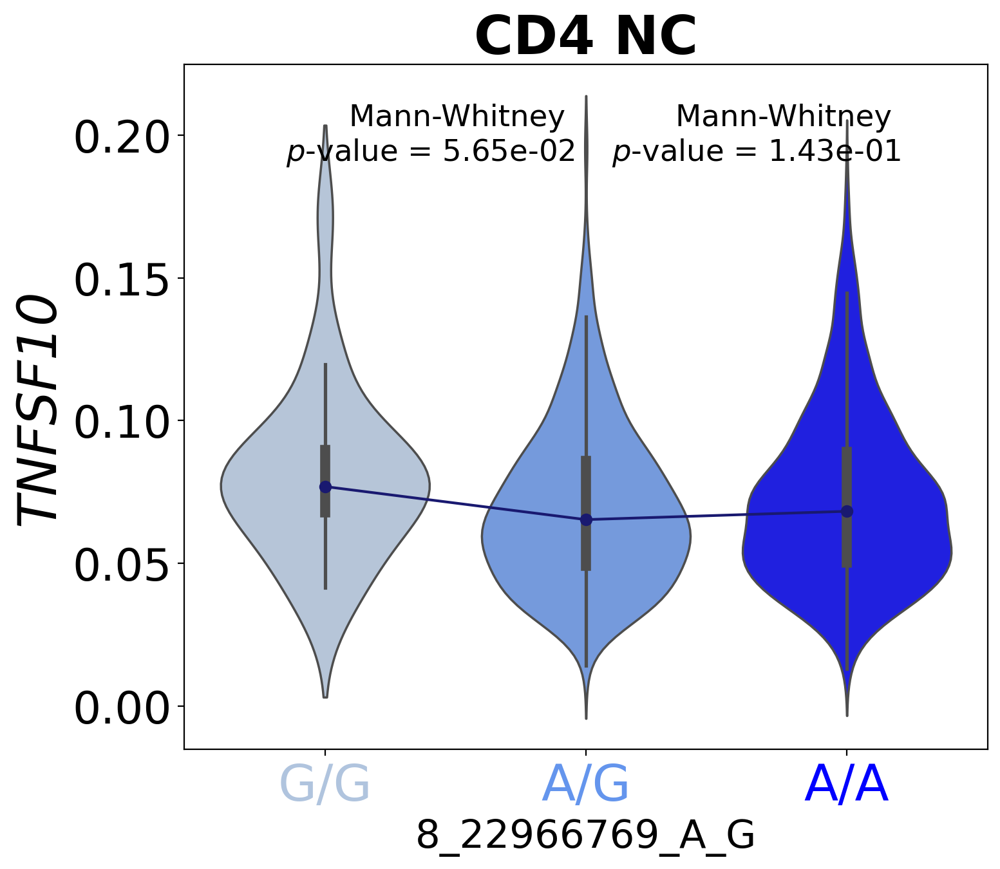

In [43]:
plot_ct_gex_vs_gt(
    adata=adata,
    gene="ENSG00000121858",
    annotation_fontsize=28,
    filter_maf=False,
    cell_indices=None,
    celltype=["CD4 NC"],
    celltype_column="cell_label",
    iid_column="individual",
    GT_matrix=GT_matrix,
    SNP_id=SNP_dict_inv["8:22966769"],
    GxC_associations = GxC_effects,
    hgnc_column="GeneSymbol",
    savefig=True,
    output_dir=os.path.join(model_results_dir, "Figures"),
    format="png",
)

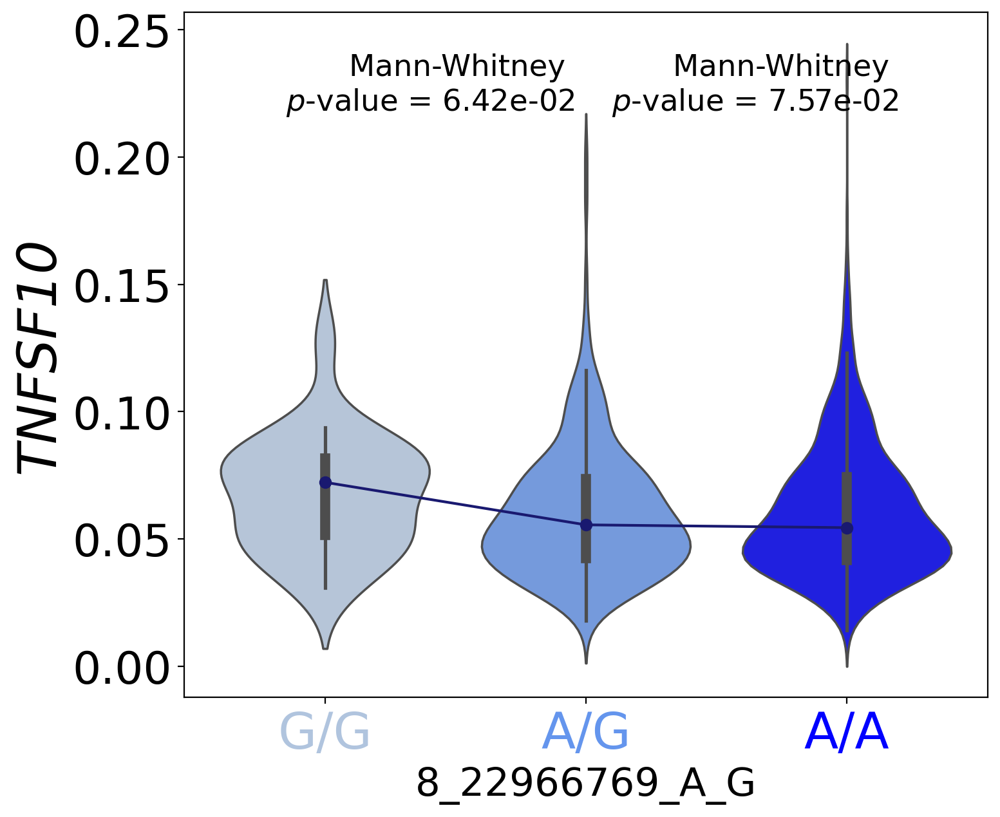

In [44]:
plot_ct_gex_vs_gt(
    adata=adata,
    gene="ENSG00000121858",
    annotation_fontsize=28,
    filter_maf=False,
    cell_indices=adata.obs.index,
    celltype=None,
    celltype_column="cell_label",
    iid_column="individual",
    GT_matrix=GT_matrix,
    SNP_id=SNP_dict_inv["8:22966769"],
    GxC_associations = GxC_effects,
    hgnc_column="GeneSymbol",
    savefig=True,
    output_dir=os.path.join(model_results_dir, "Figures"),
    output_prefix="All-cells",
    format="png",
)

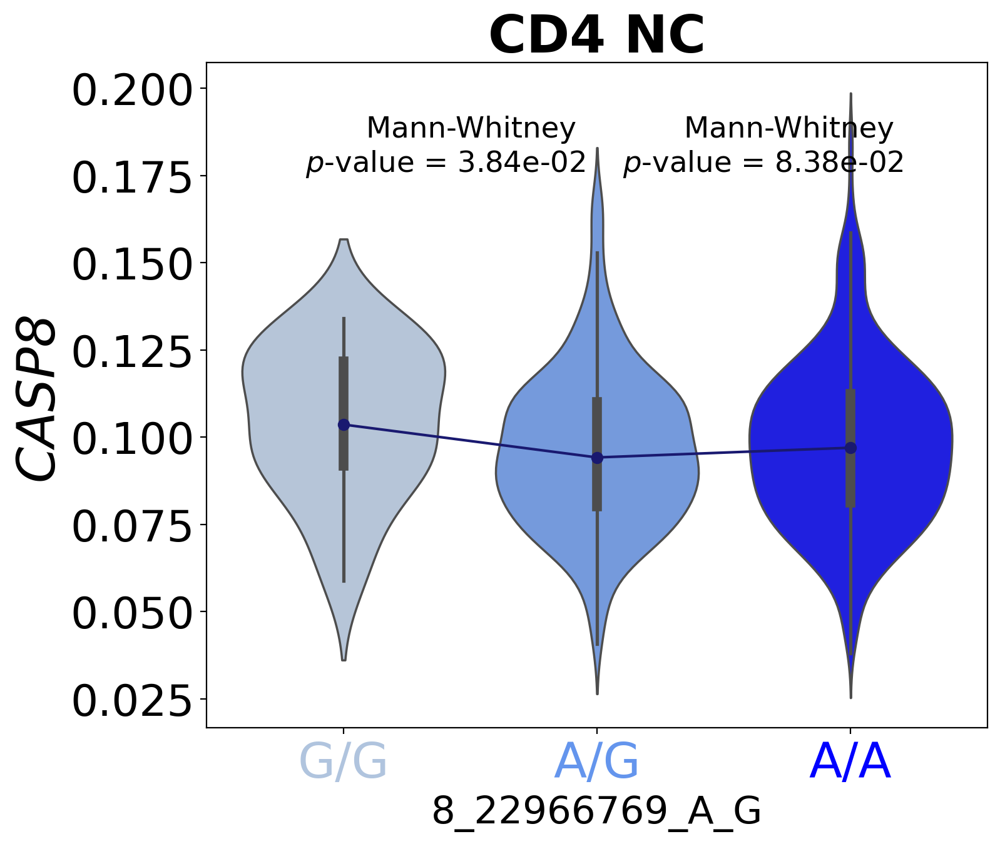

In [45]:
plot_ct_gex_vs_gt(
    adata=adata,
    gene="ENSG00000064012",
    annotation_fontsize=28,
    filter_maf=False,
    cell_indices=None,
    celltype=["CD4 NC"],
    celltype_column="cell_label",
    iid_column="individual",
    GT_matrix=GT_matrix,
    SNP_id=SNP_dict_inv["8:22966769"],
    GxC_associations = GxC_effects,
    hgnc_column="GeneSymbol",
    savefig=True,
    output_dir=os.path.join(model_results_dir, "Figures"),
    format="png",
)

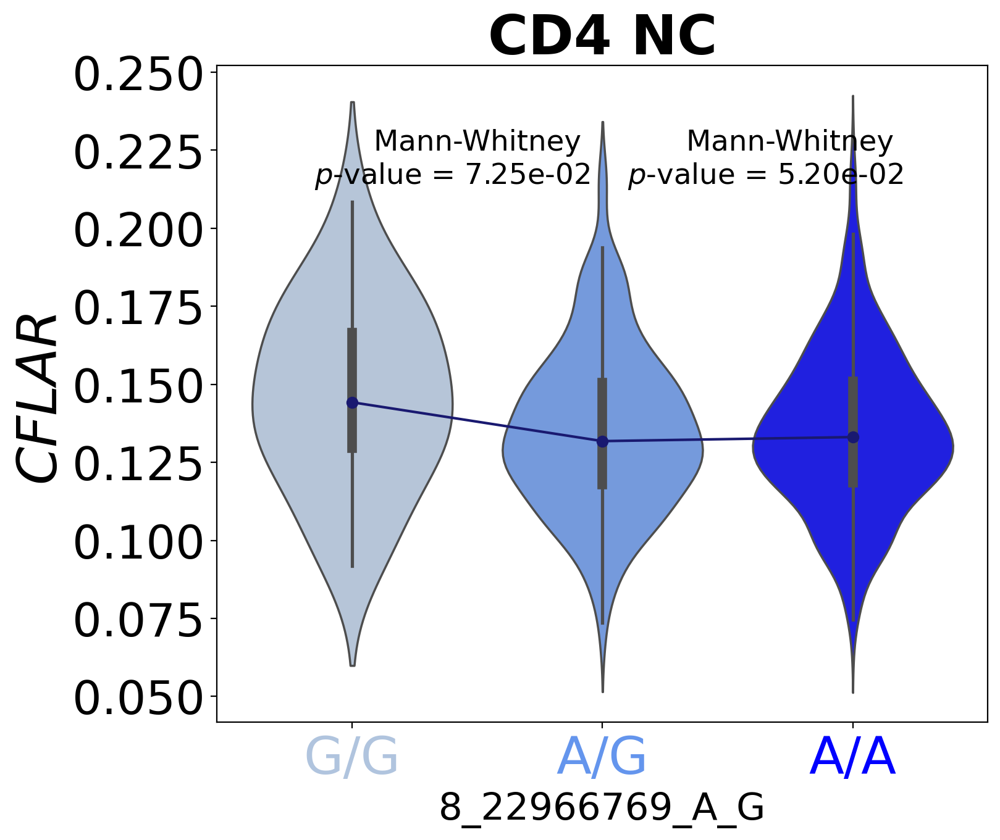

In [48]:
plot_ct_gex_vs_gt(
    adata=adata,
    annotation_fontsize=30,
    gene="ENSG00000003402",
    filter_maf=False,
    cell_indices=None,
    celltype=["CD4 NC"],
    celltype_column="cell_label",
    iid_column="individual",
    GT_matrix=GT_matrix,
    SNP_id=SNP_dict_inv["8:22966769"],
    GxC_associations = GxC_effects,
    hgnc_column="GeneSymbol",
    savefig=True,
    output_dir=os.path.join(model_results_dir, "Figures"),
    format="eps",
)

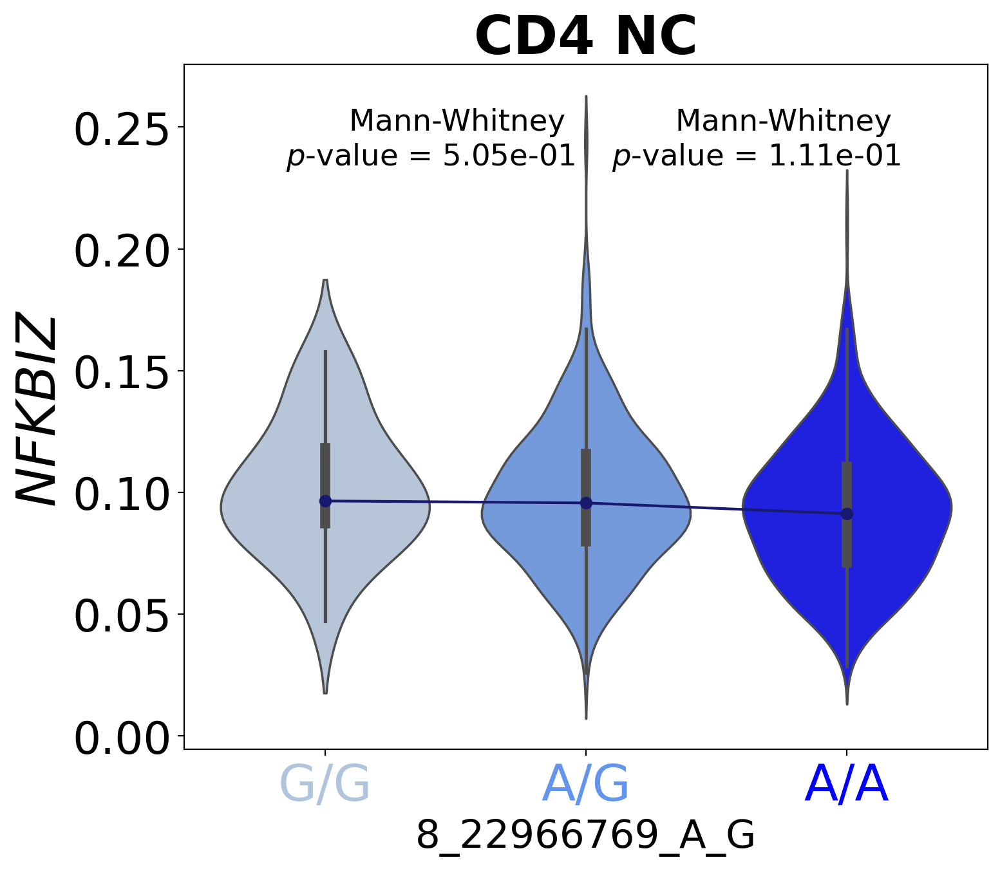

In [47]:
plot_ct_gex_vs_gt(
    adata=adata,
    gene="ENSG00000144802",
    annotation_fontsize=28,
    filter_maf=False,
    cell_indices=None,
    celltype=["CD4 NC"],
    celltype_column="cell_label",
    iid_column="individual",
    GT_matrix=GT_matrix,
    SNP_id=SNP_dict_inv["8:22966769"],
    GxC_associations = GxC_effects,
    hgnc_column="GeneSymbol",
    savefig=True,
    output_dir=os.path.join(model_results_dir, "Figures"),
    format="png",
)

### Comparison with TensorQTL

In [57]:
# tensorqtl_8_22966769_CD4 = tensorqtl_all_8_22966769.loc[
# (tensorqtl_all_8_22966769.celltype.str.startswith("CD4")) | (tensorqtl_all_8_22966769.celltype == "CD8-NC")
# ]
tensorqtl_8_22966769_naiveT = tensorqtl_all_8_22966769.loc[tensorqtl_all_8_22966769.celltype.isin(["CD4-NC", "CD4-SOX4", "CD8-NC"])]
tensorqtl_8_22966769_naiveT

,Gene,SNP_id,p_value,ref_allele,alt_allele,celltype,eQTL,GeneSymbol,mlog10_pval
25216,ENSG00000166987,8:22966769,0.847096,A,G,CD4-NC,8_22966769_A_G__ENSG00000166987__CD4-NC,MBD6,0.072067
25217,ENSG00000170624,8:22966769,0.800465,A,G,CD4-NC,8_22966769_A_G__ENSG00000170624__CD4-NC,SGCD,0.096658
25218,ENSG00000117115,8:22966769,0.806030,A,G,CD4-NC,8_22966769_A_G__ENSG00000117115__CD4-NC,PADI2,0.093649
25219,ENSG00000137078,8:22966769,0.616328,A,G,CD4-NC,8_22966769_A_G__ENSG00000137078__CD4-NC,SIT1,0.210188
25220,ENSG00000082213,8:22966769,0.162105,A,G,CD4-NC,8_22966769_A_G__ENSG00000082213__CD4-NC,C5orf22,0.790203
...,...,...,...,...,...,...,...,...,...
176507,ENSG00000185811,8:22966769,0.496641,A,G,CD4-SOX4,8_22966769_A_G__ENSG00000185811__CD4-SOX4,IKZF1,0.303958
176508,ENSG00000234465,8:22966769,0.258168,A,G,CD4-SOX4,8_22966769_A_G__ENSG00000234465__CD4-SOX4,PINLYP,0.588098
176509,ENSG00000170615,8:22966769,0.380902,A,G,CD4-SOX4,8_22966769_A_G__ENSG00000170615__CD4-SOX4,SLC26A5,0.419187
176510,ENSG00000151778,8:22966769,0.782925,A,G,CD4-SOX4,8_22966769_A_G__ENSG00000151778__CD4-SOX4,SERP2,0.106280


In [366]:
tensorqtl_8_22966769_naiveT.celltype.unique()

array(['CD4-NC', 'CD8-NC', 'CD4-SOX4'], dtype=object)

In [54]:
tensorqtl_8_22966769_CD4naive = tensorqtl_all_8_22966769.loc[tensorqtl_all_8_22966769.celltype.isin(["CD4-NC"])] #, "CD4-SOX4"])]
tensorqtl_8_22966769_CD4SOX = tensorqtl_all_8_22966769.loc[tensorqtl_all_8_22966769.celltype.isin(["CD4-SOX4"])]

tensorqtl_8_22966769_CD8naive = tensorqtl_all_8_22966769.loc[tensorqtl_all_8_22966769.celltype.isin(["CD8-NC"])]

In [58]:
tensorqtl_8_22966769_NOTnaive = tensorqtl_all_8_22966769.loc[~tensorqtl_all_8_22966769.index.isin(tensorqtl_8_22966769_naiveT.index)]
tensorqtl_8_22966769_NOTnaive.shape[0] + tensorqtl_8_22966769_naiveT.shape[0] == tensorqtl_all_8_22966769.shape[0]

True

In [59]:
tensorqtl_8_22966769_NOTCD4naive = tensorqtl_all_8_22966769.loc[~tensorqtl_all_8_22966769.celltype.isin(["CD4-NC", "CD4-SOX4"])]
tensorqtl_8_22966769_NOTCD4naive.head()

,Gene,SNP_id,p_value,ref_allele,alt_allele,celltype,eQTL,GeneSymbol,mlog10_pval
0,ENSG00000166987,8:22966769,0.611406,A,G,CD4-ET,8_22966769_A_G__ENSG00000166987__CD4-ET,MBD6,0.213671
1,ENSG00000170624,8:22966769,0.082484,A,G,CD4-ET,8_22966769_A_G__ENSG00000170624__CD4-ET,SGCD,1.083633
2,ENSG00000117115,8:22966769,0.374887,A,G,CD4-ET,8_22966769_A_G__ENSG00000117115__CD4-ET,PADI2,0.426100
3,ENSG00000137078,8:22966769,0.036125,A,G,CD4-ET,8_22966769_A_G__ENSG00000137078__CD4-ET,SIT1,1.442198
4,ENSG00000082213,8:22966769,0.464676,A,G,CD4-ET,8_22966769_A_G__ENSG00000082213__CD4-ET,C5orf22,0.332850


In [61]:
tensorqtl_8_22966769_CD4naive.loc[tensorqtl_8_22966769_CD4naive.GeneSymbol.isin(["SLMO2", "SOCS3", "MYC"])]

,Gene,SNP_id,p_value,ref_allele,alt_allele,celltype,eQTL,GeneSymbol,mlog10_pval
29754,ENSG00000101166,8:22966769,3.056044e-07,A,G,CD4-NC,8_22966769_A_G__ENSG00000101166__CD4-NC,SLMO2,6.514840
32720,ENSG00000136997,8:22966769,9.578349e-05,A,G,CD4-NC,8_22966769_A_G__ENSG00000136997__CD4-NC,MYC,4.018709
36632,ENSG00000184557,8:22966769,3.257134e-04,A,G,CD4-NC,8_22966769_A_G__ENSG00000184557__CD4-NC,SOCS3,3.487164


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


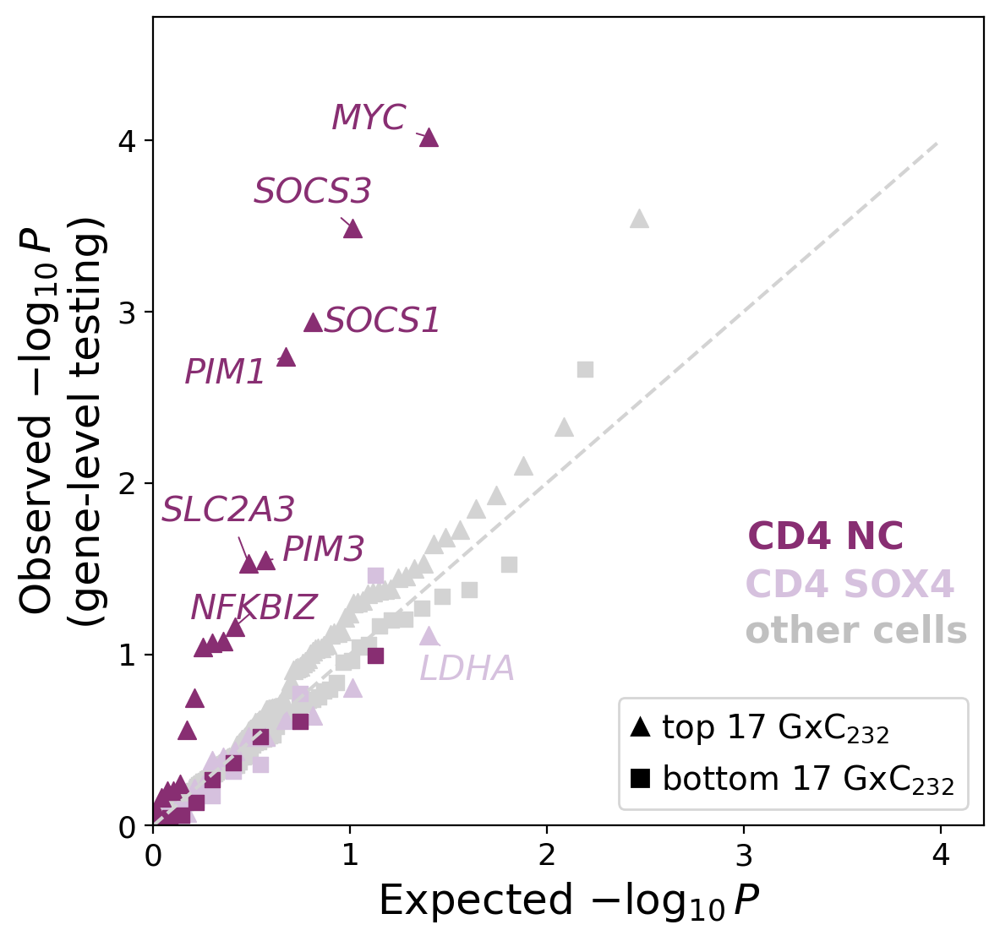

In [101]:
# Select the significant gene and LIVI's top genes
tmp = tensorqtl_8_22966769_CD4naive.loc[tensorqtl_8_22966769_CD4naive.Gene.isin(GxC_decoder["GxC_Factor232"].abs().nlargest(17).index)]

(osm, osr), _ = probplot(tmp.p_value, 
                         dist="uniform")

x_top30_CD4naive = -np.log10(osm)
y_top30_CD4naive = -np.log10(osr)

# Get also indices for top LIVI genes to annotate
tmp_anno = tmp.loc[(tmp.Gene.isin(GxC_decoder["GxC_Factor232"].abs().nlargest(17).index)) & (tmp.mlog10_pval >= 1.1)]
# For each gene get the min p-value across T naive celltypes
gene_min_pval = tmp_anno.groupby("GeneSymbol", observed=True).apply(lambda x: x.p_value.min(), include_groups=False).rename("p_value").to_frame()
idx = []
geneS = []
for _, row in gene_min_pval.reset_index().iterrows():  
    idx.extend(
        tensorqtl_8_22966769_CD4naive.loc[(tensorqtl_8_22966769_CD4naive.GeneSymbol == row["GeneSymbol"]) & (tensorqtl_8_22966769_CD4naive.p_value == row["p_value"])].index.tolist()
    )
    geneS.append(row["GeneSymbol"])
top10idx_CD4naive = dict(zip(geneS, idx))
# Get p-value sorted indices of the original indices
for k,v in top10idx_CD4naive.items():
    top10idx_CD4naive[k] = tmp.p_value.sort_values(ascending=True).index.get_loc(v)

# Bottom 30 genes
(osm, osr), _ = probplot(tensorqtl_8_22966769_CD4naive.loc[tensorqtl_8_22966769_CD4naive.Gene.isin(GxC_decoder["GxC_Factor232"].abs().nsmallest(17).index)].p_value, 
                         dist="uniform")
x_bottom30_CD4naive = -np.log10(osm)
y_bottom30_CD4naive = -np.log10(osr)

# CD4 SOX4
tmp = tensorqtl_8_22966769_CD4SOX.loc[tensorqtl_8_22966769_CD4SOX.Gene.isin(GxC_decoder["GxC_Factor232"].abs().nlargest(17).index)]
(osm, osr), _ = probplot(tmp.p_value, dist="uniform")
x_top30_CD4SOX = -np.log10(osm)
y_top30_CD4SOX = -np.log10(osr)
# Get indices of top LIVI genes to annotate
tmp_anno = tmp.loc[tmp.mlog10_pval >= 1.1].GeneSymbol.to_dict() # index, gene name
# Get p-value sorted indices of the original indices
top10idx_CD4SOX = {}
for k,v in tmp_anno.items():
    top10idx_CD4SOX[v] = tmp.p_value.sort_values(ascending=True).index.get_loc(k)
    

(osm, osr), _ = probplot(tensorqtl_8_22966769_CD4SOX.loc[tensorqtl_8_22966769_CD4SOX.Gene.isin(GxC_decoder["GxC_Factor232"].abs().nsmallest(17).index)].p_value,
                                 dist="uniform")
x_bottom30_CD4SOX = -np.log10(osm)
y_bottom30_CD4SOX = -np.log10(osr)


# Other cells
(osm, osr), _ = probplot(tensorqtl_8_22966769_NOTCD4naive.loc[tensorqtl_8_22966769_NOTCD4naive.Gene.isin(GxC_decoder["GxC_Factor232"].abs().nlargest(17).index)].p_value,
                                 dist="uniform")
x_top30_NOTnaive = -np.log10(osm)
y_top30_NOTnaive = -np.log10(osr)

(osm, osr), _ = probplot(tensorqtl_8_22966769_NOTCD4naive.loc[tensorqtl_8_22966769_NOTCD4naive.Gene.isin(GxC_decoder["GxC_Factor232"].abs().nsmallest(17).index)].p_value,
                                 dist="uniform")
x_bottom30_NOTnaive = -np.log10(osm)
y_bottom30_NOTnaive = -np.log10(osr)


# # Determine a common x-axis end (max x across all methods)
# common_x_end = max(x_top30_CD4naive.max(), x_bottom30_CD4naive.max(), x_top30_CD4SOX.max(), x_bottom30_CD4SOX.max(), x_top30_NOTnaive.max(), x_bottom30_NOTnaive.max())

plt.figure(figsize=(6.3,6.3))
axs = plt.gca()

sns.scatterplot(x=x_top30_NOTnaive, y=y_top30_NOTnaive, ax=axs, edgecolor=None, color="lightgrey", s=60, marker="^",
                label="other cells")
sns.scatterplot(x=x_bottom30_NOTnaive, y=y_bottom30_NOTnaive, ax=axs, edgecolor=None, color="lightgrey", s=40, marker="s") #, label="top50 - other cells")

sns.scatterplot(x=x_top30_CD4SOX, y=y_top30_CD4SOX, ax=axs, edgecolor=None, color=cell_label_colors["CD4 SOX4"],
                s=60, marker="^", label="CD4 T naive") 
sns.scatterplot(x=x_bottom30_CD4SOX, y=y_bottom30_CD4SOX, ax=axs, edgecolor=None, color=cell_label_colors["CD4 SOX4"], s=40, marker="s") # label="top100 - CD4T and CD8T naive")


sns.scatterplot(x=x_top30_CD4naive, y=y_top30_CD4naive, ax=axs, edgecolor=None, color=cell_label_colors["CD4 NC"],
                s=60, marker="^", label="CD4 T naive") 
sns.scatterplot(x=x_bottom30_CD4naive, y=y_bottom30_CD4naive, ax=axs, edgecolor=None, color=cell_label_colors["CD4 NC"], s=40, marker="s") # label="top100 - CD4T and CD8T naive")


# Add gene annotations
annotation_fontsize=15

for k,v in top10idx_CD4naive.items():
    # axs.text(x=x_top30_CD4naive[v], y=y_top30_CD4naive[v], s=k,
    #          fontdict={"fontstyle":"italic", "color":cell_label_colors["CD4 NC"]})
    if k == "SLC2A3":
        axs.annotate(
                text=k,
                xy=(x_top30_CD4naive[v], y_top30_CD4naive[v]),
                xytext=(x_top30_CD4naive[v]-0.1, y_top30_CD4naive[v]+0.3),
                arrowprops=dict(
                    arrowstyle="-",
                    connectionstyle="arc3",
                    color=cell_label_colors["CD4 NC"],
                    linewidth=0.7,
                ),
                ha="center",
                va="center",
                fontstyle="italic",
                fontsize=annotation_fontsize,
                color=cell_label_colors["CD4 NC"]
            )
    elif k == "PIM3":
        axs.annotate(
            text=k,
            xy=(x_top30_CD4naive[v], y_top30_CD4naive[v]),
            xytext=(x_top30_CD4naive[v]+0.3, y_top30_CD4naive[v]+0.05),
            arrowprops=dict(
                arrowstyle="-",
                connectionstyle="arc3",
                color=cell_label_colors["CD4 NC"],
                linewidth=0.7,
            ),
            ha="center",
            va="center",
            fontstyle="italic",
            fontsize=annotation_fontsize,
            color=cell_label_colors["CD4 NC"]
        )
    elif k == "PIM1":
        axs.annotate(
            text=k,
            xy=(x_top30_CD4naive[v], y_top30_CD4naive[v]),
            xytext=(x_top30_CD4naive[v]-0.3, y_top30_CD4naive[v]-0.1),
            arrowprops=dict(
                arrowstyle="-",
                connectionstyle="arc3",
                color=cell_label_colors["CD4 NC"],
                linewidth=0.7,
            ),
            ha="center",
            va="center",
            fontstyle="italic",
            fontsize=annotation_fontsize,
            color=cell_label_colors["CD4 NC"]
        )
    elif k == "SOCS3":
        axs.annotate(
            text=k,
            xy=(x_top30_CD4naive[v], y_top30_CD4naive[v]),
            xytext=(x_top30_CD4naive[v]-0.2, y_top30_CD4naive[v]+0.2),
            arrowprops=dict(
                arrowstyle="-",
                connectionstyle="arc3",
                color=cell_label_colors["CD4 NC"],
                linewidth=0.7,
            ),
            ha="center",
            va="center",
            fontstyle="italic",
            fontsize=annotation_fontsize,
            color=cell_label_colors["CD4 NC"]
        )
    elif k == "SOCS1":
         axs.text(x=x_top30_CD4naive[v]+0.055, y=y_top30_CD4naive[v]-0.06, s=k, 
              fontdict={"fontstyle":"italic", "color":cell_label_colors["CD4 NC"], "fontsize":annotation_fontsize})
    elif k == "NFKBIZ":
        axs.annotate(
            text=k,
            xy=(x_top30_CD4naive[v], y_top30_CD4naive[v]),
            xytext=(x_top30_CD4naive[v]+0.1, y_top30_CD4naive[v]+0.1),
            arrowprops=dict(
                arrowstyle="-",
                connectionstyle="arc3",
                color=cell_label_colors["CD4 NC"],
                linewidth=0.7,
            ),
            ha="center",
            va="center",
            fontstyle="italic",
            fontsize=annotation_fontsize,
            color=cell_label_colors["CD4 NC"]
        )
    elif k == "LDHA":
        axs.annotate(
            text=k,
            xy=(x_top30_CD4naive[v], y_top30_CD4naive[v]),
            xytext=(x_top30_CD4naive[v]+0.2, y_top30_CD4naive[v]-1),
            arrowprops=dict(
                arrowstyle="-",
                connectionstyle="arc3",
                color=cell_label_colors["CD4 NC"],
                linewidth=0.7,
            ),
            ha="center",
            va="center",
            fontstyle="italic",
            fontsize=annotation_fontsize,
            color=cell_label_colors["CD4 NC"]
        )
    else:
        axs.annotate(
            text=k,
            xy=(x_top30_CD4naive[v], y_top30_CD4naive[v]),
            xytext=(x_top30_CD4naive[v]-0.3, y_top30_CD4naive[v]+0.1),
            arrowprops=dict(
                arrowstyle="-",
                connectionstyle="arc3",
                color=cell_label_colors["CD4 NC"],
                linewidth=0.7,
            ),
            ha="center",
            va="center",
            fontstyle="italic",
            fontsize=annotation_fontsize,
            color=cell_label_colors["CD4 NC"]
        )

        
for k,v in top10idx_CD4SOX.items():
    if k == "LDHA":
        axs.annotate(
            text=k,
            xy=(x_top30_CD4SOX[v], y_top30_CD4SOX[v]),
            xytext=(x_top30_CD4SOX[v]+0.2, y_top30_CD4SOX[v]-0.2),
            arrowprops=dict(
                arrowstyle="-",
                connectionstyle="arc3",
                color=cell_label_colors["CD4 SOX4"],
                linewidth=0.7,
            ),
            ha="center",
            va="center",
            fontstyle="italic",
            fontsize=annotation_fontsize,
            color=cell_label_colors["CD4 SOX4"]
        )
    else:
        axs.text(x=x_top30_CD4SOX[v], y=y_top30_CD4SOX[v], s=k,
                 fontdict={"fontstyle":"italic", "color":cell_label_colors["CD4 SOX4"], "fontsize":annotation_fontsize})


axs.set(xlabel=r"Expected $-\log_{10} P$", ylabel=r"Observed $-\log_{10} P$"+"\n(gene-level testing)")
axs.xaxis.label.set_size(18)
axs.yaxis.label.set_size(18)

legend1 = axs.legend(handles=[], title="CD4 NC", title_fontsize=16, loc="lower right", frameon=False, # title=CD$4^{+}$ T naive
                     bbox_to_anchor=(0.937, 0.28), alignment="left")
legend1.get_title().set_color(cell_label_colors["CD4 NC"])
legend1.get_title().set_fontweight("bold")
axs.add_artist(legend1)


legend3 = axs.legend(handles=[], title="CD4 SOX4", title_fontsize=16, loc="lower right", frameon=False,
                     bbox_to_anchor=(0.999, 0.22), alignment="left")
legend3.get_title().set_color(cell_label_colors["CD4 SOX4"])
legend3.get_title().set_fontweight("bold")
axs.add_artist(legend3)

legend4 = axs.legend(handles=[], title="other cells", title_fontsize=16, loc="lower right", frameon=False, 
                     bbox_to_anchor=(1.014, 0.165), alignment="left")
legend4.get_title().set_color("silver")
legend4.get_title().set_fontweight("bold")
axs.add_artist(legend4)

legend_handles = [
    Line2D([], [], color="black", marker="^", linestyle="None", markersize=7, label="top 17 GxC$_{232}$"),
    Line2D([], [], color="black", marker="s", linestyle="None", markersize=7, label="bottom 17 GxC$_{232}$")
]
legend5 = axs.legend(handles=legend_handles, title="", title_fontsize=14, fontsize=14, loc="lower right", frameon=True, 
                     alignment="left")

axes_lim = max([axs.get_xlim()[-1], axs.get_ylim()[-1]])
# Diagonal reference line
axs.plot(np.arange(axes_lim), np.arange(axes_lim), linestyle="--", color="lightgrey")

axs.set_xlim(0,axes_lim)
axs.set_ylim(0,axes_lim+0.5) # add some extra space for the gene annotations
axs.set_xticks(np.arange(0, axs.get_xticks().max(),1, dtype=int), np.arange(0, axs.get_xticks().max(),1, dtype=int), fontsize=13)
axs.set_yticks(np.arange(0, axs.get_yticks().max(),1, dtype=int), np.arange(0, axs.get_yticks().max(),1, dtype=int), fontsize=13)
# axs.tick_params(axis="both", labelsize=13)

# axs.hlines(y=1, xmin=0, xmax=1, linestyle=":")
# axs.hlines(y=2, xmin=0, xmax=2, linestyle=":")
# axs.hlines(y=3, xmin=0, xmax=3, linestyle=":")
# axs.hlines(y=4, xmin=0, xmax=4, linestyle=":")

# axs.vlines(x=1, ymin=0, ymax=1, linestyle=":")
# axs.vlines(x=2, ymin=0, ymax=2, linestyle=":")
# axs.vlines(x=3, ymin=0, ymax=3, linestyle=":")
# axs.vlines(x=4, ymin=0, ymax=4, linestyle=":")


plt.savefig(os.path.join(model_results_dir, "Figures", "QQplot_8_22966769_tensorQTL_GxC232_ONLY-TopGenes-and-bottom-genes_CD4-naive_other-cells.png"), 
            transparent=True, bbox_inches="tight", dpi=400)
plt.savefig(os.path.join(model_results_dir, "Figures", "QQplot_8_22966769_tensorQTL_GxC232_ONLY-TopGenes-and-bottom-genes_CD4-naive_other-cells.eps"), 
            transparent=True, bbox_inches="tight", dpi=400)
plt.savefig(os.path.join(model_results_dir, "Figures", "QQplot_8_22966769_tensorQTL_GxC232_ONLY-TopGenes-and-bottom-genes_CD4-naive_other-cells.pdf"), 
            transparent=True, bbox_inches="tight", dpi=400)

#### Gene-level testing on LIVI identified cell subset

In [102]:
results_livi_cells_017 = pd.read_csv("/data/danai/Data/OneK1K/Benchmarks/TensorQTL/LIVI_cells_8-22966769_GxC232_017-cutoff_15PCs_10GT-PCs_trans-mapping_all-chroms_only-8-22966769.tsv", 
                                 sep="\t")

results_livi_cells_017 = results_livi_cells_017.assign(mlog10_pval = -np.log10(results_livi_cells_017.p_value))
results_livi_cells_017 = results_livi_cells_017.set_index("gene").merge(
    adata.var.GeneSymbol, right_index=True, left_index=True, how="left").reset_index(names="Gene")
results_livi_cells_017.head()

,Gene,SNP_id,p_value,effect_size,effect_size_se,ref_allele,alt_allele,mlog10_pval,GeneSymbol
0,ENSG00000257019,8:22966769,0.445562,-1.585165e-02,2.077129e-02,A,G,0.351092,OR13C2
1,ENSG00000166987,8:22966769,0.638469,5.387042e-02,1.146203e-01,A,G,0.194860,MBD6
2,ENSG00000170624,8:22966769,0.075648,-1.167702e-01,6.565820e-02,A,G,1.121203,SGCD
3,ENSG00000140519,8:22966769,0.727044,9.503140e-15,2.721689e-14,A,G,0.138439,RHCG
4,ENSG00000117115,8:22966769,0.327957,-6.656258e-02,6.800840e-02,A,G,0.484184,PADI2


In [104]:
results_livi_cells_017_sign = pd.read_csv("/data/danai/Data/OneK1K/Benchmarks/TensorQTL/LIVI_cells_8-22966769_GxC232_017-cutoff_10K-HVG-HEX-genes_15PCs_10GT-PCs_trans-mapping_all-chroms_tensorQTL_significant_BH_005.tsv",
                                         sep="\t")
results_livi_cells_017_sign = results_livi_cells_017_sign.loc[results_livi_cells_017_sign.SNP_id == "8:22966769"]
results_livi_cells_017_sign

,SNP_id,gene,p_value,effect_size,effect_size_se,ref_allele,alt_allele,celltype,Storey_q,BH_corrected_pvalue
2274,8:22966769,ENSG00000184557,7.811555e-07,0.218035,0.043843,A,G,GxC232_017,0.029577,0.030167


In [105]:
adata.var.loc["ENSG00000184557"].filter(like="ene")

GeneSymbol            SOCS3
gene_chromosome          17
gene_start         76352864
gene_end           76356158
Name: ENSG00000184557, dtype: object

In [106]:
results_livi_cells_017.loc[results_livi_cells_017.Gene.isin(results_livi_cells_017_sign.gene)].GeneSymbol

12817    SOCS3
Name: GeneSymbol, dtype: object

In [107]:
tmp_livi = results_livi_cells_017.loc[
results_livi_cells_017.Gene.isin(
    GxC_decoder["GxC_Factor232"].abs().nlargest(30).index.tolist() + tensorqtl_results.loc[tensorqtl_results.SNP_id == "8:22966769"].gene.tolist()
)]
tmp_livi

,Gene,SNP_id,p_value,effect_size,effect_size_se,ref_allele,alt_allele,mlog10_pval,GeneSymbol
325,ENSG00000062716,8:22966769,7.343525e-01,0.017969,0.052938,A,G,0.134095,VMP1
442,ENSG00000059804,8:22966769,2.906964e-02,0.104757,0.047925,A,G,1.536560,SLC2A3
644,ENSG00000128016,8:22966769,4.039306e-02,0.076790,0.037413,A,G,1.393693,ZFP36
762,ENSG00000150347,8:22966769,6.438746e-01,0.023094,0.049940,A,G,0.191199,ARID5B
970,ENSG00000185338,8:22966769,2.939977e-03,0.216365,0.072566,A,G,2.531656,SOCS1
999,ENSG00000137193,8:22966769,3.274856e-03,0.143131,0.048550,A,G,2.484808,PIM1
1063,ENSG00000129355,8:22966769,7.925842e-02,0.096909,0.055159,A,G,1.100955,CDKN2D
2280,ENSG00000157514,8:22966769,7.286803e-02,-0.051419,0.028636,A,G,1.137463,TSC22D3
2840,ENSG00000102096,8:22966769,1.043176e-01,0.087527,0.053835,A,G,0.981642,PIM2
2892,ENSG00000118503,8:22966769,1.180947e-01,-0.049418,0.031593,A,G,0.927770,TNFAIP3


In [109]:
tmp_tensor = tensorqtl_8_22966769_CD4naive.loc[
tensorqtl_8_22966769_CD4naive.Gene.isin(
    GxC_decoder["GxC_Factor232"].abs().nlargest(17).index.tolist()
)]
# For each gene get the min p-value across T naive celltypes
gene_min_pval = tmp_tensor.groupby("GeneSymbol", observed=True).apply(lambda x: x.p_value.min(), include_groups=False).rename("p_value").to_frame()
idx = []
for _, row in gene_min_pval.reset_index().iterrows():  
    idx.extend(
        tmp_tensor.loc[(tmp_tensor.GeneSymbol == row["GeneSymbol"]) & (tmp_tensor.p_value == row["p_value"])].index.tolist()
    )
tmp_tensor = tmp_tensor.loc[idx]
tmp_tensor

,Gene,SNP_id,p_value,ref_allele,alt_allele,celltype,eQTL,GeneSymbol,mlog10_pval
35857,ENSG00000159388,8:22966769,0.824890,A,G,CD4-NC,8_22966769_A_G__ENSG00000159388__CD4-NC,BTG2,0.083604
26157,ENSG00000129355,8:22966769,0.084005,A,G,CD4-NC,8_22966769_A_G__ENSG00000129355__CD4-NC,CDKN2D,1.075692
31060,ENSG00000168209,8:22966769,0.085481,A,G,CD4-NC,8_22966769_A_G__ENSG00000168209__CD4-NC,DDIT4,1.068130
31800,ENSG00000134333,8:22966769,0.274575,A,G,CD4-NC,8_22966769_A_G__ENSG00000134333__CD4-NC,LDHA,0.561339
32720,ENSG00000136997,8:22966769,0.000096,A,G,CD4-NC,8_22966769_A_G__ENSG00000136997__CD4-NC,MYC,4.018709
33336,ENSG00000144802,8:22966769,0.069196,A,G,CD4-NC,8_22966769_A_G__ENSG00000144802__CD4-NC,NFKBIZ,1.159919
26101,ENSG00000137193,8:22966769,0.001837,A,G,CD4-NC,8_22966769_A_G__ENSG00000137193__CD4-NC,PIM1,2.735788
27741,ENSG00000102096,8:22966769,0.623289,A,G,CD4-NC,8_22966769_A_G__ENSG00000102096__CD4-NC,PIM2,0.205311
35523,ENSG00000198355,8:22966769,0.028334,A,G,CD4-NC,8_22966769_A_G__ENSG00000198355__CD4-NC,PIM3,1.547685
28435,ENSG00000057657,8:22966769,0.178991,A,G,CD4-NC,8_22966769_A_G__ENSG00000057657__CD4-NC,PRDM1,0.747168


#### Scatterplot of assocation p-values LIVI cells vs. all CD4 naive

In [110]:
tmp_livi = results_livi_cells_017.set_index("Gene", inplace=False)
tmp_CD4 = tensorqtl_8_22966769_CD4naive.set_index("Gene", inplace=False)
tmp_livi = tmp_livi.merge(tmp_CD4[["mlog10_pval", "p_value"]], right_index=True, left_index=True, how="inner", suffixes=("_LIVI", "_CD4"))
tmp_livi.head()

,SNP_id,p_value_LIVI,effect_size,effect_size_se,ref_allele,alt_allele,mlog10_pval_LIVI,GeneSymbol,mlog10_pval_CD4,p_value_CD4
Gene,,,,,,,,,,
ENSG00000166987,8:22966769,0.638469,0.053870,0.114620,A,G,0.194860,MBD6,0.072067,0.847096
ENSG00000170624,8:22966769,0.075648,-0.116770,0.065658,A,G,1.121203,SGCD,0.096658,0.800465
ENSG00000117115,8:22966769,0.327957,-0.066563,0.068008,A,G,0.484184,PADI2,0.093649,0.806030
ENSG00000137078,8:22966769,0.654987,0.024626,0.055094,A,G,0.183768,SIT1,0.210188,0.616328
ENSG00000082213,8:22966769,0.352996,-0.159215,0.171338,A,G,0.452230,C5orf22,0.790203,0.162105


In [111]:
cd4_sign = tensorqtl_results.loc[tensorqtl_results.celltype == "CD4-NC"]
cd4_sign

,SNP_id,gene,p_value,effect_size,effect_size_se,ref_allele,alt_allele,celltype,Storey_q,BH_corrected_pvalue
1070,1:121280613,ENSG00000231360,3.709787e-15,0.216665,0.027097,A,G,CD4-NC,1.042902e-08,1.044294e-08
1071,1:158638260,ENSG00000141977,1.191575e-11,0.073542,0.010712,G,A,CD4-NC,2.929004e-05,2.932914e-05
1072,1:167903079,ENSG00000140905,3.865923e-32,-0.357043,0.029149,G,T,CD4-NC,2.402390e-25,2.405597e-25
1073,1:205725346,ENSG00000156885,1.215548e-11,0.145832,0.021250,T,C,CD4-NC,2.929004e-05,2.932914e-05
1074,2:56089540,ENSG00000153339,1.191963e-08,-0.183703,0.031941,G,A,CD4-NC,1.513295e-02,1.515315e-02
...,...,...,...,...,...,...,...,...,...,...
1177,18:12881361,ENSG00000163888,5.890637e-10,0.202466,0.032354,A,G,CD4-NC,1.140188e-03,1.141709e-03
1178,19:6802571,ENSG00000103647,1.152064e-10,0.215859,0.033117,C,T,CD4-NC,2.473191e-04,2.476492e-04
1179,19:10334725,ENSG00000118523,9.927183e-10,0.123649,0.020032,A,G,CD4-NC,1.803253e-03,1.805659e-03
1180,19:41305138,ENSG00000166664,2.318225e-11,0.165514,0.024465,G,T,CD4-NC,5.366971e-05,5.374134e-05


In [112]:
cd4_sign.BH_corrected_pvalue.max()

0.0480963365800431

In [113]:
pval_cutoff_cd4 = cd4_sign.loc[cd4_sign.BH_corrected_pvalue == cd4_sign.BH_corrected_pvalue.max()].p_value
pval_cutoff_cd4

1087    4.556243e-08
Name: p_value, dtype: float64

In [114]:
pval_cutoff_cd4 = pval_cutoff_cd4.iloc[0]
pval_cutoff_cd4

4.556243003681993e-08

In [115]:
livi_sign_all = pd.read_csv("/data/danai/Data/OneK1K/Benchmarks/TensorQTL/LIVI_cells_8-22966769_GxC232_017-cutoff_10K-HVG-HEX-genes_15PCs_10GT-PCs_trans-mapping_all-chroms_tensorQTL_significant_BH_005.tsv", 
                            sep="\t")
livi_sign_all

,SNP_id,gene,p_value,effect_size,effect_size_se,ref_allele,alt_allele,celltype,Storey_q,BH_corrected_pvalue
0,1:2146165,ENSG00000182070,1.331507e-06,0.139746,0.028718,C,A,GxC232_017,0.042776,0.043629
1,1:2146165,ENSG00000168065,2.401626e-07,0.145160,0.027900,C,A,GxC232_017,0.012323,0.012569
2,1:2146165,ENSG00000152086,2.195109e-07,0.149365,0.028613,C,A,GxC232_017,0.011476,0.011705
3,1:4193551,ENSG00000163431,2.335221e-07,0.297576,0.057135,G,A,GxC232_017,0.012058,0.012299
4,1:4193551,ENSG00000160951,4.008526e-09,0.441704,0.074370,G,A,GxC232_017,0.000510,0.000520
...,...,...,...,...,...,...,...,...,...,...
4323,22:50628937,ENSG00000173679,1.531349e-07,0.157804,0.029840,G,A,GxC232_017,0.008785,0.008961
4324,22:50628937,ENSG00000222014,7.371437e-08,0.161521,0.029776,G,A,GxC232_017,0.004891,0.004988
4325,22:50628937,ENSG00000236279,2.120351e-07,0.156250,0.029894,G,A,GxC232_017,0.011179,0.011402
4326,22:50628937,ENSG00000187135,1.370254e-06,0.243945,0.050192,G,A,GxC232_017,0.043519,0.044387


In [116]:
livi_sign_all.BH_corrected_pvalue.max()

0.0499304159833706

In [117]:
livi_sign_snp = pd.read_csv("/data/danai/Data/OneK1K/Benchmarks/TensorQTL/LIVI_cells_8-22966769_GxC232_017-cutoff_10PCs_10GT-PCs_trans-mapping_all-chroms_tensorQTL_significant_BH_005_BH-for-8-229667690-only.tsv", 
                            sep="\t")
livi_sign_snp

,SNP_id,gene,p_value,effect_size,effect_size_se,ref_allele,alt_allele,celltype,BH_corrected_pvalue
0,8:22966769,ENSG00000136997,5.651489e-06,0.222101,0.048654,A,G,GxC232_017,0.040001
1,8:22966769,ENSG00000184557,7.811555e-07,0.218035,0.043843,A,G,GxC232_017,0.011058


In [118]:
adata.var.loc[livi_sign_snp.gene].GeneSymbol

Geneid
ENSG00000136997      MYC
ENSG00000184557    SOCS3
Name: GeneSymbol, dtype: object

In [119]:
pval_cutoff_LIVI = livi_sign_all.loc[livi_sign_all.BH_corrected_pvalue == livi_sign_all.BH_corrected_pvalue.max()].p_value
pval_cutoff_LIVI

1379    0.000002
1380    0.000002
1381    0.000002
Name: p_value, dtype: float64

In [120]:
pval_cutoff_LIVI = pval_cutoff_LIVI.iloc[0]
pval_cutoff_LIVI

1.6276082307740952e-06

In [121]:
pval_cutoff_LIVI_snp = livi_sign_snp.loc[livi_sign_snp.BH_corrected_pvalue == livi_sign_snp.BH_corrected_pvalue.max()].p_value
pval_cutoff_LIVI_snp = pval_cutoff_LIVI_snp.iloc[0]
pval_cutoff_LIVI_snp

5.651489054106373e-06

In [122]:
results_livi_cells_017_sign

,SNP_id,gene,p_value,effect_size,effect_size_se,ref_allele,alt_allele,celltype,Storey_q,BH_corrected_pvalue
2274,8:22966769,ENSG00000184557,7.811555e-07,0.218035,0.043843,A,G,GxC232_017,0.029577,0.030167


In [123]:
tmp_livi = tmp_livi.assign(
    plot_color = tmp_livi.apply(
        lambda x: "darkblue" if x["mlog10_pval_LIVI"] > -np.log10(0.05) and x["mlog10_pval_CD4"] < -np.log10(0.05) else cell_label_colors["CD4 NC"] if x["mlog10_pval_CD4"] > -np.log10(0.05) and x["mlog10_pval_LIVI"] < -np.log10(0.05) else "black" if x["mlog10_pval_CD4"] > -np.log10(0.05) and x["mlog10_pval_LIVI"] > -np.log10(0.05) else "lightgrey",
        axis=1)
)
tmp_livi 

,SNP_id,p_value_LIVI,effect_size,effect_size_se,ref_allele,alt_allele,mlog10_pval_LIVI,GeneSymbol,mlog10_pval_CD4,p_value_CD4,plot_color
Gene,,,,,,,,,,,
ENSG00000166987,8:22966769,0.638469,0.053870,0.114620,A,G,0.194860,MBD6,0.072067,0.847096,lightgrey
ENSG00000170624,8:22966769,0.075648,-0.116770,0.065658,A,G,1.121203,SGCD,0.096658,0.800465,lightgrey
ENSG00000117115,8:22966769,0.327957,-0.066563,0.068008,A,G,0.484184,PADI2,0.093649,0.806030,lightgrey
ENSG00000137078,8:22966769,0.654987,0.024626,0.055094,A,G,0.183768,SIT1,0.210188,0.616328,lightgrey
ENSG00000082213,8:22966769,0.352996,-0.159215,0.171338,A,G,0.452230,C5orf22,0.790203,0.162105,lightgrey
...,...,...,...,...,...,...,...,...,...,...,...
ENSG00000185811,8:22966769,0.003155,0.153255,0.051779,A,G,2.501057,IKZF1,1.964889,0.010842,black
ENSG00000234465,8:22966769,0.998321,-0.000353,0.167787,A,G,0.000730,PINLYP,0.570920,0.268584,lightgrey
ENSG00000170615,8:22966769,0.862130,-0.020111,0.115774,A,G,0.064427,SLC26A5,0.135433,0.732094,lightgrey


/tmp/ipykernel_1000940/133491106.py:18: UserWarning: The palette list has more values (2) than needed (1), which may not be intended.


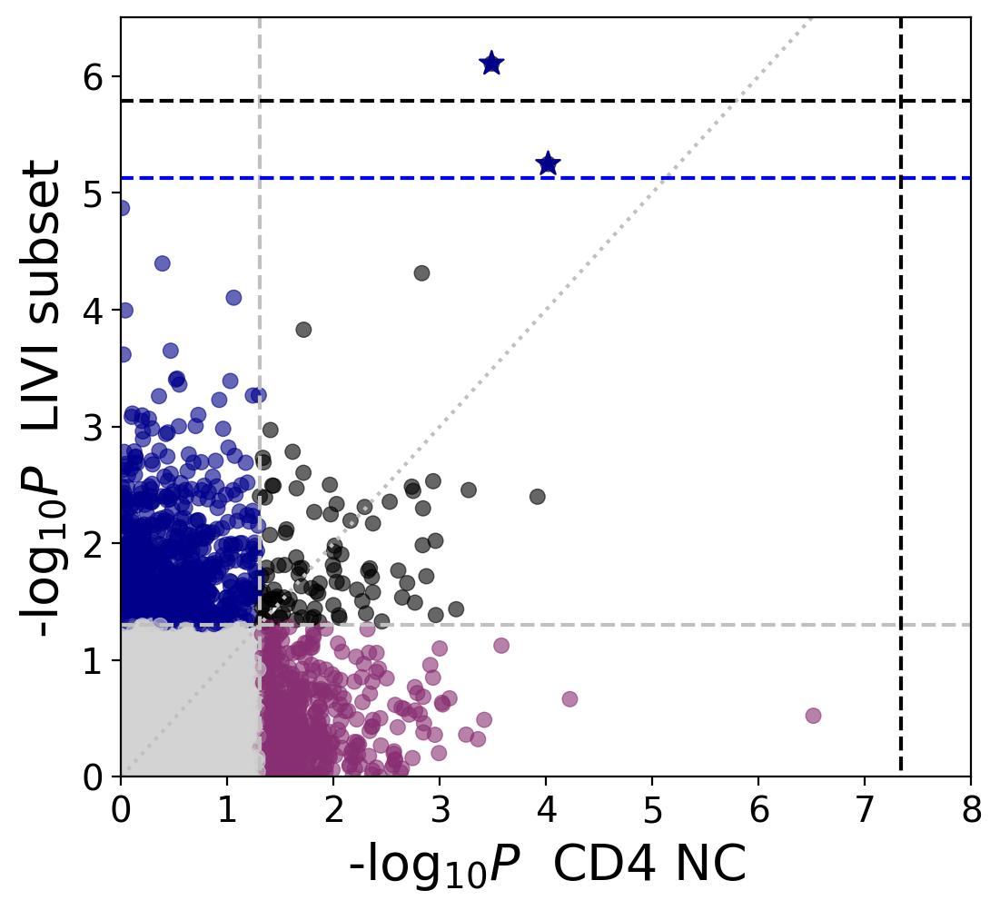

In [129]:
# All genes

fig, axs = plt.subplots(figsize=(6,5.5))

sns.scatterplot(
    x="mlog10_pval_CD4",
    y="mlog10_pval_LIVI",
    hue="plot_color",
    edgecolor="face",
    palette=tmp_livi.plot_color.unique().tolist(),
    data=tmp_livi,
    ax=axs,
    rasterized=True,
    legend=False,
    alpha=0.6
)

sns.scatterplot(
    x="mlog10_pval_CD4",
    y="mlog10_pval_LIVI",
    hue="plot_color",
    edgecolor="face",
    palette=["darkblue", "darkblue"], 
    data=tmp_livi.loc[tmp_livi.GeneSymbol.isin(["SOCS3", "MYC"])],
    marker="*",
    s=100,
    ax=axs,
    rasterized=True,
    legend=False,
)


axs.plot(np.arange(0, max(axs.get_xlim()[1], axs.get_ylim()[1])+1), 
         np.arange(0, max(axs.get_xlim()[1], axs.get_ylim()[1])+1), 
         linestyle=":", color="silver")

axs.axhline(y=-np.log10(0.05), xmin=axs.get_xlim()[0], xmax=axs.get_xlim()[1],
            linestyle="--", color="silver")
axs.axvline(x=-np.log10(0.05), ymin=axs.get_ylim()[0], ymax=axs.get_ylim()[1],
            linestyle="--", color="silver")

axs.axhline(y=-np.log10(pval_cutoff_LIVI), xmin=axs.get_xlim()[0], xmax=axs.get_xlim()[1],
            linestyle="--", color="black")
axs.axhline(y=-np.log10(pval_cutoff_LIVI_snp)-0.12, xmin=axs.get_xlim()[0], xmax=axs.get_xlim()[1],
            linestyle="--", color="blue")
axs.axvline(x=-np.log10(pval_cutoff_cd4), ymin=axs.get_ylim()[0], ymax=axs.get_ylim()[1],
            linestyle="--", color="black")

axs.set_xlim(0, 8)
axs.set_ylim(0, 6.5)

# axs.set_xlabel("-log$_{10}P$  CD4$^+$ T naive cells", fontsize=20)
axs.set_xlabel("-log$_{10}P$  CD4 NC", fontsize=20)
axs.set_ylabel("-log$_{10}P$  LIVI subset", fontsize=20)

plt.savefig(os.path.join(model_results_dir, "Figures", "Scatterplot_SNP-8-22966769_subcelltype-resolution_gene-level-pvalues_CD4-NC_vs_LIVI-cells-017_BH-only-for-SNP.png"), 
            transparent=True, bbox_inches="tight", dpi=400)
plt.savefig(os.path.join(model_results_dir, "Figures", "Scatterplot_SNP-8-22966769_subcelltype-resolution_gene-level-pvalues_CD4-NC_vs_LIVI-cells-017_BH-only-for-SNP.eps"), 
            transparent=True, bbox_inches="tight", dpi=400)
plt.savefig(os.path.join(model_results_dir, "Figures", "Scatterplot_SNP-8-22966769_subcelltype-resolution_gene-level-pvalues_CD4-NC_vs_LIVI-cells-017_BH-only-for-SNP.pdf"), 
            transparent=True, bbox_inches="tight", dpi=400)

### GSEA on absolute loadings

In [22]:
enr_8_22966769 = gp.enrichr(gene_list = adata.var.loc[GxC_decoder["GxC_Factor232"].abs().nlargest(17).index].GeneSymbol.tolist(), 
                          gene_sets = databases_bio, # ["GO_Biological_Process_2023","Reactome_2022"],
                          background = background_genes.values,
                          outdir=None)
enr_8_22966769_sign = enr_8_22966769.results.loc[enr_8_22966769.results["Adjusted P-value"] <= 0.05]
enr_8_22966769_sign.sort_values("Adjusted P-value", ascending=True).head(20).sort_values("Odds Ratio", ascending=False)


,Gene_set,Term,P-value,Adjusted P-value,Old P-value,Old adjusted P-value,Odds Ratio,Combined Score,Genes
2,GO_Biological_Process_2023,T-helper 17 Cell Differentiation (GO:0072539),2.825244e-05,0.002310,0,0,377.920000,3958.459119,SOCS3;STAT3
3,GO_Biological_Process_2023,T-helper 17 Cell Lineage Commitment (GO:0072540),2.825244e-05,0.002310,0,0,377.920000,3958.459119,SOCS3;STAT3
4,GO_Biological_Process_2023,Negative Regulation Of Tyrosine Phosphorylatio...,3.764348e-05,0.002462,0,0,314.911111,3208.109938,SOCS3;SOCS1
452,Reactome_2022,STAT3 Nuclear Events Downstream Of ALK Signali...,6.041352e-05,0.001269,0,0,236.150000,2294.031406,STAT3;PRDM1
453,Reactome_2022,Signaling By Leptin R-HSA-2586552,6.041352e-05,0.001269,0,0,236.150000,2294.031406,SOCS3;STAT3
454,Reactome_2022,Interleukin-6 Signaling R-HSA-1059683,7.378686e-05,0.001356,0,0,209.896296,1997.022603,SOCS3;STAT3
447,Reactome_2022,Growth Hormone Receptor Signaling R-HSA-982772,1.366406e-06,0.000113,0,0,189.656250,2560.990254,SOCS3;SOCS1;STAT3
448,Reactome_2022,Signaling By ALK R-HSA-201556,1.606351e-06,0.000113,0,0,178.487395,2381.297738,MYC;STAT3;PRDM1
455,Reactome_2022,Regulation Of IFNA/IFNB Signaling R-HSA-912694,1.218265e-04,0.001791,0,0,157.388889,1418.532369,SOCS3;SOCS1
456,Reactome_2022,Regulation Of IFNG Signaling R-HSA-877312,1.218265e-04,0.001791,0,0,157.388889,1418.532369,SOCS3;SOCS1


/data/danai/miniforge3/envs/LIVIenv_py311/lib/python3.11/site-packages/gseapy/plot.py:754: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
/tmp/ipykernel_314766/1848826531.py:16: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or Axes decorations smaller.
/tmp/ipykernel_314766/1848826531.py:18: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or Axes decorations smaller.
/tmp/ipykernel_314766/1848826531.py:20: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or Axes decorations smaller.
/data/danai/miniforge3/envs/LIVIenv_py311/li

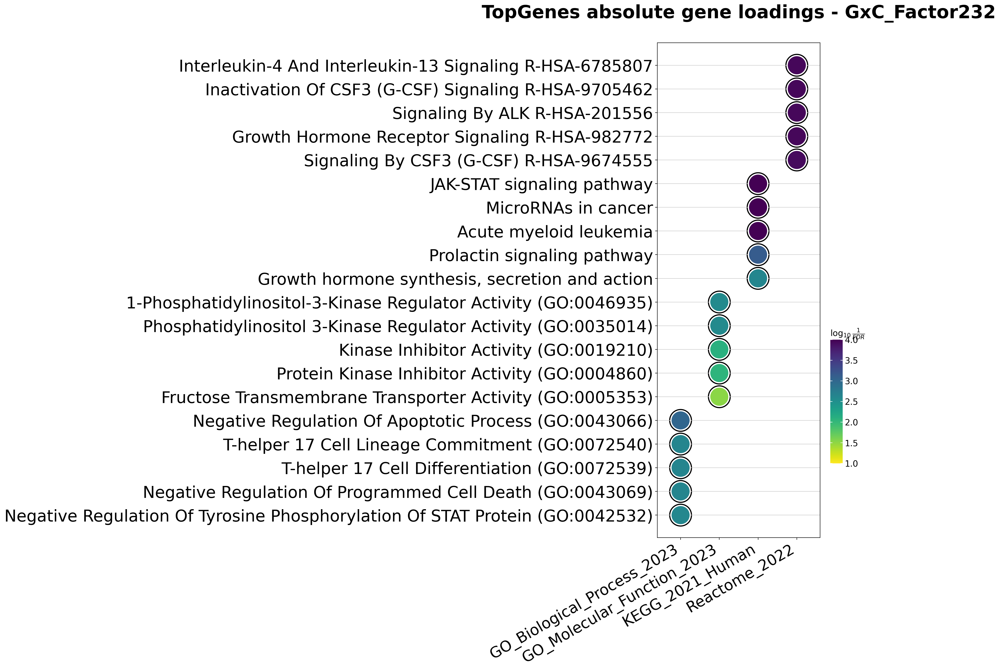

In [25]:
fig, axs = plt.subplots(figsize=(6,15), constrained_layout=True)
make_gp_dotplot(df=enr_8_22966769_sign,
                x="Gene_set",
                y="Term",
                column="Adjusted P-value",
                size=5,
                top_term = 5,
                title = "TopGenes absolute gene loadings - GxC_Factor232\n",
                show_ring=True,
                marker="o",
                xticklabels_rot=30,
                ax = axs,
                fig = fig,
                rasterize=True)
axs.set_xlabel("")
plt.savefig(os.path.join(model_results_dir, "Figures", "GSEA_8_22966769_TopGenes.png"), 
            transparent=True, bbox_inches="tight", dpi=500)
plt.savefig(os.path.join(model_results_dir, "Figures", "GSEA_8_22966769_TopGenes.eps"), 
            transparent=True, bbox_inches="tight", dpi=500)
plt.savefig(os.path.join(model_results_dir, "Figures", "GSEA_8_22966769_TopGenes.pdf"), 
            transparent=True, bbox_inches="tight", dpi=500)

/data/danai/scripts/LIVI/src/analysis/plotting.py:2176: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/data/danai/scripts/LIVI/src/analysis/plotting.py:2180: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


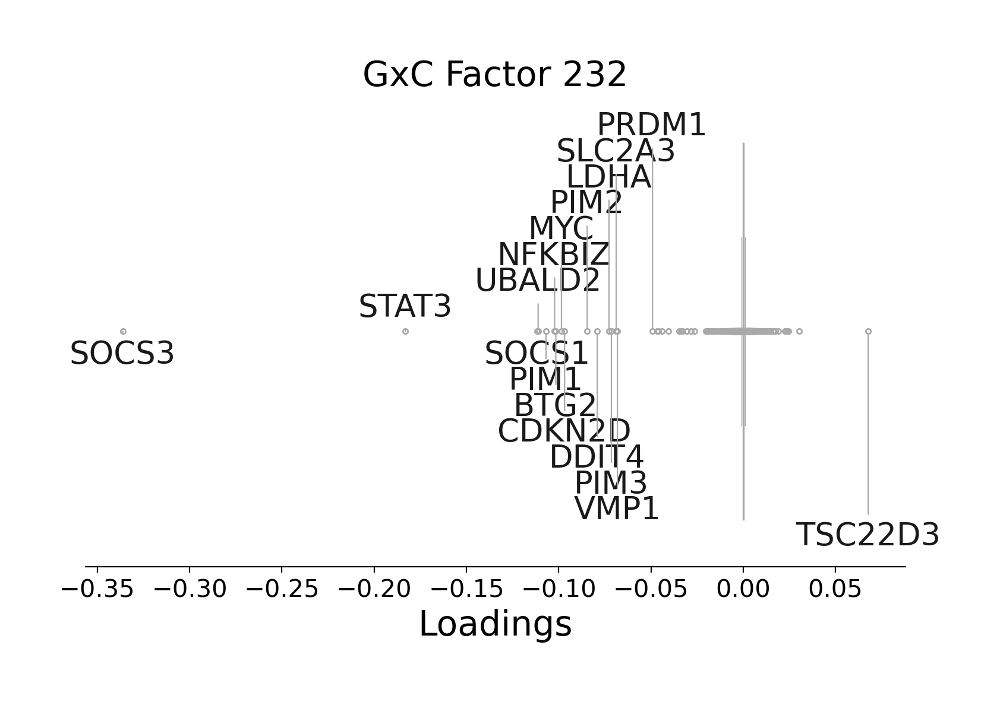

In [110]:
plot_gene_loadings_for_factor(
    GxC_decoder=GxC_decoder,
    factor="GxC_Factor232",
    adata_var=adata.var,
    gene_name_column="GeneSymbol",
    color="darkgrey",
    spines_invisible=True,
    n_top_genes=17,
    genes_to_annotate=None,
    annotation_fontsize=19,
    offset=0.055,
    x_distance=2e-2,
    savefig=os.path.join(model_results_dir, "Figures", "Boxplots_gene-loadings_GxC232_grey.eps"),
)

/data/danai/scripts/LIVI/src/analysis/plotting.py:2340: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


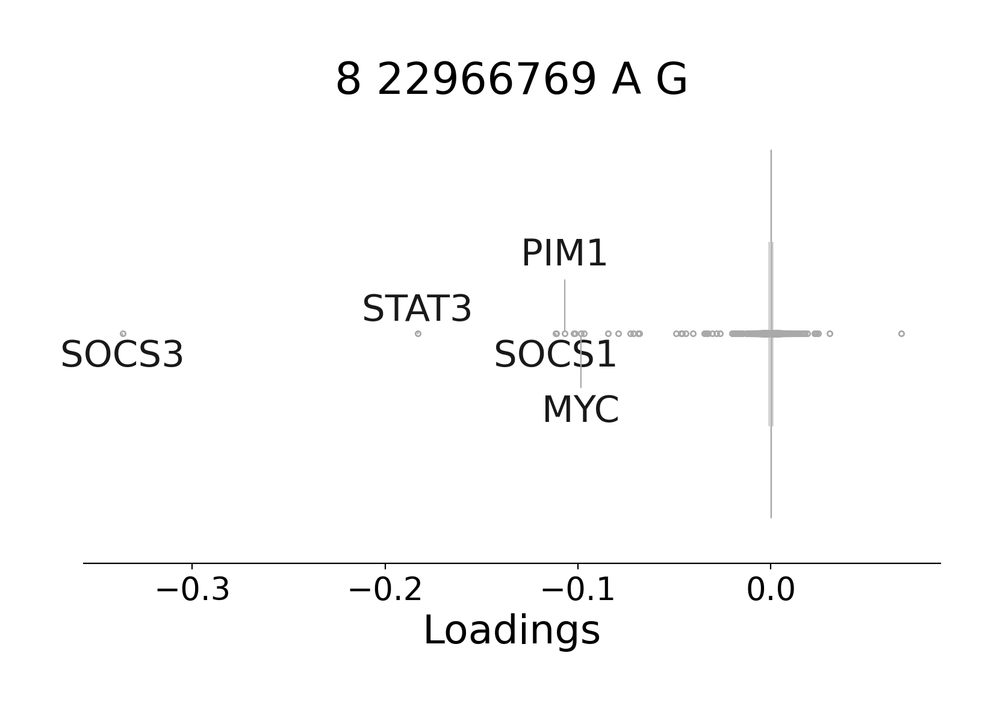

In [132]:
plot_gene_loadings_for_associated_variable(
    GxC_associations=GxC_effects,
    variable=SNP_dict_inv["8:22966769"],
    GxC_decoder=GxC_decoder,
    adata_var=adata.var,
    gene_name_column="GeneSymbol",
    color="darkgrey",
    genes_to_annotate=adata.var.loc[adata.var.GeneSymbol.isin(enr_8_22966769_sign.loc[enr_8_22966769_sign.Term == "JAK-STAT signaling pathway"].Genes.str.split(";").iloc[0])].index,
    spines_invisible=True,
    offset=0.12,
    x_distance=5e-2,
    annotation_fontsize=22,
    # color="grey",
    d=5,
    savefig=os.path.join(model_results_dir, "Figures", "Boxplots_gene-loadings_U232_8-22966769_JAK-STAT-genes.eps"),
)

/data/danai/scripts/LIVI/src/analysis/plotting.py:2340: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


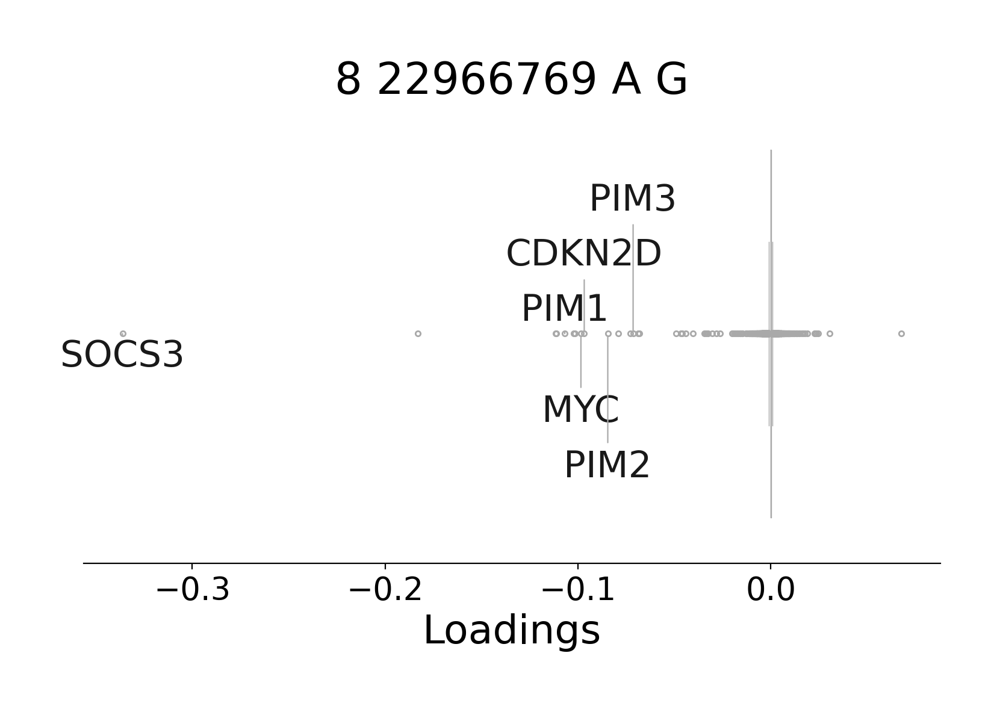

In [130]:
plot_gene_loadings_for_associated_variable(
    GxC_associations=GxC_effects,
    variable=SNP_dict_inv["8:22966769"],
    GxC_decoder=GxC_decoder,
    adata_var=adata.var,
    gene_name_column="GeneSymbol",
    color="darkgrey",
    genes_to_annotate=adata.var.loc[adata.var.GeneSymbol.isin(enr_8_22966769_sign.loc[enr_8_22966769_sign.Term.str.contains("Negative Regulation Of Apoptotic Process")].Genes.str.split(";").iloc[0])].index,
    spines_invisible=True,
    offset=0.12,
    x_distance=5e-2,
    annotation_fontsize=22,
   # color="black",
    d=5,
    savefig=os.path.join(model_results_dir, "Figures", f"Boxplots_gene-loadings_U232_8-22966769_{'Negative Regulation Of Apoptotic Process'.replace(' ', '-')}.eps"),
)

/data/danai/scripts/LIVI/src/analysis/plotting.py:2340: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


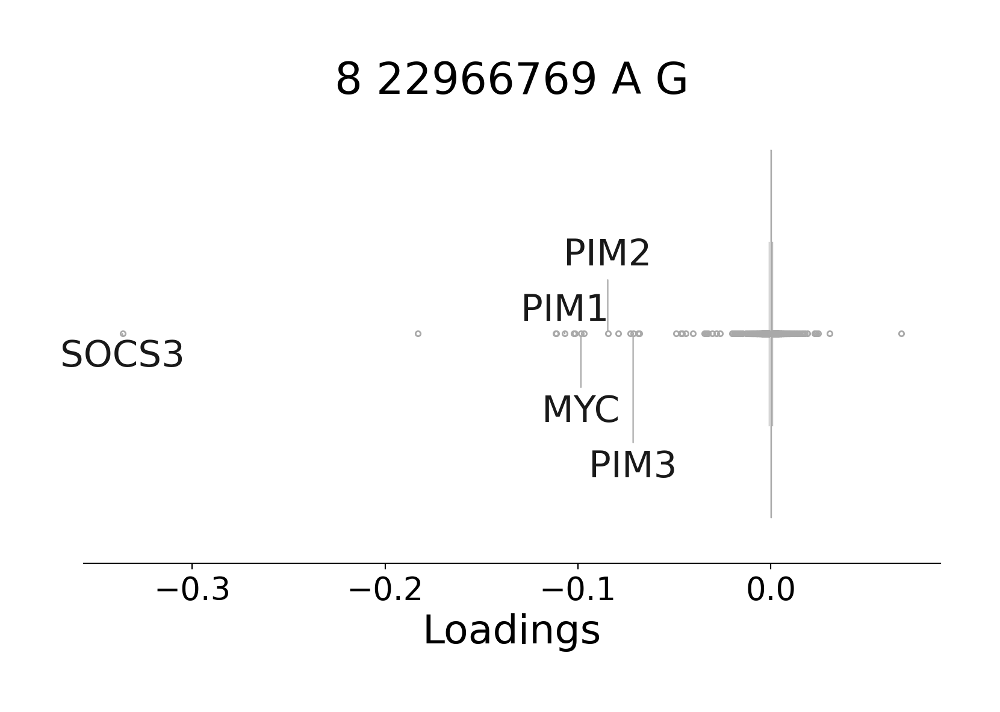

In [131]:
plot_gene_loadings_for_associated_variable(
    GxC_associations=GxC_effects,
    variable=SNP_dict_inv["8:22966769"],
    GxC_decoder=GxC_decoder,
    adata_var=adata.var,
    gene_name_column="GeneSymbol",
    color="darkgrey",
    genes_to_annotate=adata.var.loc[adata.var.GeneSymbol.isin(enr_8_22966769_sign.loc[enr_8_22966769_sign.Term.str.contains("Negative Regulation Of Programmed Cell Death")].Genes.str.split(";").iloc[0])].index,
    spines_invisible=True,
    offset=0.12,
    x_distance=5e-2,
    annotation_fontsize=22,
   # color="black",
    d=5,
    savefig=os.path.join(model_results_dir, "Figures", f"Boxplots_gene-loadings_U232_8-22966769_{'Negative Regulation Of Programmed Cell Death'.replace(' ', '-')}.eps"),
)

In [363]:
enr_8_22966769_sign.loc[enr_8_22966769_sign.Gene_set=="GO_Molecular_Function_2023"]

,Gene_set,Term,P-value,Adjusted P-value,Old P-value,Old adjusted P-value,Odds Ratio,Combined Score,Genes,mlog10pval
327,GO_Molecular_Function_2023,1-Phosphatidylinositol-3-Kinase Regulator Acti...,0.000074,0.002665,0,0,209.896296,1997.022603,SOCS3;SOCS1,2.574360
328,GO_Molecular_Function_2023,Phosphatidylinositol 3-Kinase Regulator Activi...,0.000104,0.002665,0,0,171.709091,1573.947418,SOCS3;SOCS1,2.574360
329,GO_Molecular_Function_2023,Kinase Inhibitor Activity (GO:0019210),0.000466,0.007916,0,0,75.477333,579.072161,SOCS3;SOCS1,2.101516
330,GO_Molecular_Function_2023,Protein Kinase Inhibitor Activity (GO:0004860),0.000697,0.008893,0,0,60.843011,442.209769,SOCS3;SOCS1,2.050962
331,GO_Molecular_Function_2023,Fructose Transmembrane Transporter Activity (G...,0.003589,0.030489,0,0,442.968750,2493.866101,SLC2A3,1.515856
332,GO_Molecular_Function_2023,Protein Kinase Regulator Activity (GO:0019887),0.004340,0.030489,0,0,23.203292,126.223384,SOCS3;SOCS1,1.515856
333,GO_Molecular_Function_2023,Protein Serine/Threonine Kinase Activity (GO:0...,0.004464,0.030489,0,0,10.520444,56.932580,PIM1;PIM3;PIM2,1.515856
334,GO_Molecular_Function_2023,Protein Tyrosine Kinase Inhibitor Activity (GO...,0.004783,0.030489,0,0,295.291667,1577.676000,SOCS3,1.515856
335,GO_Molecular_Function_2023,Primary miRNA Binding (GO:0070878),0.007166,0.032779,0,0,177.150000,874.843204,STAT3,1.484404
336,GO_Molecular_Function_2023,Dehydroascorbic Acid Transmembrane Transporter...,0.007166,0.032779,0,0,177.150000,874.843204,SLC2A3,1.484404


In [439]:
enr_8_22966769_sign = enr_8_22966769_sign.assign(mlog10pval = -np.log10(enr_8_22966769_sign["Adjusted P-value"]))
plot_df = enr_8_22966769_sign.filter(["Gene_set", "Term", "mlog10pval"])
plot_df = plot_df.loc[plot_df.Gene_set != "GO_Molecular_Function_2023"]
plot_df = plot_df.sort_values(by="mlog10pval", ascending=False)

idx = plot_df.groupby("Gene_set", observed=True).apply(
    lambda x: x.mlog10pval.nlargest(5, keep="last"), include_groups=False
).index.get_level_values(1)
plot_df = plot_df.loc[idx]
# plot_df = plot_df.loc[plot_df.Gene_set != "KEGG_2021_Human"]
plot_df

,Gene_set,Term,mlog10pval
0,GO_Biological_Process_2023,Negative Regulation Of Apoptotic Process (GO:0...,3.019564
3,GO_Biological_Process_2023,T-helper 17 Cell Lineage Commitment (GO:0072540),2.636456
2,GO_Biological_Process_2023,T-helper 17 Cell Differentiation (GO:0072539),2.636456
1,GO_Biological_Process_2023,Negative Regulation Of Programmed Cell Death (...,2.636456
4,GO_Biological_Process_2023,Negative Regulation Of Tyrosine Phosphorylatio...,2.608732
379,KEGG_2021_Human,MicroRNAs in cancer,4.950072
378,KEGG_2021_Human,JAK-STAT signaling pathway,4.950072
380,KEGG_2021_Human,Acute myeloid leukemia,4.819512
381,KEGG_2021_Human,Prolactin signaling pathway,3.137138
382,KEGG_2021_Human,"Growth hormone synthesis, secretion and action",2.621478


In [440]:
plot_df.Term = [textwrap.fill(term, width=50) for term in plot_df.Term]

In [441]:
term_idx = plot_df.sort_values("mlog10pval", ascending=True).groupby("Gene_set").groups
term_idx 

{'GO_Biological_Process_2023': [4, 3, 2, 1, 0], 'KEGG_2021_Human': [382, 381, 380, 379, 378], 'Reactome_2022': [451, 450, 449, 448, 447]}

In [442]:
# sorted_idx = list(itertools.chain.from_iterable(
#     [term_idx["GO_Molecular_Function_2023"], term_idx["GO_Biological_Process_2023"], term_idx["Reactome_2022"], term_idx["KEGG_2021_Human"]])
#                  )
sorted_idx = list(itertools.chain.from_iterable(
    [term_idx["GO_Biological_Process_2023"], term_idx["Reactome_2022"], term_idx["KEGG_2021_Human"]])
                 )

In [443]:
# gs_colors = dict(zip(["KEGG_2021_Human", "Reactome_2022", "GO_Biological_Process_2023", "GO_Molecular_Function_2023"], ["darkgreen", "orange", "royalblue", "brown"]))
# gs_colors = dict(zip(["KEGG_2021_Human", "Reactome_2022", "GO_Biological_Process_2023"], ["darkgreen", "orange", "darkred"]))
gs_colors = dict(zip(["KEGG_2021_Human", "Reactome_2022", "GO_Biological_Process_2023"], ["midnightblue", "darkslategrey", "slategrey"]))

gs_colors

{'KEGG_2021_Human': 'midnightblue',
 'Reactome_2022': 'darkslategrey',
 'GO_Biological_Process_2023': 'slategrey'}

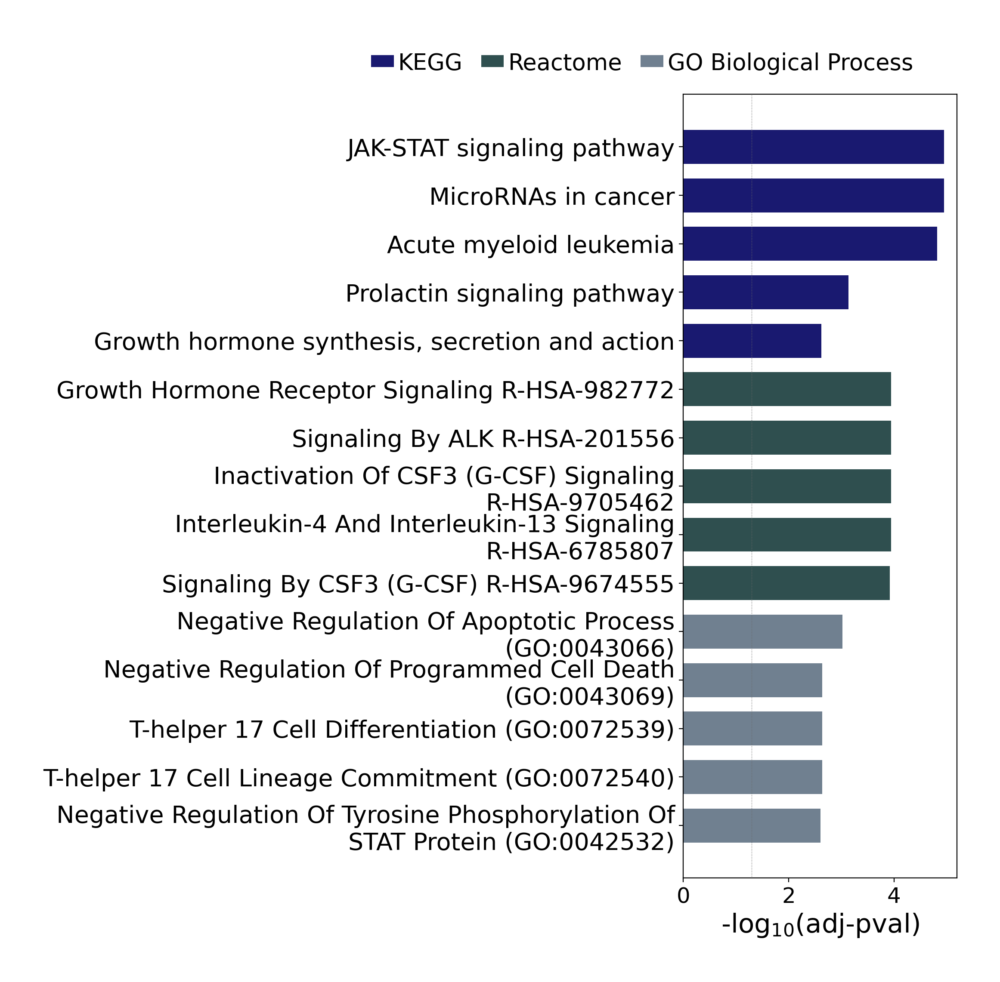

In [460]:
fig, axs = plt.subplots(figsize=(10.7,10.5), constrained_layout=True)

for idx in sorted_idx:
    axs.barh(y=plot_df.loc[idx]["Term"], width=plot_df.loc[idx]["mlog10pval"], height=0.7, label=plot_df.loc[idx]["Gene_set"], 
             color=gs_colors[plot_df.loc[idx]["Gene_set"]], edgecolor=gs_colors[plot_df.loc[idx]["Gene_set"]])
axs.set_xlabel("-log$_{10}$(adj-pval)", fontsize=22)
axs.tick_params(axis="y", labelsize=20)
axs.tick_params(axis="x", labelsize=18)

legend_handles = []
for db, col in gs_colors.items():
    legend_handles.append(Line2D([0], [0], color=col, lw=10, linestyle="--", label=db))

db_short = {"GO_Biological_Process_2023":"GO Biological Process", "GO_Molecular_Function_2023":"GO Molecular Function", "KEGG_2021_Human":"KEGG", "Reactome_2022":"Reactome"}
# axs.legend(handles=legend_handles, fontsize=19, bbox_to_anchor=(-1.15, 0.98))
axs.legend(handles=legend_handles,
           labels=[db_short[db.get_label()] for db in legend_handles],
           fontsize=19,
           handletextpad=0.2,
           labelspacing=0.1,
           columnspacing=0.8,
           loc="upper center",
           bbox_to_anchor=(-0.15, 1.08),  #  bbox_to_anchor=(1.03, -0.022), 
           ncols=4)
# leg = axs.get_legend()
# for line, text in zip(leg.get_lines(), leg.get_texts()):
#     text.set_color(line.get_color())
#     text.set_weight("bold")

axs.axvline(x=-np.log10(0.05), ymin=axs.get_ylim()[0], ymax=axs.get_ylim()[1], linestyle=":", color="dimgrey")

plt.savefig(os.path.join(model_results_dir, "Figures", "Barplot_GSEA_bio_TopGenes_GxC-Factor232_8-22966769_gradient-colors_longer.pdf"), 
            transparent=True, bbox_inches="tight", dpi=500)
plt.savefig(os.path.join(model_results_dir, "Figures", "Barplot_GSEA_bio_TopGenes_GxC-Factor232_8-22966769_gradient-colors_longer.png"), 
            transparent=True, bbox_inches="tight", dpi=500)
plt.savefig(os.path.join(model_results_dir, "Figures", "Barplot_GSEA_bio_TopGenes_GxC-Factor232_8-22966769_gradient-colors_longer.eps"), 
            transparent=True, bbox_inches="tight", dpi=500)

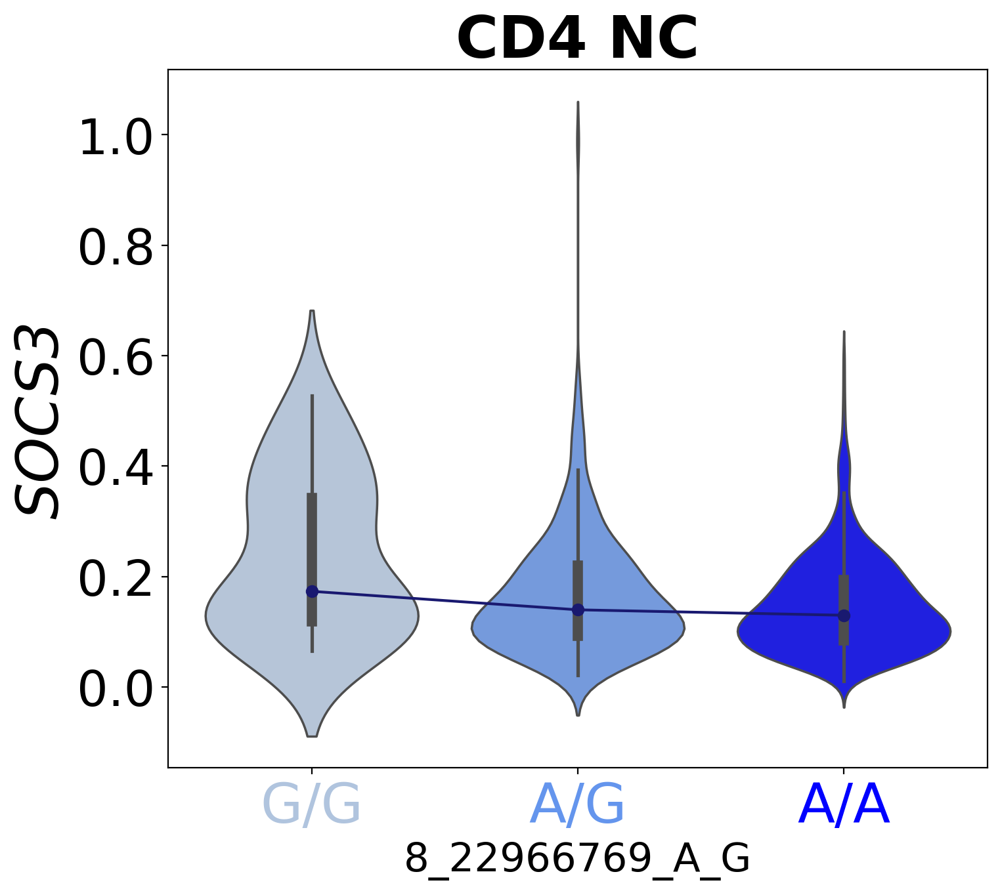

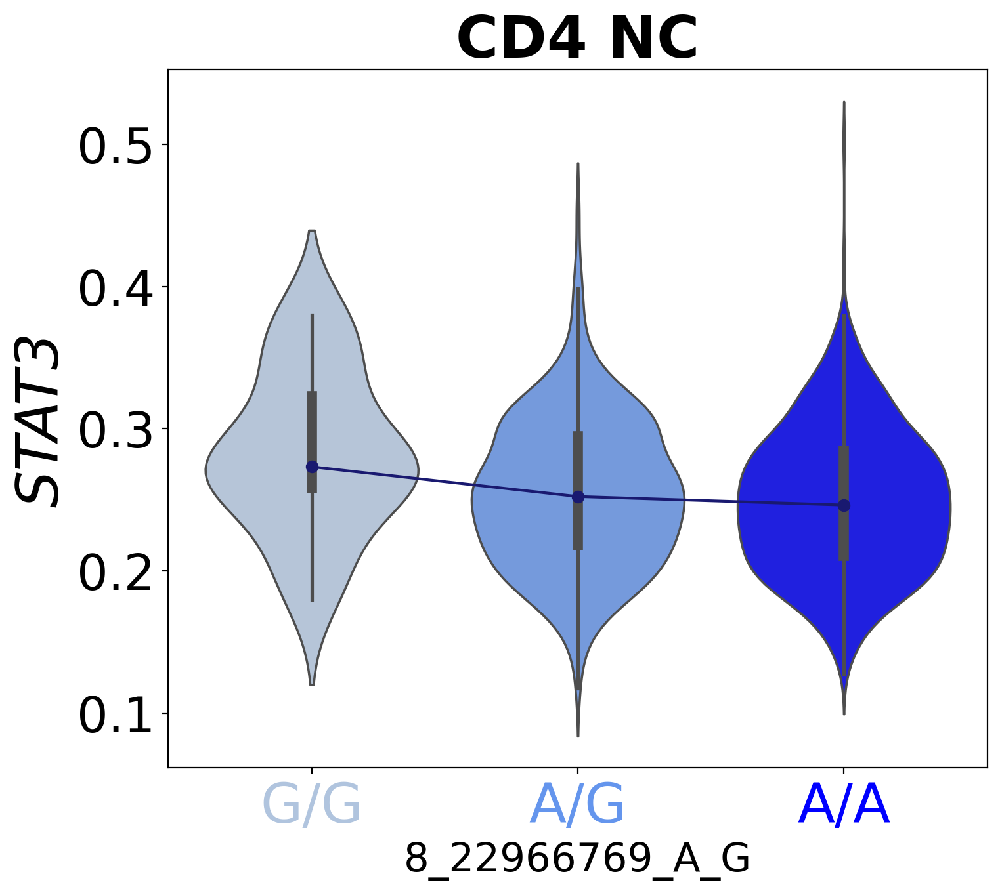

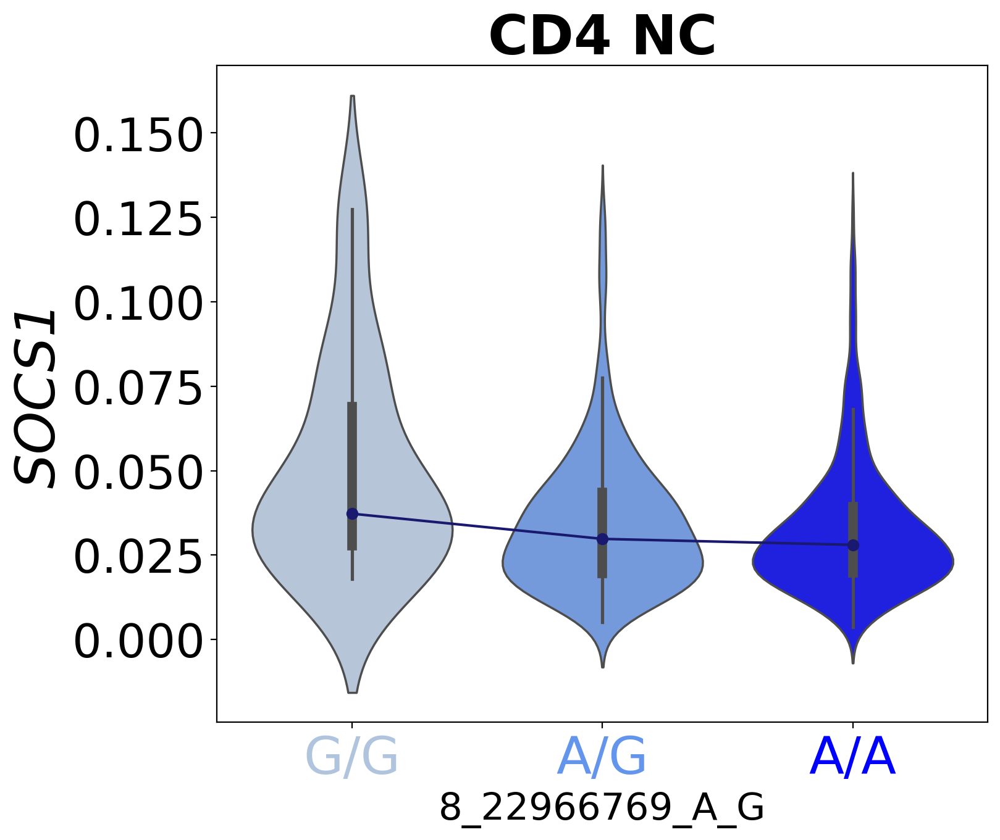

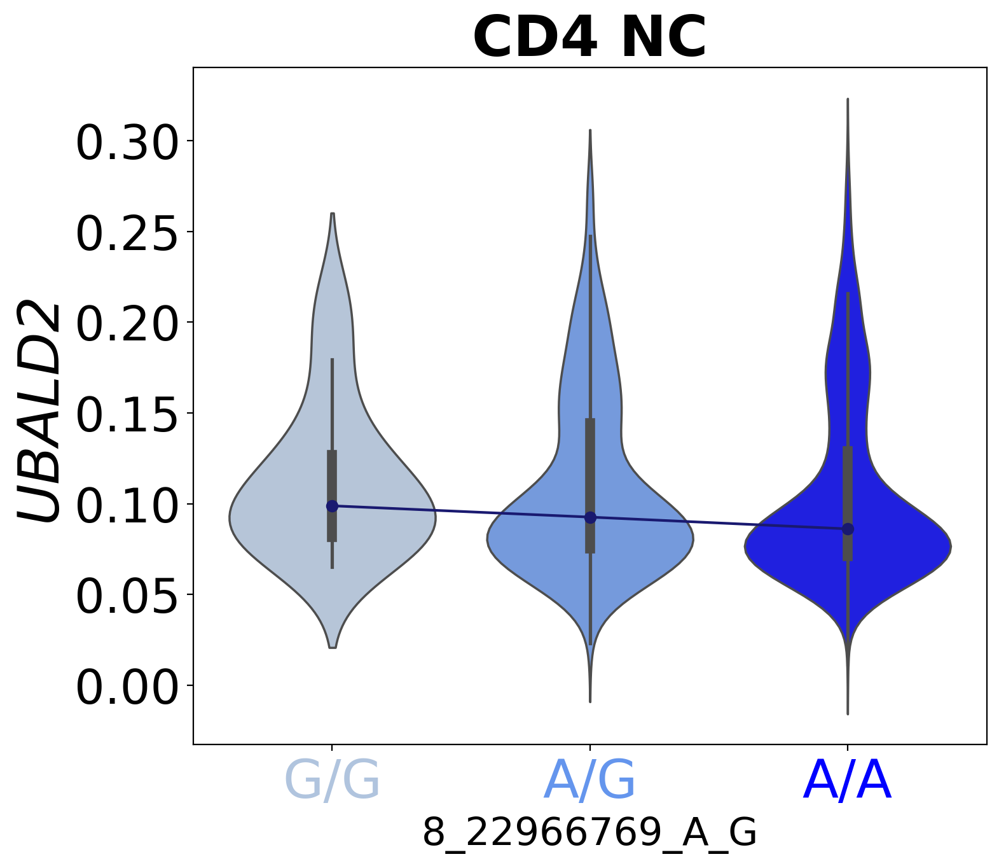

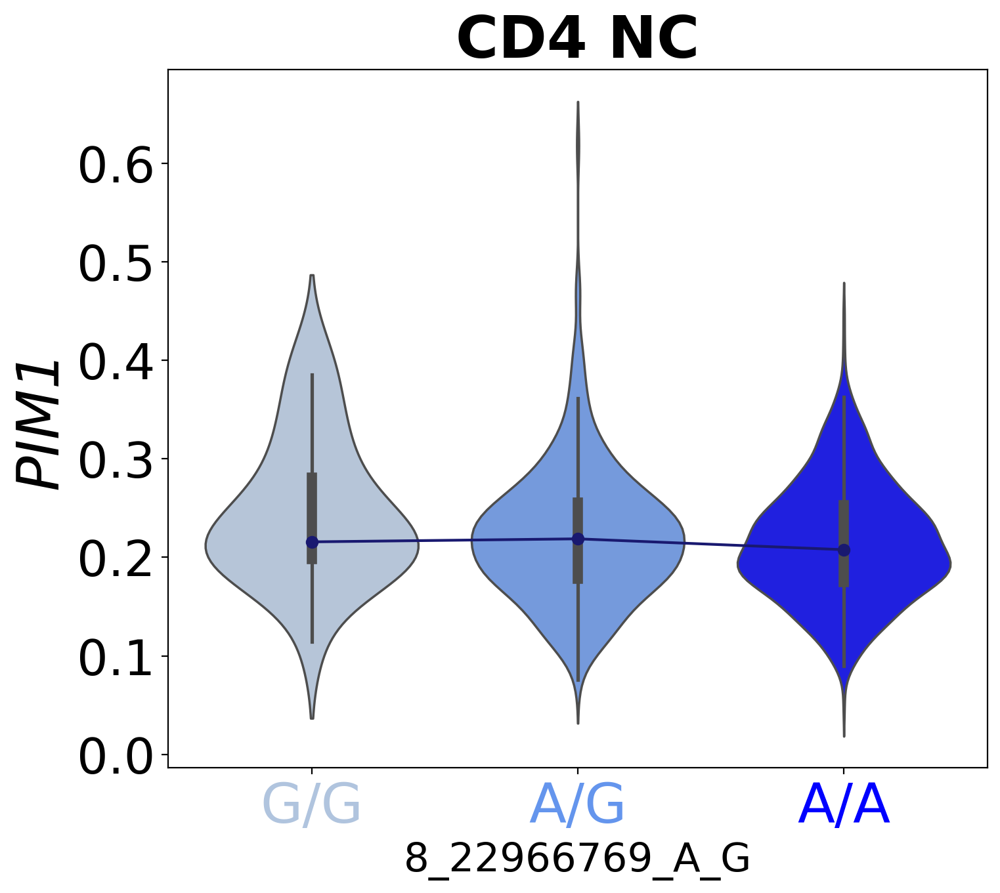

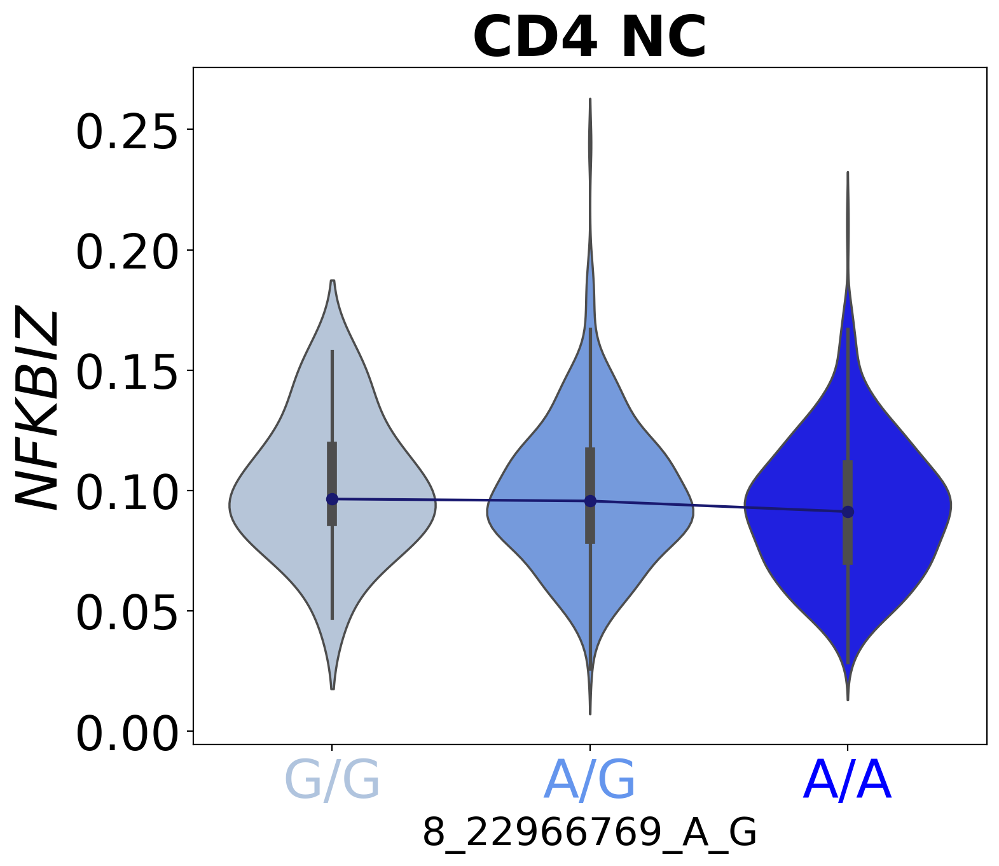

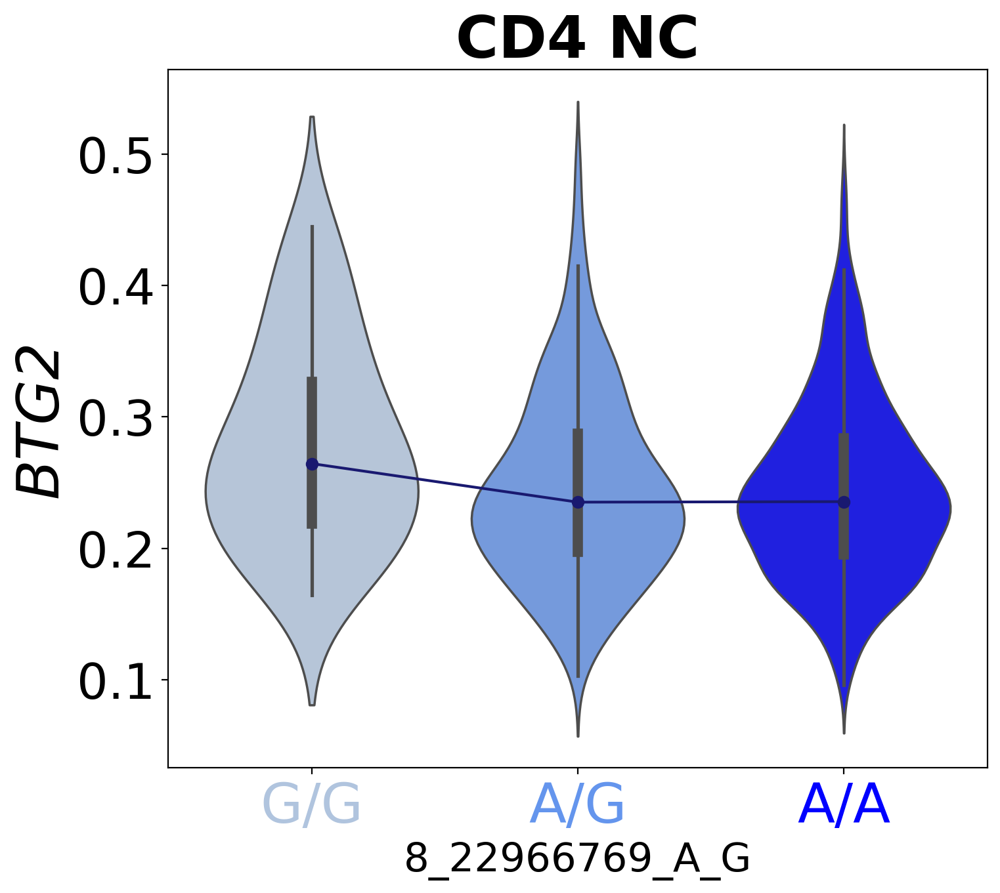

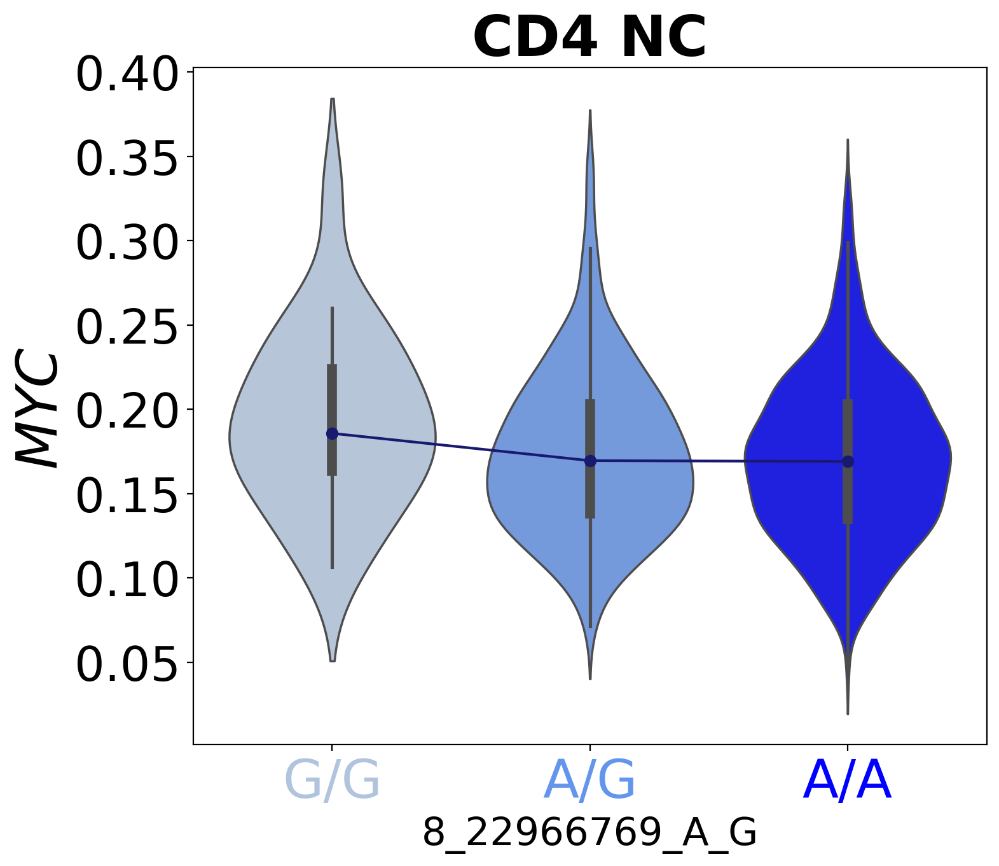

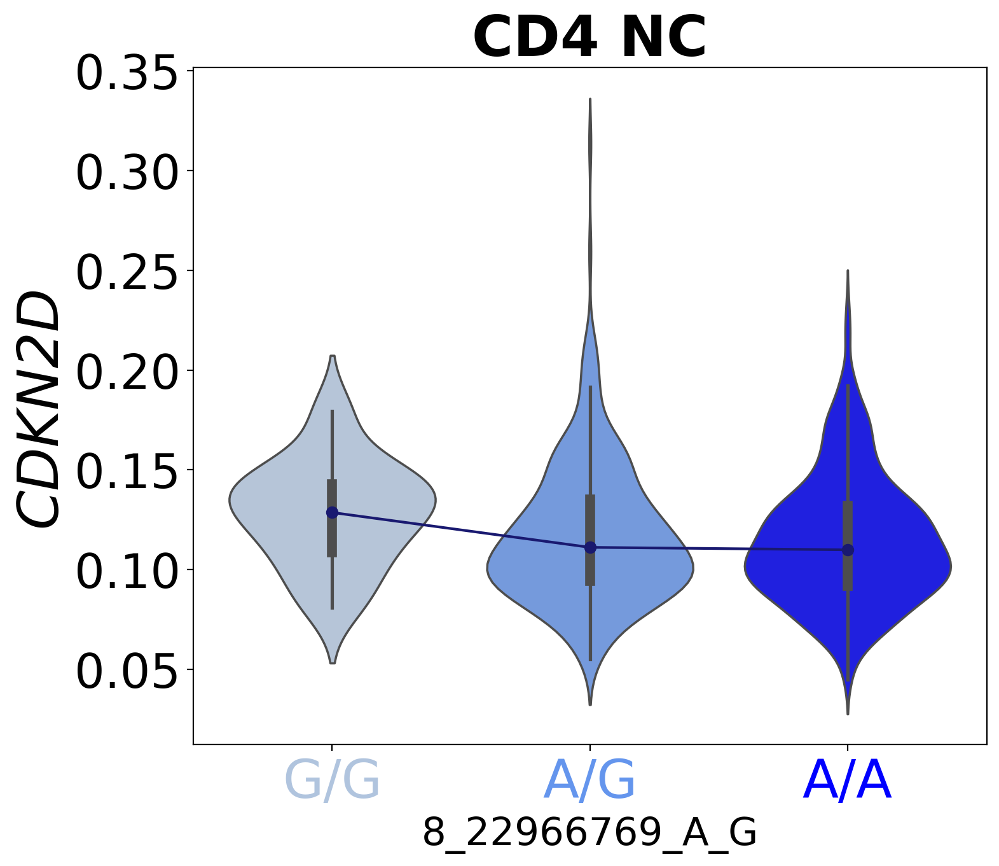

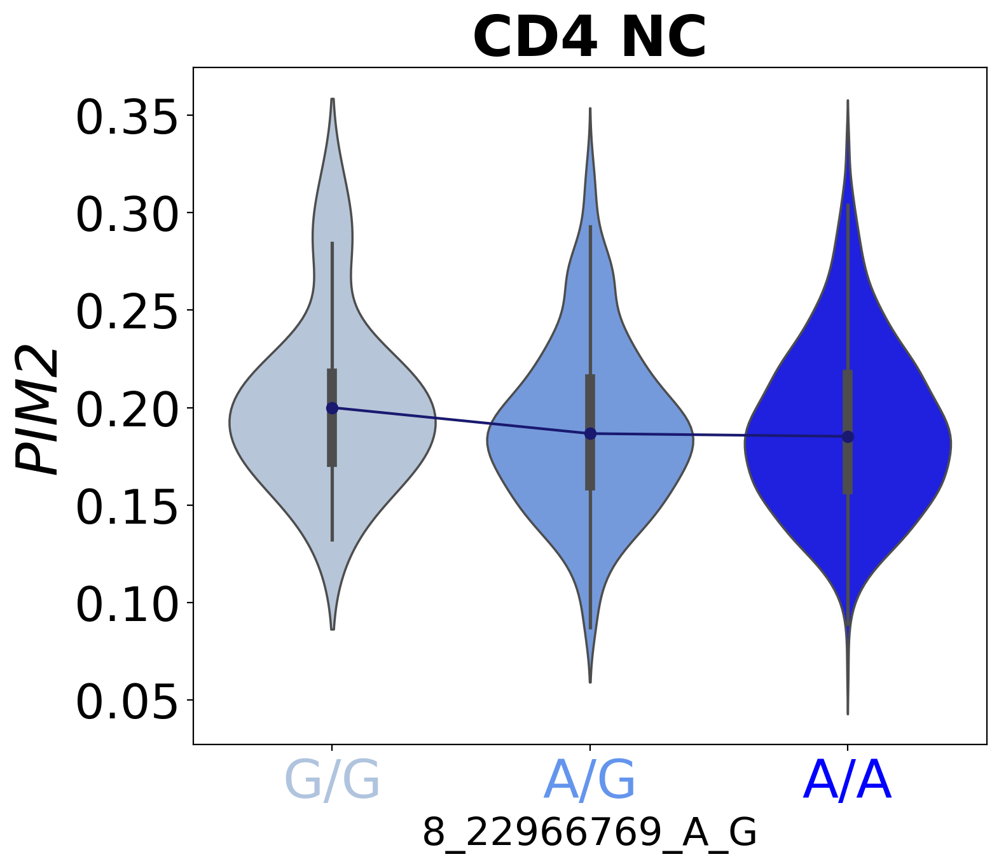

In [53]:
for g in GxC_decoder["GxC_Factor232"].abs().nlargest(10).index:
    plot_ct_gex_vs_gt(
        adata=adata,
        gene=g,
        annotation_fontsize=30,
        filter_maf=False,
        test_gt_groups=False,
        cell_indices=None,
        celltype="CD4 NC",
        celltype_column="cell_label",
        iid_column="individual",
        GT_matrix=GT_matrix,
        SNP_id=SNP_dict_inv["8:22966769"],
        GxC_associations = GxC_effects,
        hgnc_column="GeneSymbol",
        savefig=True,
        output_dir=os.path.join(model_results_dir, "Figures"),
        output_prefix="WO_Mann-Whitney",
        format="png",
    )

### Effect on cells

In [470]:
GxC_beta_softmax = calculate_GxC_effect(
    GxC_associations = GxC_effects,
    SNP_id = SNP_dict_inv["8:22966769"],
    cell_state_latent = zbase,
    A = assignment_matrix,
)
GxC_beta_softmax

,GxC_Factor232
barcode,
AAACCTGAGAATGTTG-1,0.116130
AAACCTGAGAGAACAG-1,0.048748
AAACCTGAGCATGGCA-1,0.115199
AAACCTGAGTATTGGA-1,0.081567
AAACCTGAGTGTCCCG-1,0.038616
...,...
TTTGTCATCCGCTGTT-9,0.040013
TTTGTCATCCGTTGTC-9,0.127634
TTTGTCATCGCCGTGA-9,0.200962


In [222]:
GxC_beta_softmax_ct = GxC_beta_softmax["GxC_Factor232"].to_frame().merge(adata.obs.cell_label, right_index=True, left_index=True)
GxC_beta_softmax_ct = GxC_beta_softmax_ct.groupby("cell_label", observed=True).apply(lambda x: x["GxC_Factor232"].mean(), include_groups=False
                                                                                    ).rename("GxC_Factor232")
GxC_beta_softmax_ct

cell_label
B IN         0.047255
B Mem        0.046083
CD4 ET       0.127687
CD4 NC       0.152454
CD4 SOX4     0.153978
CD8 ET       0.038793
CD8 NC       0.124850
CD8 S100B    0.088091
DC           0.043299
Mono C       0.057559
Mono NC      0.046667
NK           0.032546
NK R         0.035132
Plasma       0.022320
Name: GxC_Factor232, dtype: float64

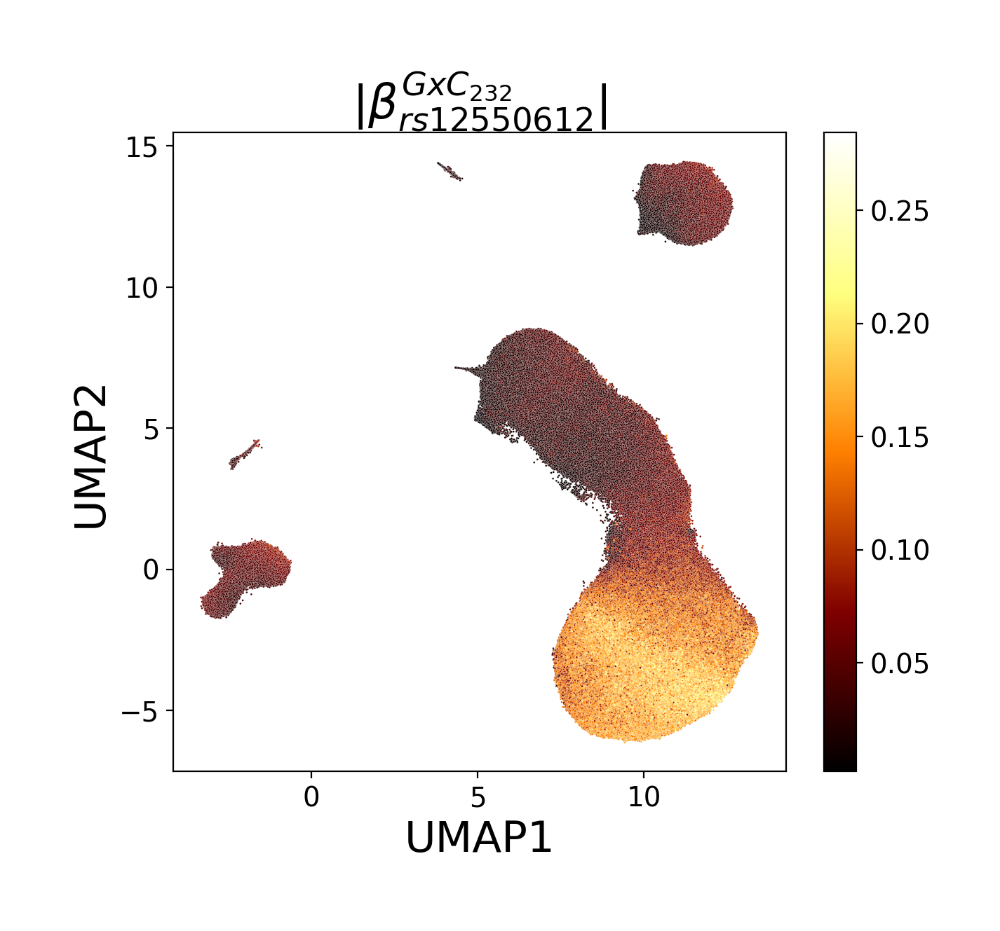

In [474]:
# Absolute effect
fig, axs = plt.subplots(figsize=(7,6))
sns.scatterplot(
    x="UMAP1",
    y="UMAP2",
    hue="GxC_Factor232",
    data=umap_base.merge(GxC_beta_softmax.abs(), right_index=True, left_index=True),
    ax=axs,
    s=1,
    palette="afmhot", # "gist_heat"
    rasterized=True,
    legend=False,
)

sm = cm.ScalarMappable(
    cmap="afmhot", # "gist_heat"
    norm=colors.Normalize(
        vmin=GxC_beta_softmax["GxC_Factor232"].abs().min(),
        vmax=GxC_beta_softmax["GxC_Factor232"].abs().max(),
    ),
)
cb = plt.colorbar(sm, ax=axs)

# axs.set_title(
#     label=fr"$GxC232_{{|\beta_{{{rsid}}}|}}$", fontdict={"fontsize": 24}, loc="center"
# )
axs.set_title(
    label=fr"$|\beta_{{{rsid}}}^{{GxC_{{232}}}}|$", fontdict={"fontsize": 24}, loc="center"
)
axs.xaxis.label.set_fontsize(22)
axs.yaxis.label.set_fontsize(22)

plt.savefig(os.path.join(model_results_dir, "Figures", f"{model}_Softmax-Absolute-SNP-effect-on-cells_U232_SNP-8-22966769.png"),
                         dpi=500, transparent=True, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", f"{model}_Softmax-Absolute-SNP-effect-on-cells_U232_SNP-8-22966769.pdf"),
                         dpi=800, transparent=True, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", f"{model}_Softmax-Absolute-SNP-effect-on-cells_U232_SNP-8-22966769.eps"),
                         dpi=600, transparent=True, bbox_inches="tight")

In [476]:
GxC_beta_softmax_ct = GxC_beta_softmax.abs().merge(adata.obs.cell_label, right_index=True, left_index=True)
GxC_beta_softmax_ct = GxC_beta_softmax_ct.groupby("cell_label", observed=True).apply(lambda x: x["GxC_Factor232"].mean(), include_groups=False).rename("GxC_Factor232")

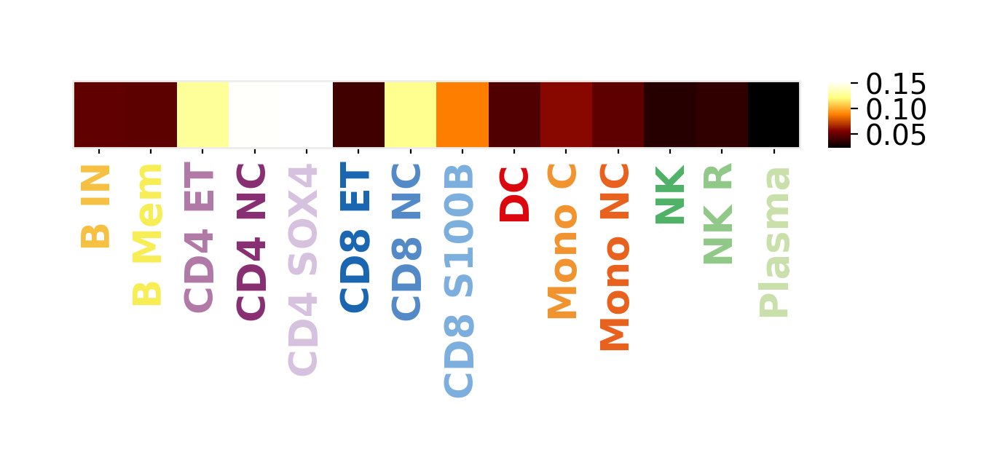

In [487]:
fig, axs = plt.subplots(figsize=(8,0.6))

sns.heatmap(GxC_beta_softmax_ct.to_frame().T, cmap="afmhot", ax=axs, yticklabels=[], cbar_kws={"anchor":(-0.15,0.5), "aspect":3})
# axs.set_ylabel(fr"$GxC693_{{\beta_{{{rsid}}}}}$")
axs.set_xlabel("")
axs.xaxis.label.set_fontsize(23)
axs.tick_params(axis="x", length=3)
for j, label in enumerate(axs.get_xticklabels()):
    label.set_color(cell_label_colors[label.get_text()])
    label.set_fontweight("bold")
    label.set_fontsize(19)

# add border for visual clarity
for spine in axs.spines.values():
    spine.set_visible(True)
    spine.set_edgecolor("#ededed")
    spine.set_linewidth(1)
    
plt.savefig(os.path.join(model_results_dir, "Figures", "GxC232_absolute-effect_celltype_heatmap_SNP-8-22966769.pdf"), 
            bbox_inches="tight", transparent=True, dpi=600)
plt.savefig(os.path.join(model_results_dir, "Figures", "GxC232_absolute-effect_celltype_heatmap_SNP-8-22966769.png"), 
            bbox_inches="tight", transparent=True, dpi=600)
plt.savefig(os.path.join(model_results_dir, "Figures", "GxC232_absolute-effect_celltype_heatmap_SNP-8-22966769.eps"), 
            bbox_inches="tight", transparent=True, dpi=600)


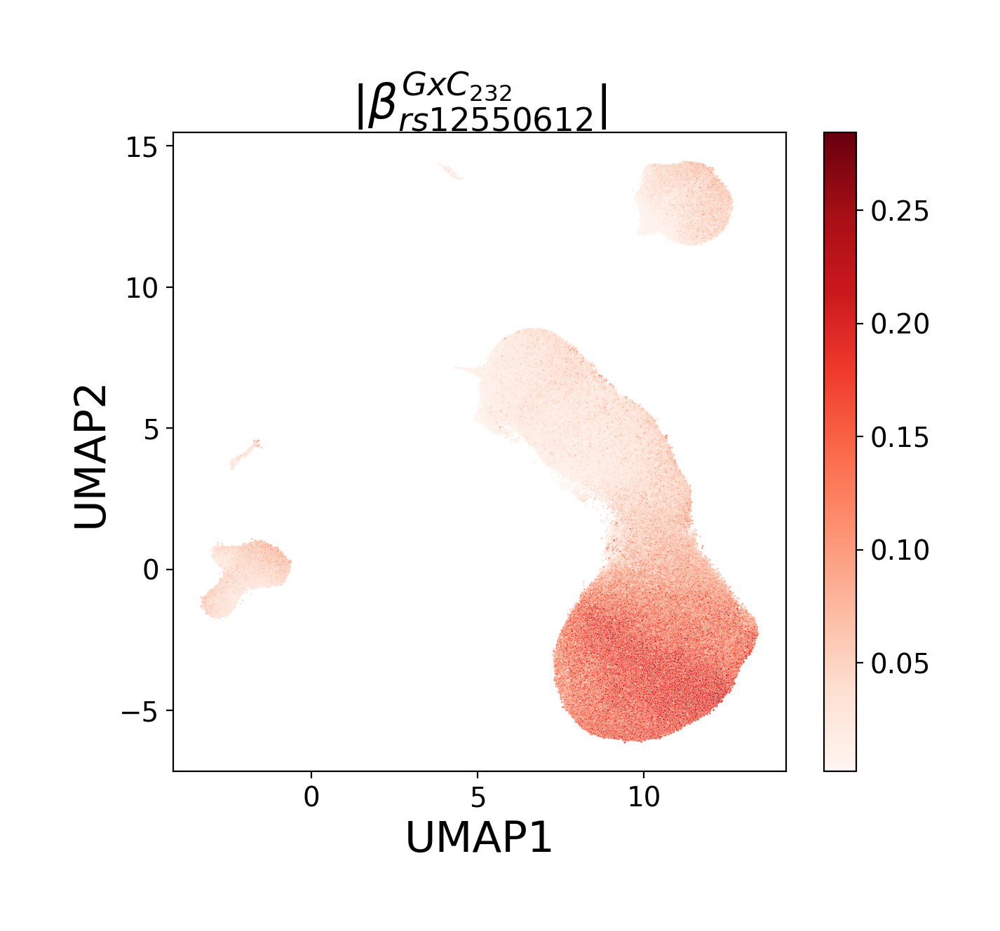

In [491]:
# Absolute effect
fig, axs = plt.subplots(figsize=(7,6))
sns.scatterplot(
    x="UMAP1",
    y="UMAP2",
    hue="GxC_Factor232",
    data=umap_base.merge(GxC_beta_softmax.abs(), right_index=True, left_index=True),
    ax=axs,
    s=1,
    palette="Reds",
    rasterized=True,
    legend=False,
)

sm = cm.ScalarMappable(
    cmap="Reds", 
    norm=colors.Normalize(
        vmin=GxC_beta_softmax["GxC_Factor232"].abs().min(),
        vmax=GxC_beta_softmax["GxC_Factor232"].abs().max(),
    ),
)
cb = plt.colorbar(sm, ax=axs)

axs.set_title(
    label=fr"$|\beta_{{{rsid}}}^{{GxC_{{232}}}}|$", fontdict={"fontsize": 24}, loc="center"
)
axs.xaxis.label.set_fontsize(22)
axs.yaxis.label.set_fontsize(22)

plt.savefig(os.path.join(model_results_dir, "Figures", f"{model}_Softmax-Absolute-SNP-effect-on-cells_U232_SNP-8-22966769_Reds-cmap.png"),
                         dpi=500, transparent=True, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", f"{model}_Softmax-Absolute-SNP-effect-on-cells_U232_SNP-8-22966769_Reds-cmap.pdf"),
                         dpi=800, transparent=True, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", f"{model}_Softmax-Absolute-SNP-effect-on-cells_U232_SNP-8-22966769_Reds-cmap.eps"),
                         dpi=600, transparent=True, bbox_inches="tight")

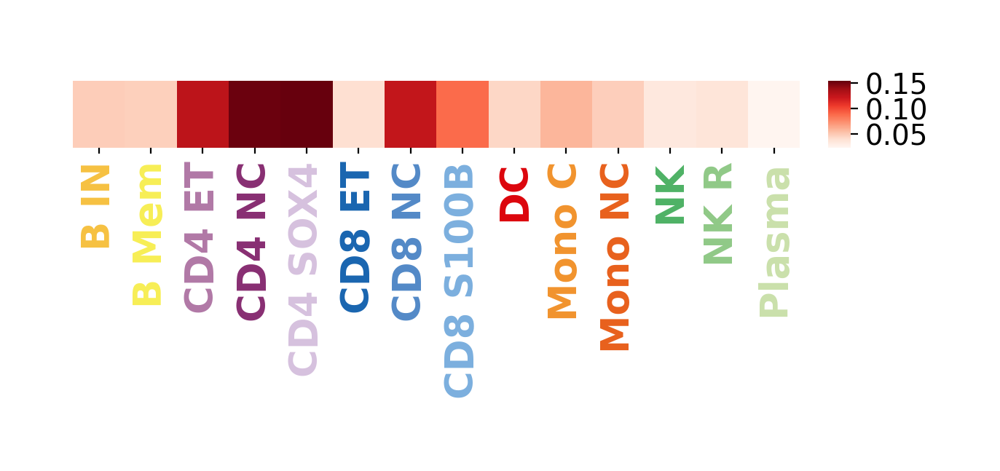

In [492]:
fig, axs = plt.subplots(figsize=(8,0.6))

sns.heatmap(GxC_beta_softmax_ct.to_frame().T, cmap="Reds", ax=axs, yticklabels=[], cbar_kws={"anchor":(-0.15,0.5), "aspect":3})

axs.set_xlabel("")
axs.xaxis.label.set_fontsize(23)
axs.tick_params(axis="x", length=3)
for j, label in enumerate(axs.get_xticklabels()):
    label.set_color(cell_label_colors[label.get_text()])
    label.set_fontweight("bold")
    label.set_fontsize(19)
    
plt.savefig(os.path.join(model_results_dir, "Figures", "GxC232_absolute-effect_celltype_heatmap_SNP-8-22966769_Reds-cmap.pdf"), 
            bbox_inches="tight", transparent=True, dpi=600)
plt.savefig(os.path.join(model_results_dir, "Figures", "GxC232_absolute-effect_celltype_heatmap_SNP-8-22966769_Reds-cmap.png"), 
            bbox_inches="tight", transparent=True, dpi=600)
plt.savefig(os.path.join(model_results_dir, "Figures", "GxC232_absolute-effect_celltype_heatmap_SNP-8-22966769_Reds-cmap.eps"), 
            bbox_inches="tight", transparent=True, dpi=600)


In [185]:
adata.obsm["X_umap"] = umap_base.loc[adata.obs.index].to_numpy()

In [200]:
sc.settings._vector_friendly = True

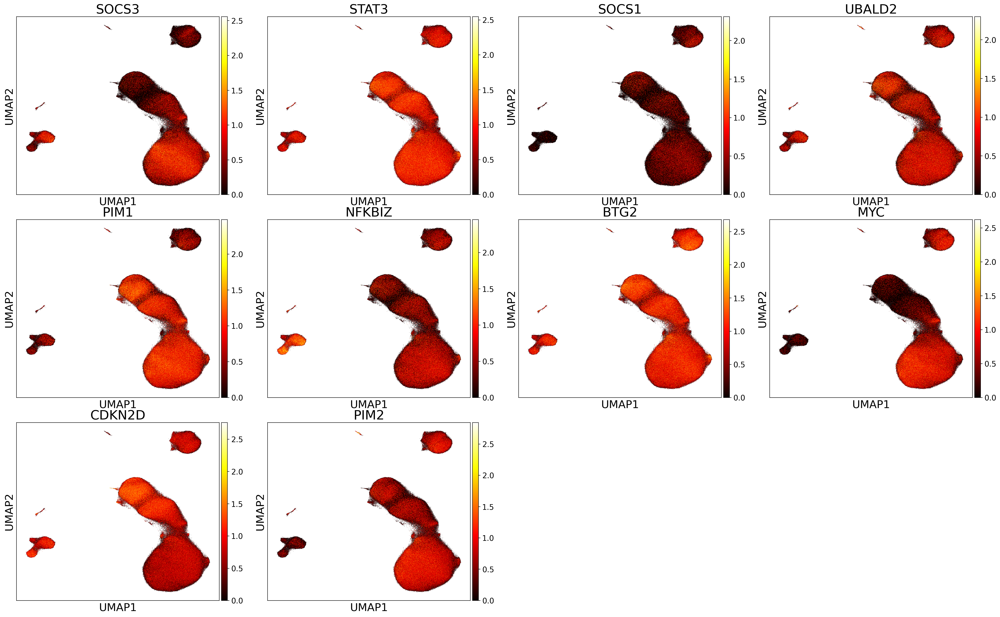

In [220]:
axs = sc.pl.umap(adata,
                 color=GxC_decoder["GxC_Factor232"].abs().nlargest(10).index, 
                 title=adata.var.loc[GxC_decoder["GxC_Factor232"].abs().nlargest(10).index].GeneSymbol, 
                 cmap="hot",
                 size=1,
                 hspace=0.14,
                 save=None,
                 show=False)

for ax in axs:
    ax.set_xlabel("UMAP1", fontsize=20)
    ax.set_ylabel("UMAP2", fontsize=20)
    ax.set_title(ax.get_title(), fontsize=24)


plt.savefig(os.path.join(model_results_dir, "Figures", f"{model}_UMAP_top10-genes-GxC232.png"), 
            bbox_inches="tight", transparent=True, dpi=400)


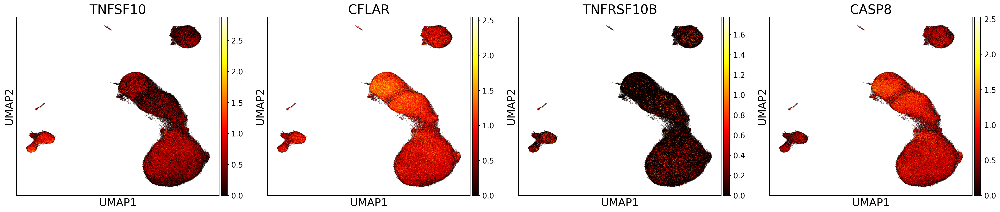

In [376]:
axs = sc.pl.umap(adata,
                 color=["ENSG00000121858", "ENSG00000003402", "ENSG00000120889", "ENSG00000064012"], 
                 title=adata.var.loc[["ENSG00000121858", "ENSG00000003402", "ENSG00000120889", "ENSG00000064012"]].GeneSymbol, 
                 cmap="hot",
                 size=1,
                 hspace=0.14,
                 save=None,
                 show=False)

for ax in axs:
    ax.set_xlabel("UMAP1", fontsize=20)
    ax.set_ylabel("UMAP2", fontsize=20)
    ax.set_title(ax.get_title(), fontsize=24)


plt.savefig(os.path.join(model_results_dir, "Figures", f"{model}_UMAP_TRAIL-CASP8-genes2.eps"), 
            bbox_inches="tight", transparent=True, dpi=400)


In [363]:
adata[:, ["ENSG00000121858", "ENSG00000003402", "ENSG00000120889", "ENSG00000064012"]].X.mean(axis=0)

matrix([[0.0618621 , 0.18103342, 0.0095519 , 0.11376279]])

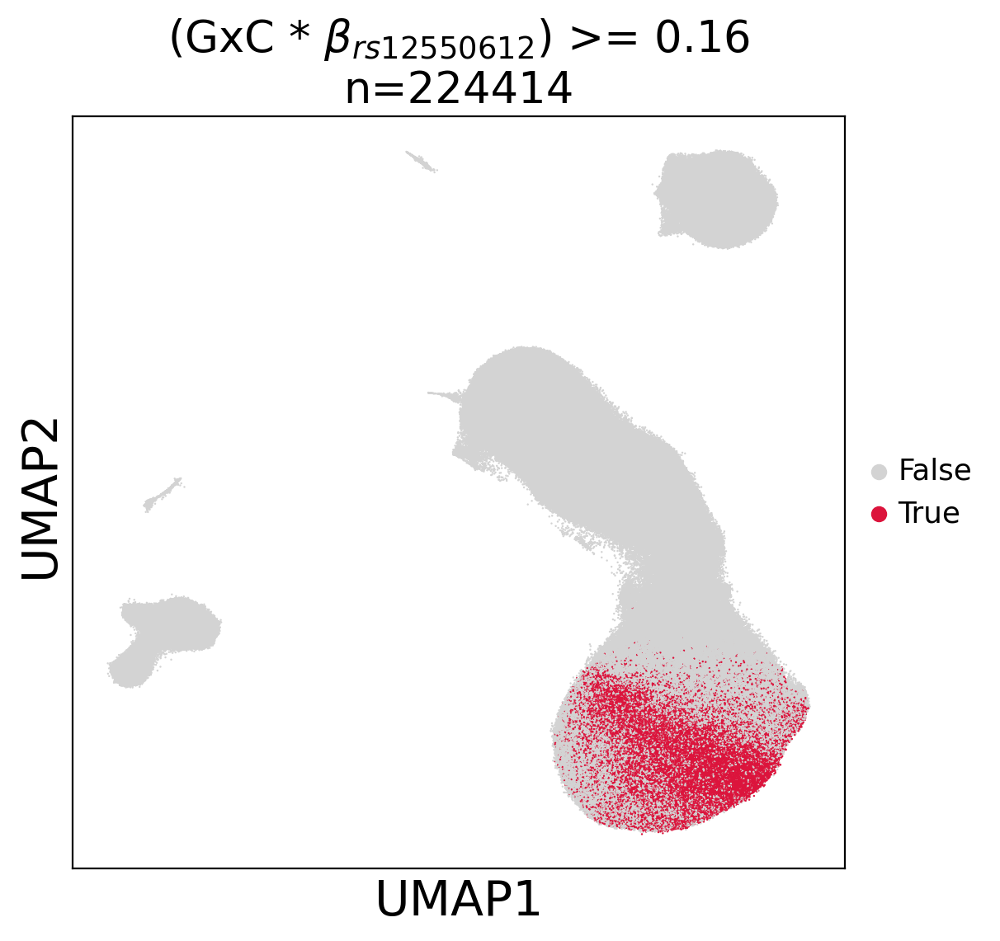

In [233]:
adata.obs = adata.obs.assign(cells2plot = [False]*adata.obs.shape[0])
adata.obs.loc[GxC_beta_softmax.loc[GxC_beta_softmax["GxC_Factor232"] >= 0.16].index, "cells2plot"] = True

fig, axs = plt.subplots(figsize=(6,6))

sc.pl.umap(adata,
           color="cells2plot", 
           title=fr"(GxC * $\beta_{{{rsid}}}$) >= 0.16"+f"\nn={GxC_beta_softmax.loc[GxC_beta_softmax['GxC_Factor232'] >= 0.16].shape[0]}",
           size=3,
           palette=["lightgrey", "crimson"],
           hspace=0.14,
           save=None,
           show=False,
           ax=axs)

axs.set_xlabel("UMAP1", fontsize=21)
axs.set_ylabel("UMAP2", fontsize=21)
axs.set_title(axs.get_title(), fontdict={"fontsize":19})

plt.savefig(os.path.join(model_results_dir, "Figures", "UMAP-cell-state_highlighted_GxC232-016-cutoff-cells.png"), 
            dpi=300, bbox_inches="tight", transparent="True")

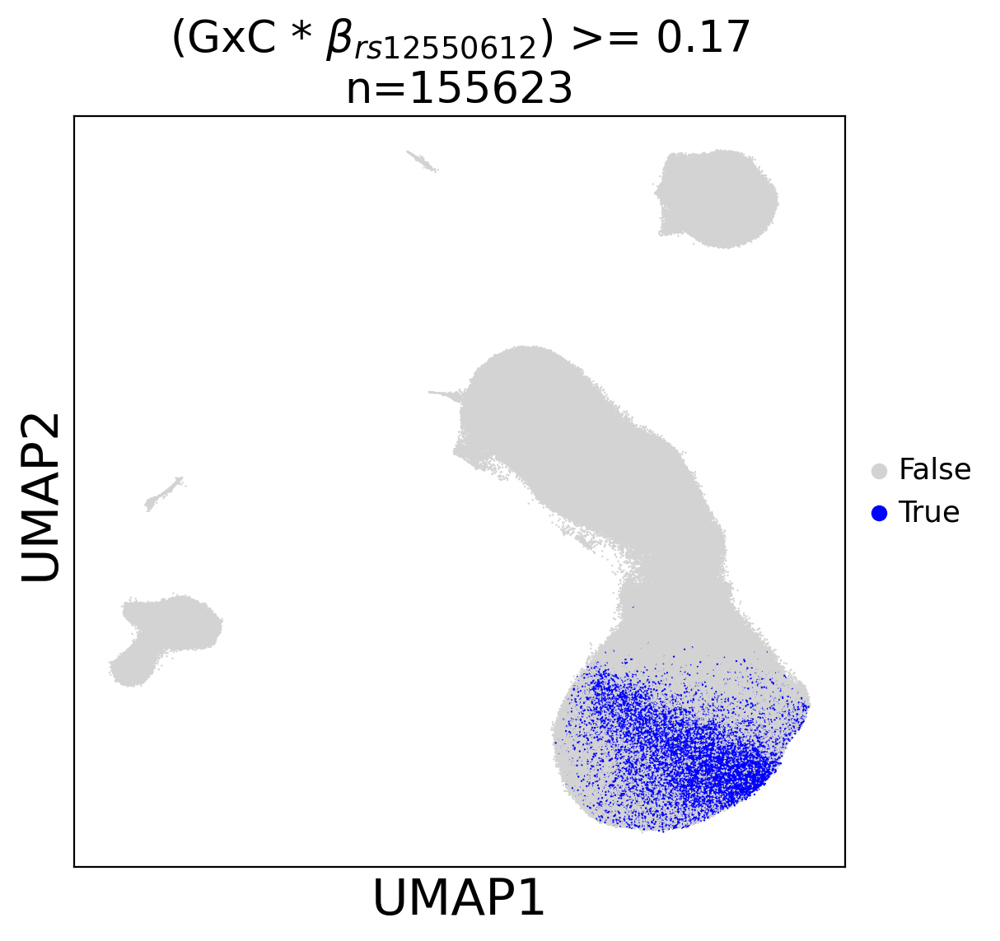

In [115]:
adata.obs = adata.obs.assign(cells2plot = [False]*adata.obs.shape[0])
adata.obs.loc[GxC_beta_softmax.loc[GxC_beta_softmax["GxC_Factor232"] >= 0.17].index, "cells2plot"] = True

fig, axs = plt.subplots(figsize=(6,6))

sc.pl.umap(adata,
           color="cells2plot", 
           title=fr"(GxC * $\beta_{{{rsid}}}$) >= 0.17"+f"\nn={GxC_beta_softmax.loc[GxC_beta_softmax['GxC_Factor232'] >= 0.17].shape[0]}",
           size=3,
           palette=["lightgrey", "blue"],
           hspace=0.14,
           save=None,
           show=False,
           ax=axs)

axs.set_xlabel("UMAP1", fontsize=22)
axs.set_ylabel("UMAP2", fontsize=22)
axs.set_title(axs.get_title(), fontdict={"fontsize":19})

plt.savefig(os.path.join(model_results_dir, "Figures", "UMAP-cell-state_highlighted_GxC232-017-cutoff-cells_blue.pdf"), 
            dpi=800, bbox_inches="tight", transparent="True")

In [389]:
adata[GxC_beta_softmax.loc[GxC_beta_softmax["GxC_Factor232"] >= 0.17].index, :].write("/data/danai/Data/OneK1K/LIVI_cells_8-22966769_GxC232_017-cutoff.h5ad")

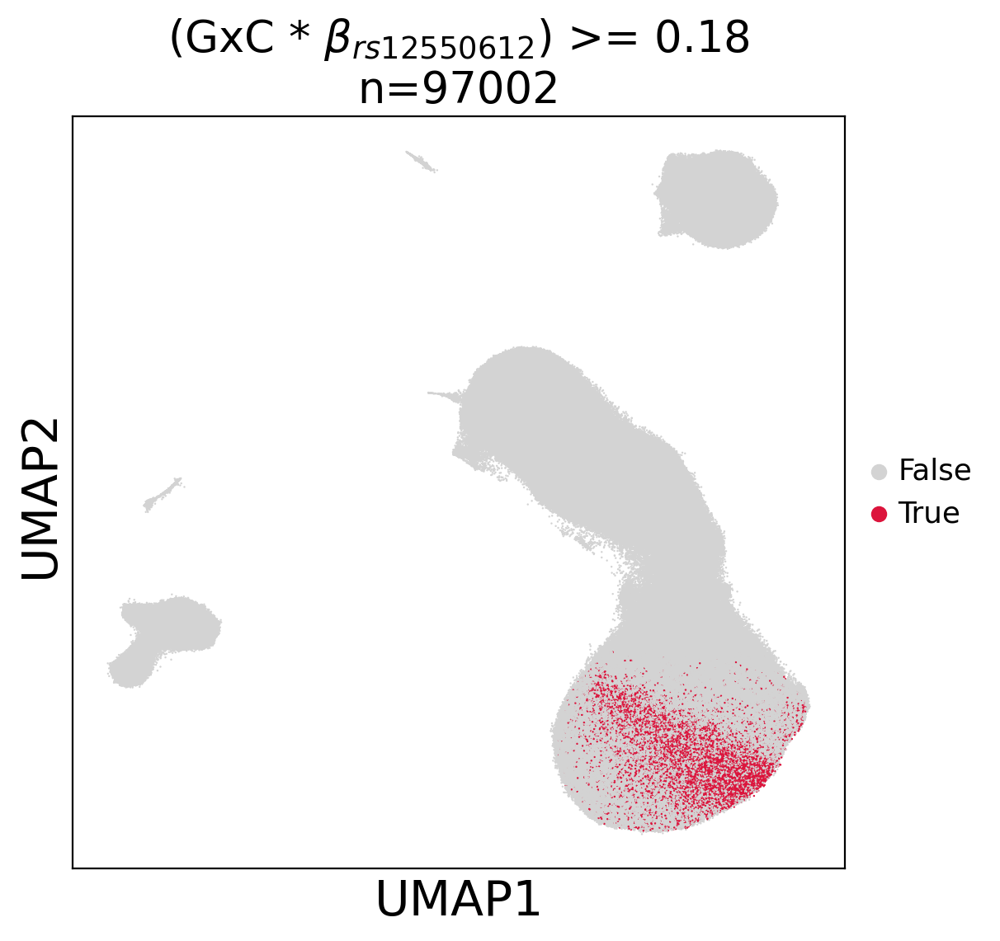

In [235]:
adata.obs = adata.obs.assign(cells2plot = [False]*adata.obs.shape[0])
adata.obs.loc[GxC_beta_softmax.loc[GxC_beta_softmax["GxC_Factor232"] >= 0.18].index, "cells2plot"] = True

fig, axs = plt.subplots(figsize=(6,6))

sc.pl.umap(adata,
           color="cells2plot", 
           title=fr"(GxC * $\beta_{{{rsid}}}$) >= 0.18"+f"\nn={GxC_beta_softmax.loc[GxC_beta_softmax['GxC_Factor232'] >= 0.18].shape[0]}",
           size=3,
           palette=["lightgrey", "crimson"],
           hspace=0.14,
           save=None,
           show=False,
           ax=axs)

axs.set_xlabel("UMAP1", fontsize=21)
axs.set_ylabel("UMAP2", fontsize=21)
axs.set_title(axs.get_title(), fontdict={"fontsize":19})

plt.savefig(os.path.join(model_results_dir, "Figures", "UMAP-cell-state_highlighted_GxC232-018-cutoff-cells.png"), 
            dpi=300, bbox_inches="tight", transparent="True")

In [194]:
adata[GxC_beta_softmax.loc[GxC_beta_softmax["GxC_Factor232"] >= 0.18].index, :].write("/data/danai/Data/OneK1K/LIVI_cells_8-22966769_GxC232_018-cutoff.h5ad")

In [75]:
adata.obs.loc[GxC_beta_softmax.loc[GxC_beta_softmax["GxC_Factor232"] < 0.1].index].cell_label.value_counts()

cell_label
CD8 ET       190773
NK           155217
B IN          72091
B Mem         45043
Mono C        37351
CD8 NC        32892
CD4 NC        29101
CD8 S100B     20684
Mono NC       15067
CD4 ET        11524
NK R           9488
DC             8133
Plasma         3583
CD4 SOX4        257
Name: count, dtype: int64

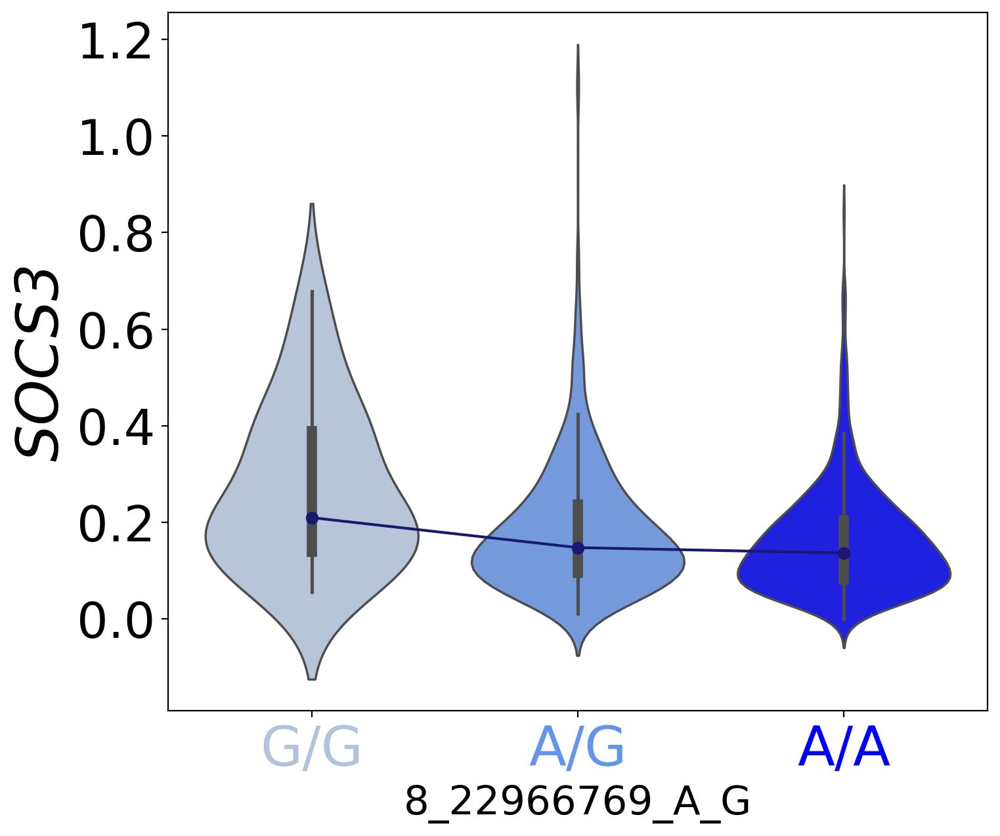

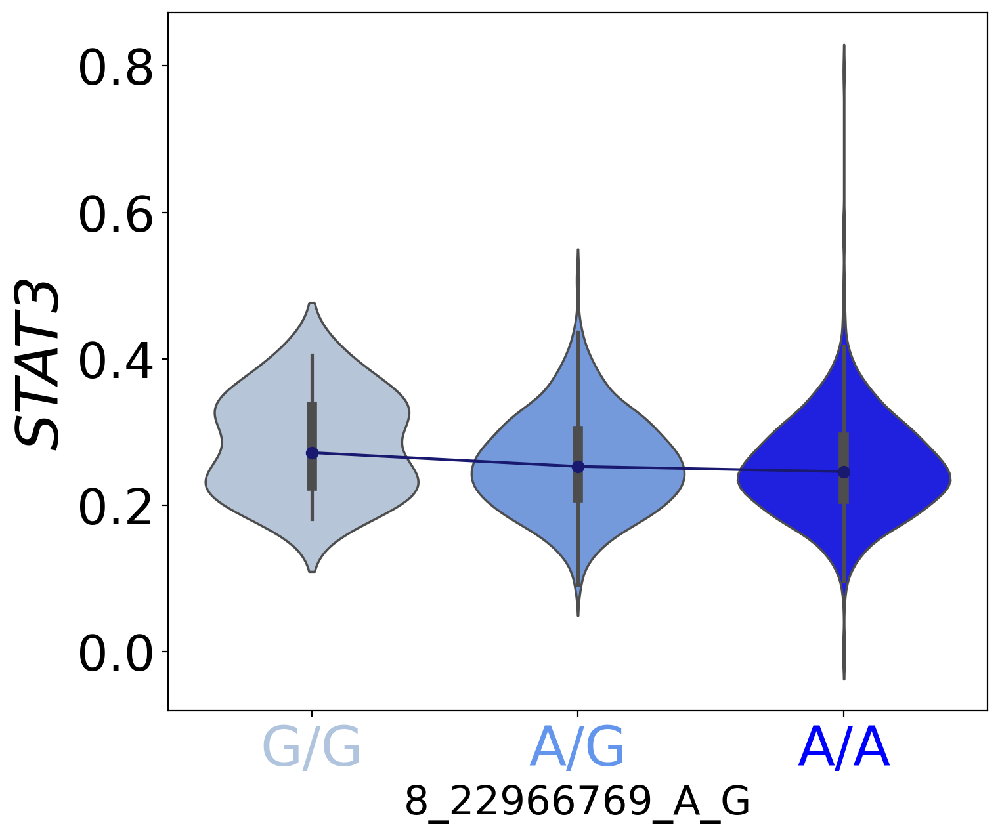

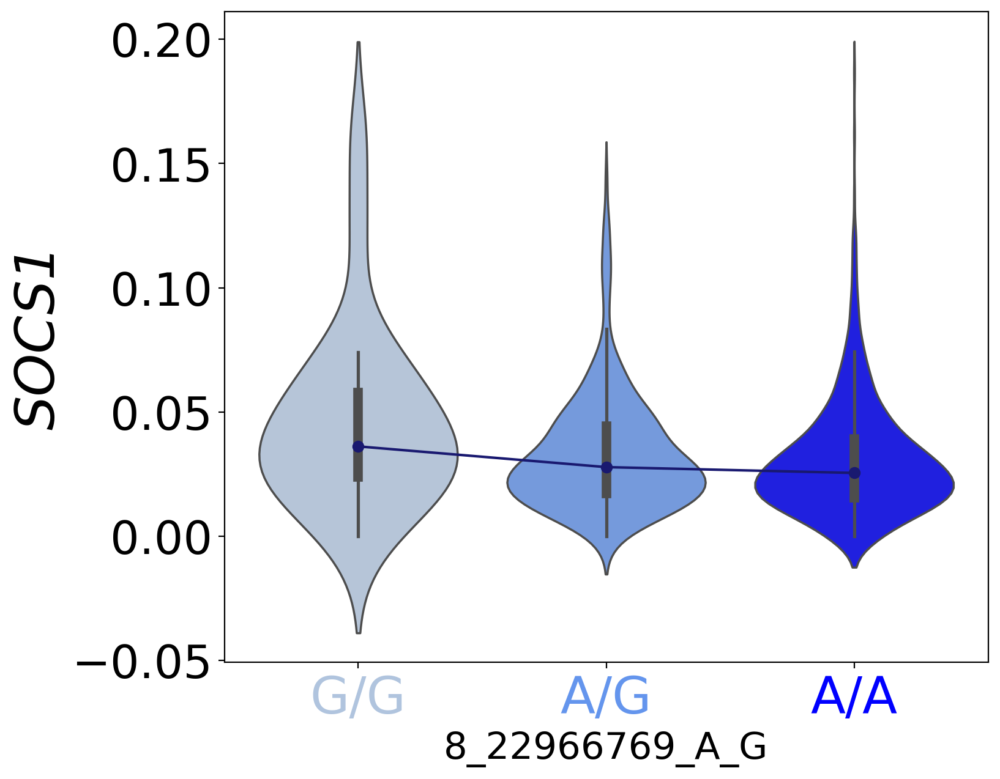

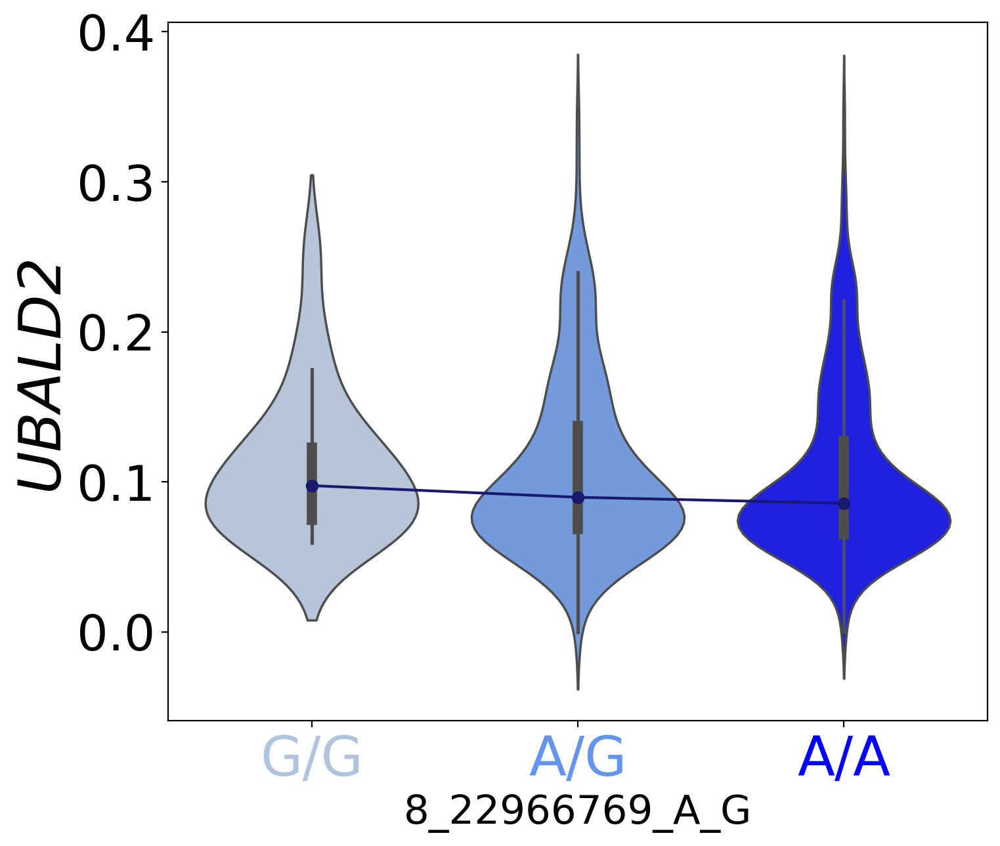

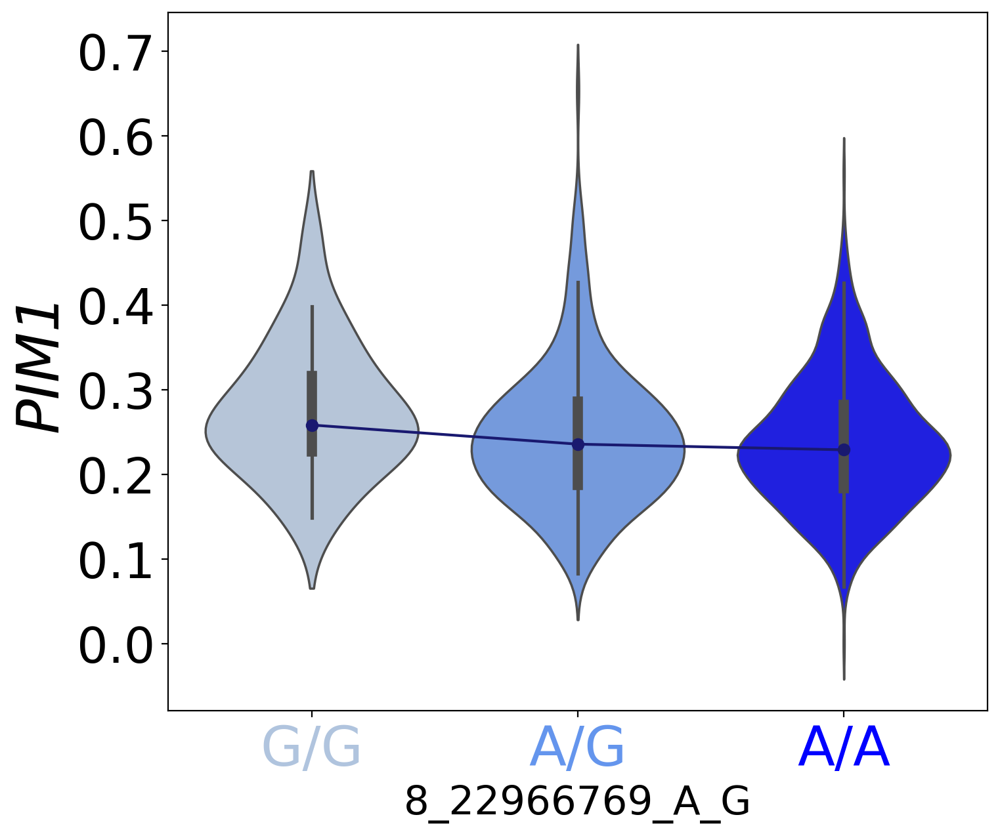

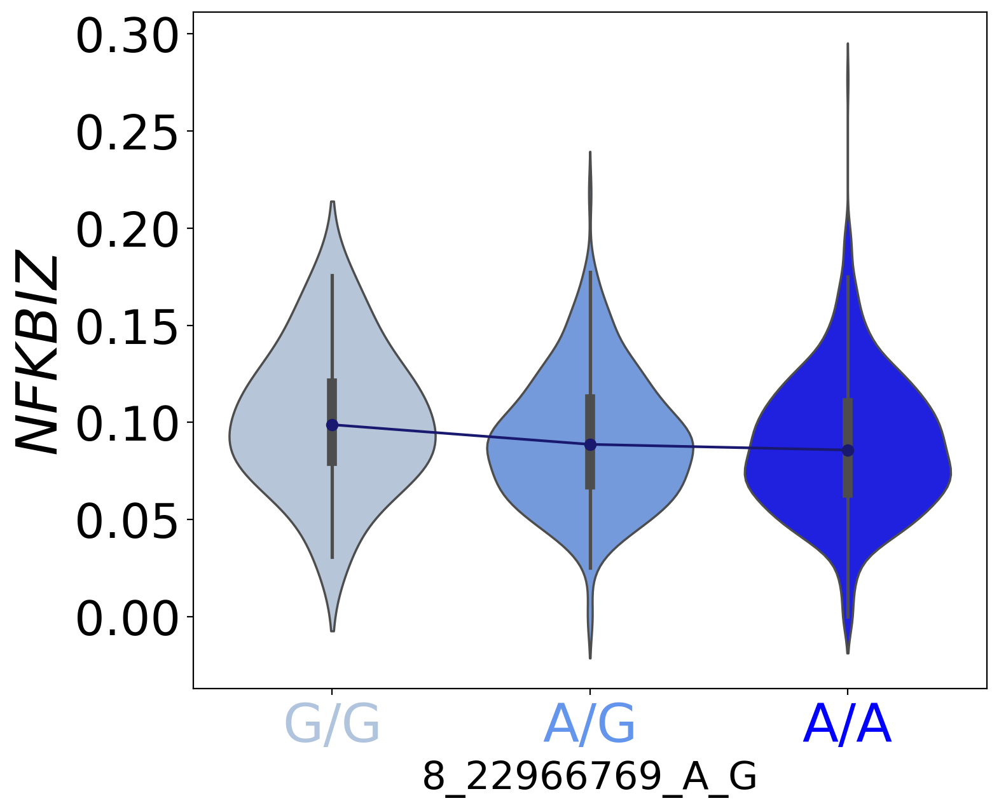

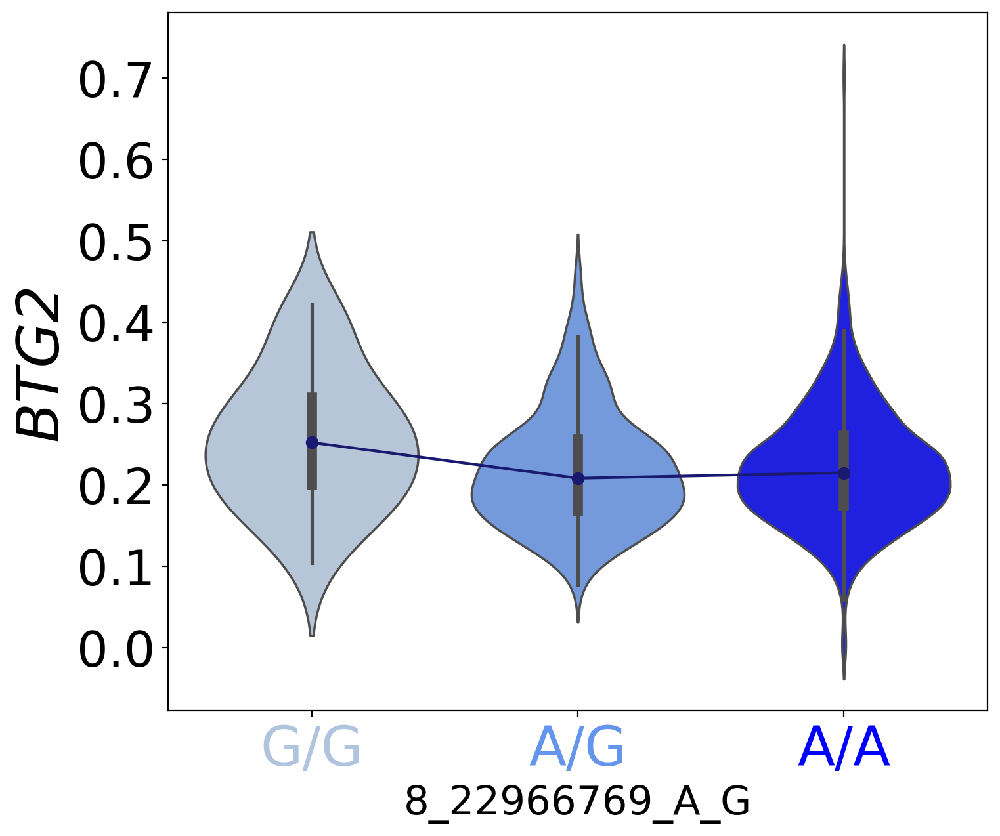

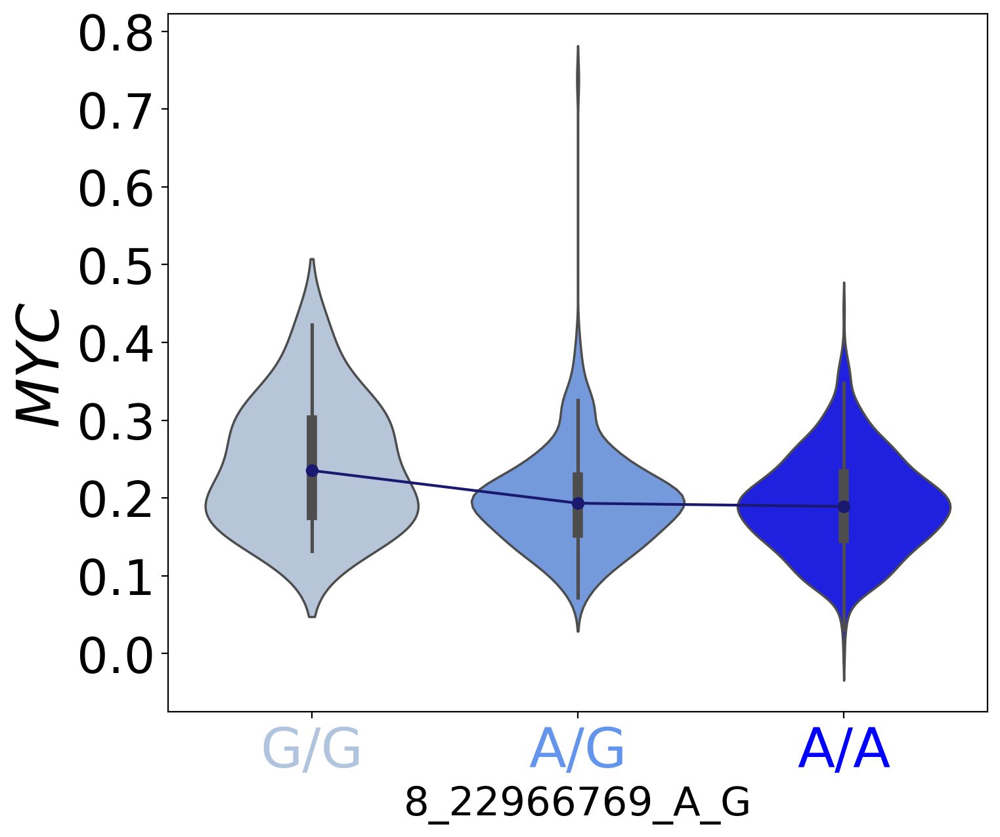

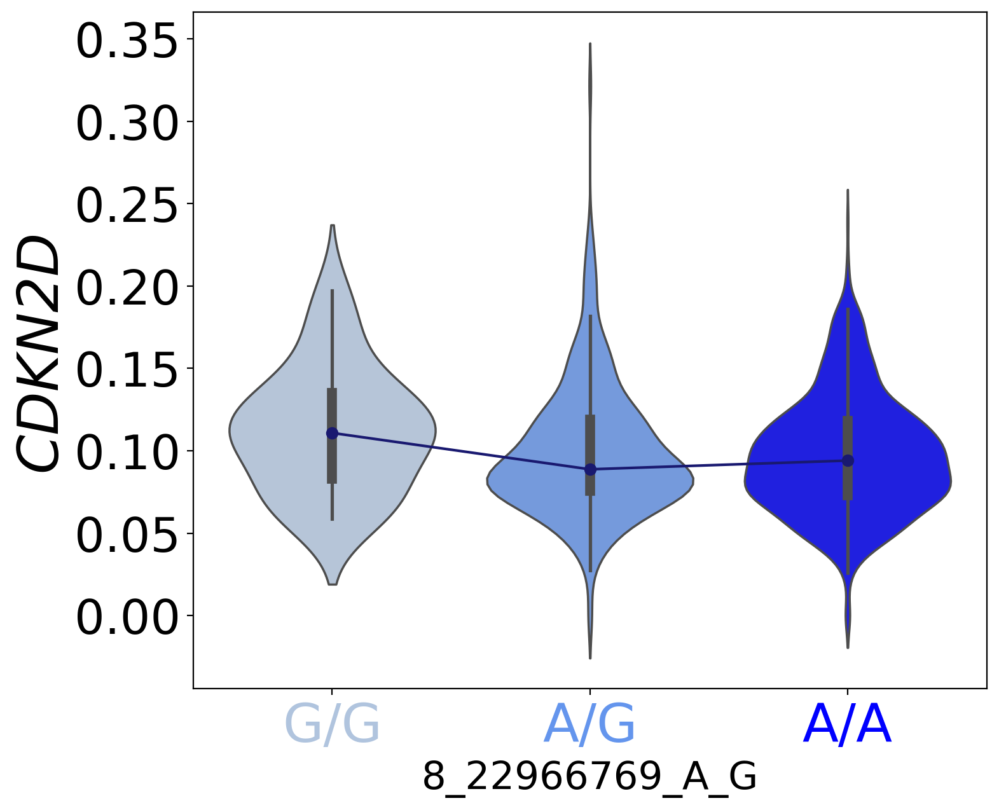

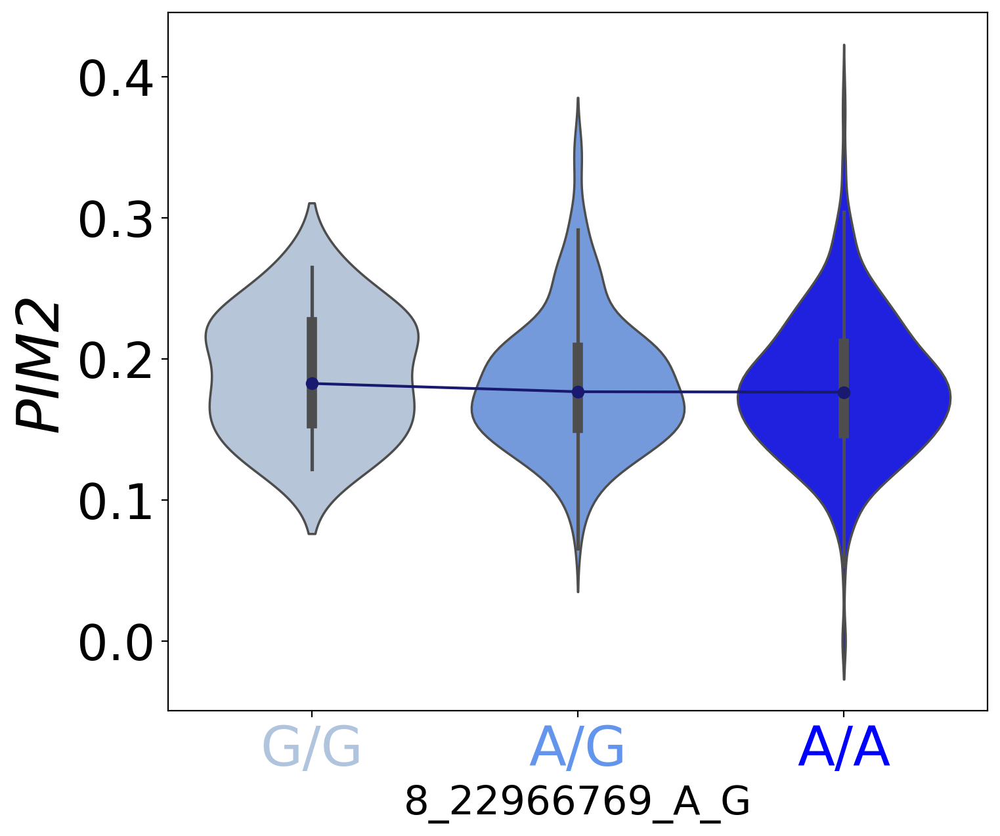

In [56]:
for g in GxC_decoder["GxC_Factor232"].abs().nlargest(10).index:
    plot_ct_gex_vs_gt(
        adata=adata,
        gene=g,
        filter_maf=False,
        test_gt_groups=False,
        annotation_fontsize=30,
        cell_indices=GxC_beta_softmax.loc[GxC_beta_softmax["GxC_Factor232"] >= 0.17].index,
        celltype=None,
        celltype_column="cell_label",
        iid_column="individual",
        GT_matrix=GT_matrix,
        SNP_id=SNP_dict_inv["8:22966769"],
        GxC_associations = GxC_effects,
        hgnc_column="GeneSymbol",
        savefig=True,
        output_dir=os.path.join(model_results_dir, "Figures"),
        output_prefix="Softmax-GxC-beta-232-017-cutoff_WO-Mann-Whitney",
        format="png",
    )

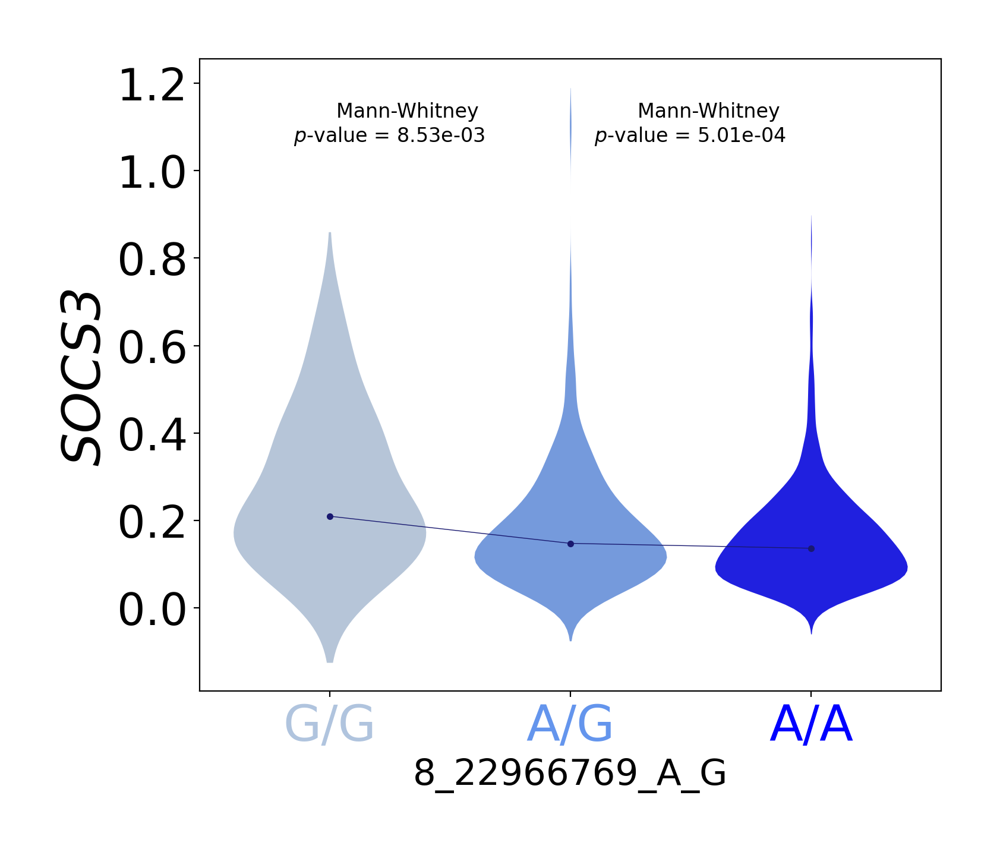

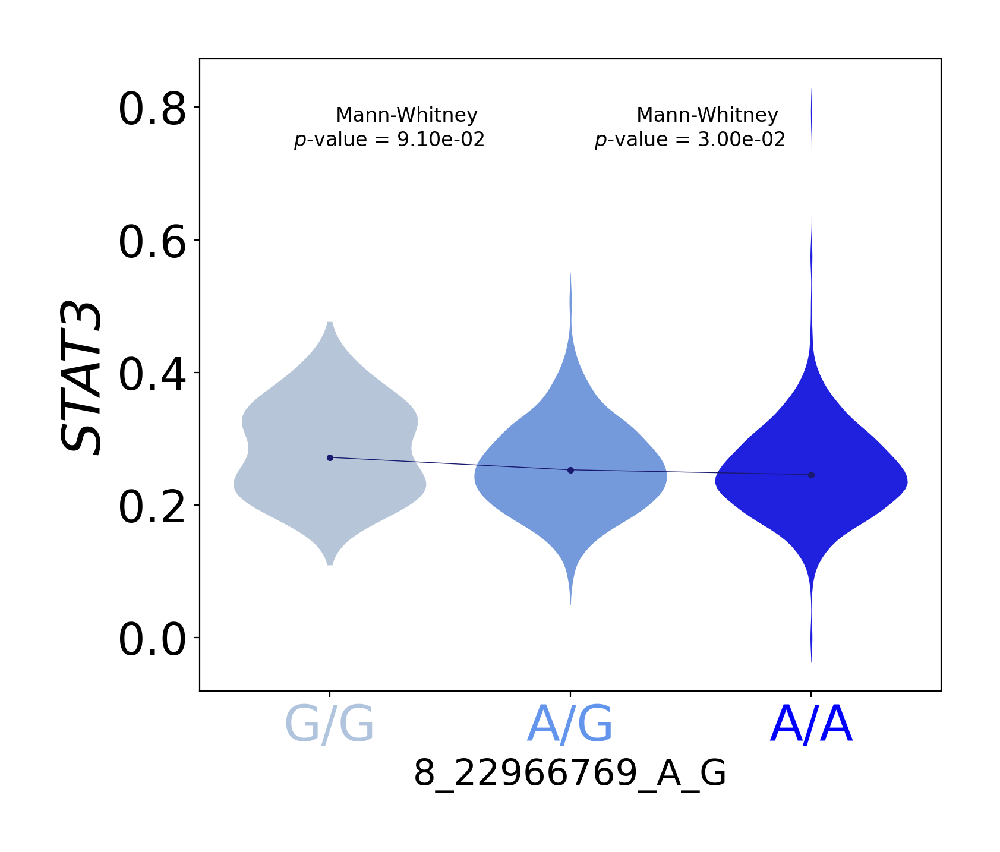

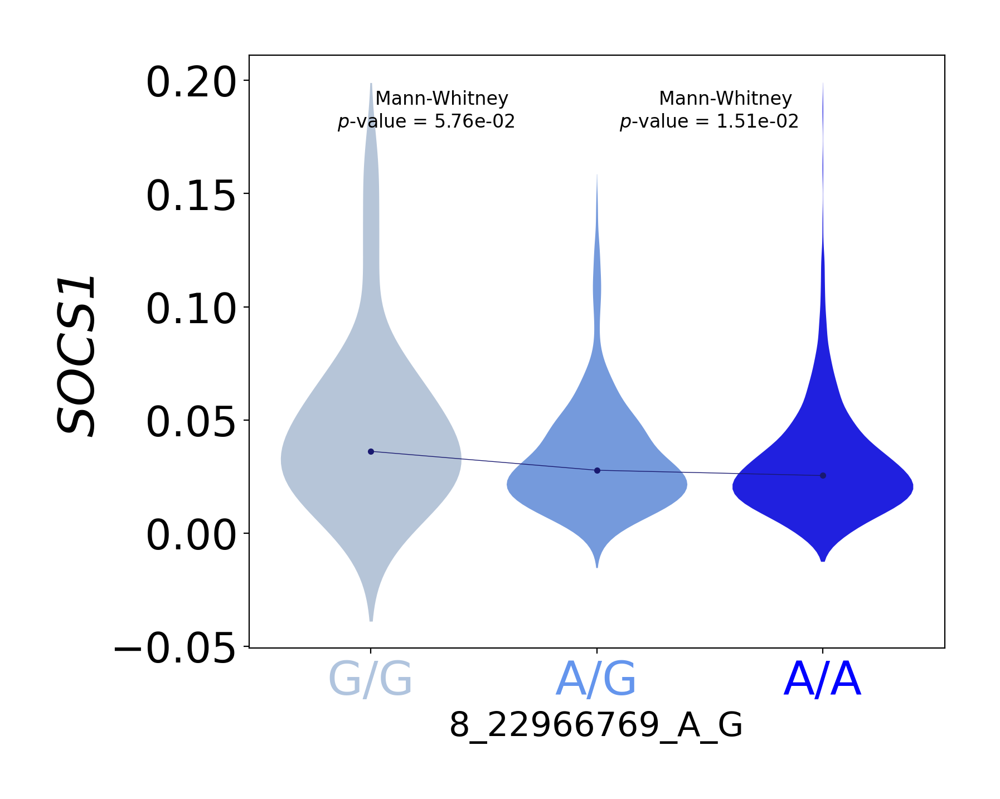

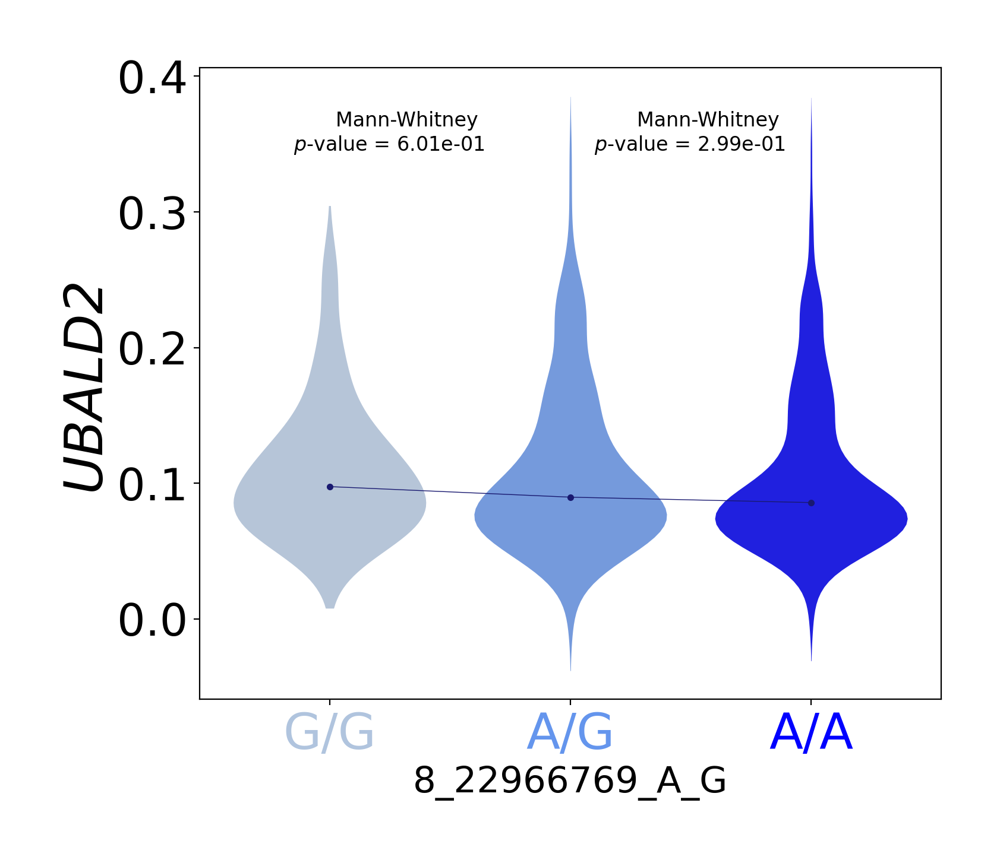

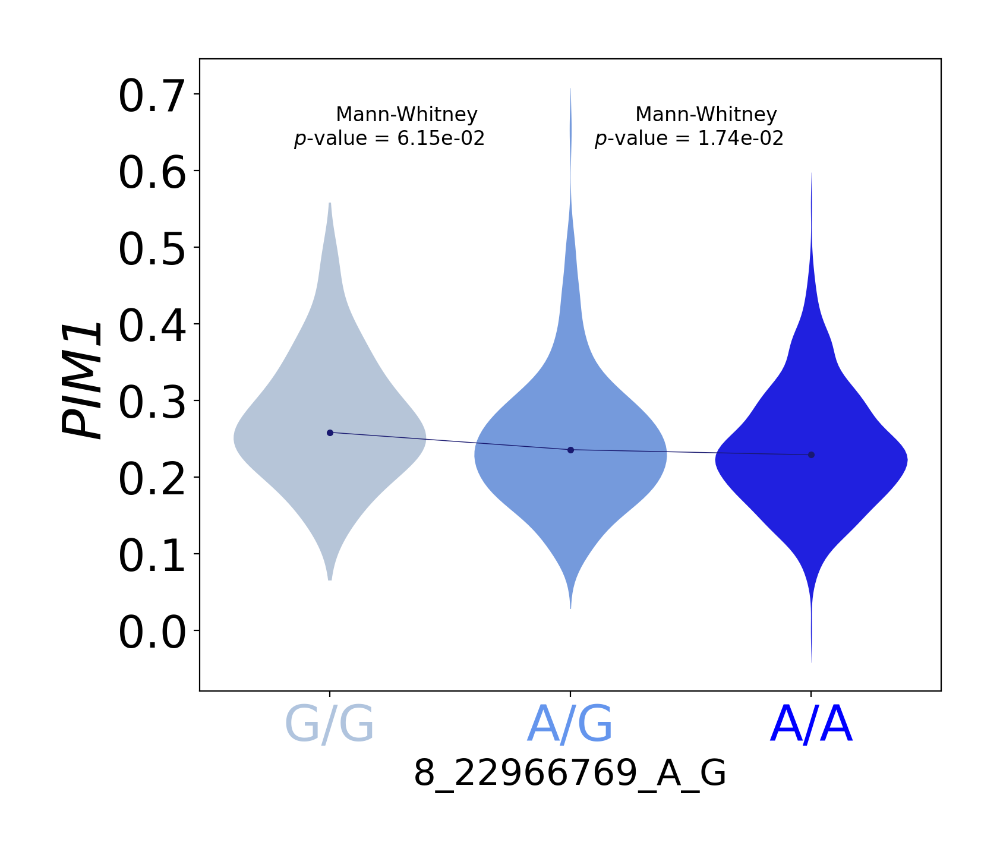

In [490]:
for g in GxC_decoder["GxC_Factor232"].abs().nlargest(5).index:
    plot_ct_gex_vs_gt(
        adata=adata,
        gene=g,
        filter_maf=False,
        annotation_fontsize=30,
        cell_indices=GxC_beta_softmax.loc[GxC_beta_softmax["GxC_Factor232"] >= 0.17].index,
        celltype=None,
        celltype_column="cell_label",
        iid_column="individual",
        GT_matrix=GT_matrix,
        SNP_id=SNP_dict_inv["8:22966769"],
        GxC_associations = GxC_effects,
        hgnc_column="GeneSymbol",
        savefig=True,
        output_dir=os.path.join(model_results_dir, "Figures"),
        output_prefix="Softmax-GxC-beta-232-017-cutoff",
        format="png",
    )

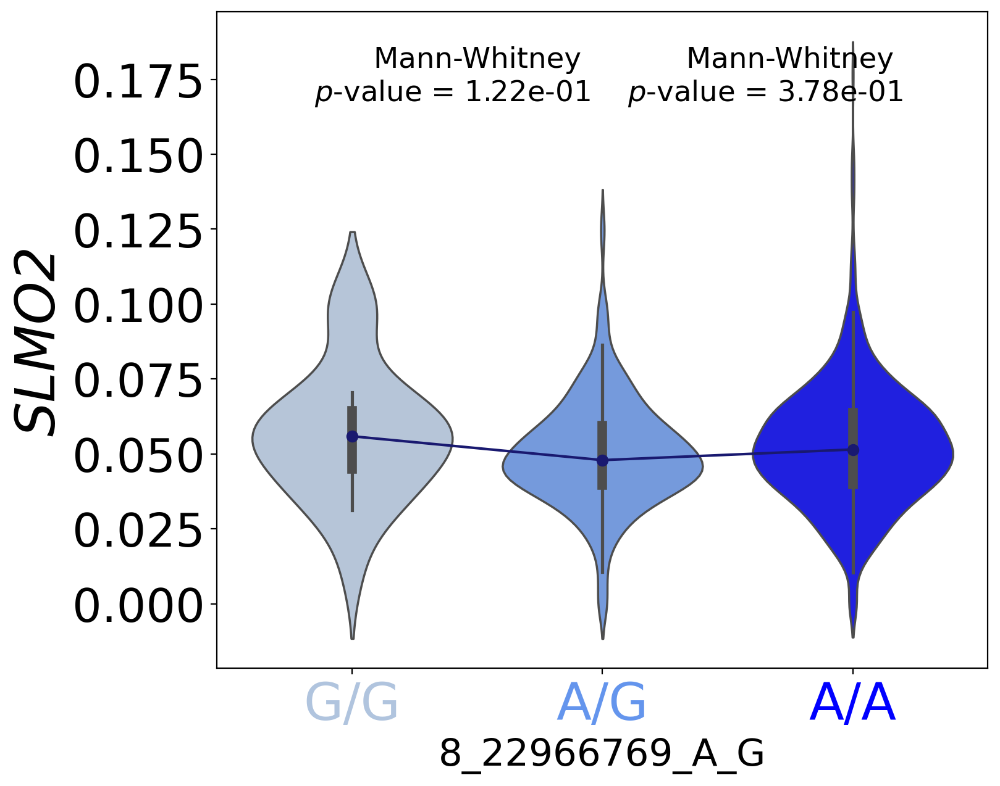

In [63]:
plot_ct_gex_vs_gt(
    adata=adata,
    gene="ENSG00000101166",
    filter_maf=False,
    test_gt_groups=True,
    annotation_fontsize=30,
    cell_indices=GxC_beta_softmax.loc[GxC_beta_softmax["GxC_Factor232"] >= 0.17].index,
    celltype=None,
    celltype_column="cell_label",
    iid_column="individual",
    GT_matrix=GT_matrix,
    SNP_id=SNP_dict_inv["8:22966769"],
    GxC_associations = GxC_effects,
    hgnc_column="GeneSymbol",
    savefig=True,
    output_dir=os.path.join(model_results_dir, "Figures"),
    output_prefix="Softmax-GxC-beta-232-017-cutoff",
    format="png",
)

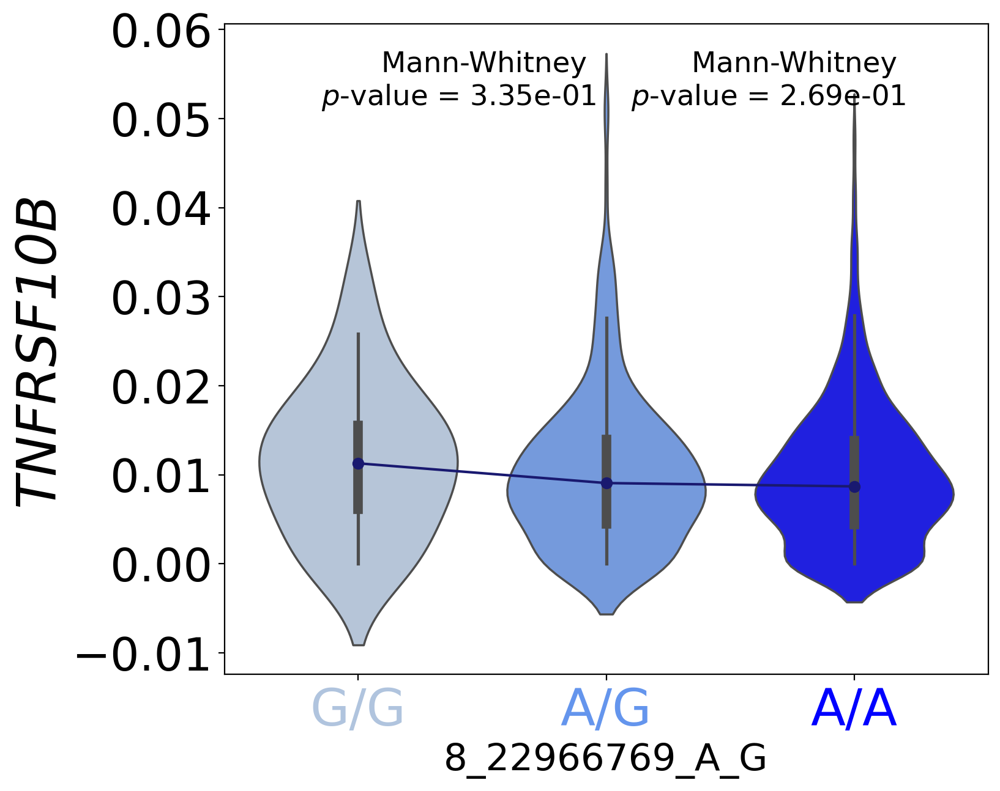

In [73]:
plot_ct_gex_vs_gt(
    adata=adata,
    gene="ENSG00000120889",
    filter_maf=False,
    annotation_fontsize=30,
    cell_indices=GxC_beta_softmax.loc[GxC_beta_softmax["GxC_Factor232"] >= 0.17].index,
    celltype=None,
    celltype_column="cell_label",
    iid_column="individual",
    GT_matrix=GT_matrix,
    SNP_id=SNP_dict_inv["8:22966769"],
    GxC_associations = GxC_effects,
    hgnc_column="GeneSymbol",
    savefig=True,
    output_dir=os.path.join(model_results_dir, "Figures"),
    output_prefix="Softmax-GxC-beta-232-017-cutoff",
    format="png",
)

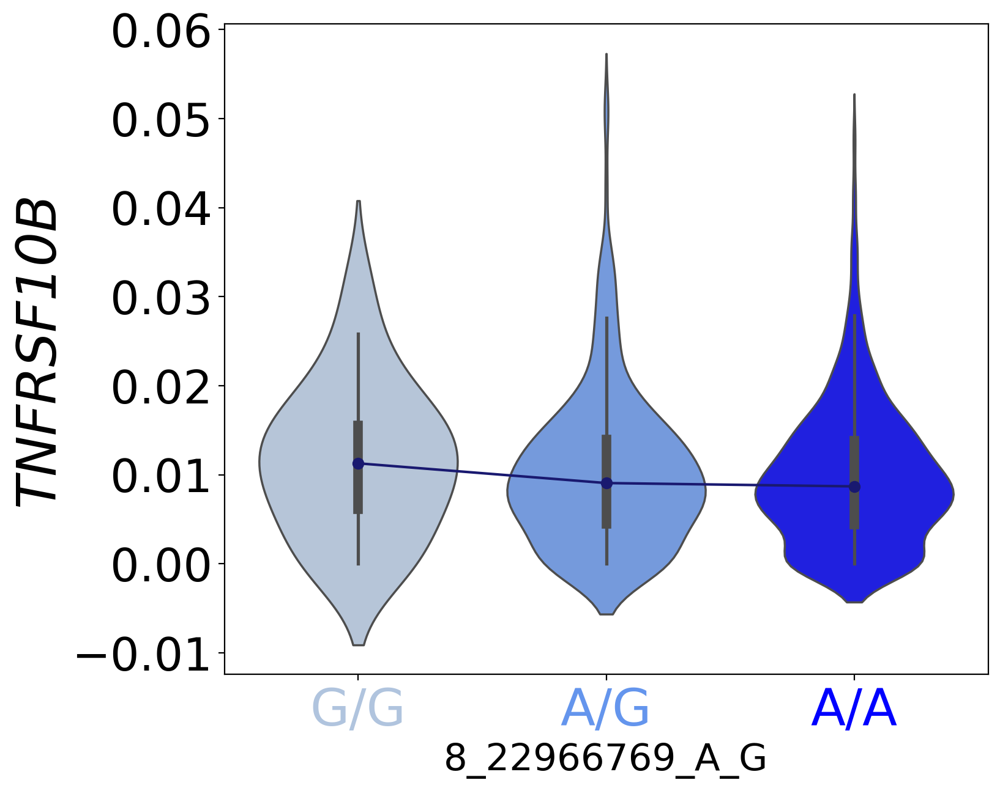

In [74]:
plot_ct_gex_vs_gt(
    adata=adata,
    gene="ENSG00000120889",
    filter_maf=False,
    test_gt_groups=False,
    annotation_fontsize=30,
    cell_indices=GxC_beta_softmax.loc[GxC_beta_softmax["GxC_Factor232"] >= 0.17].index,
    celltype=None,
    celltype_column="cell_label",
    iid_column="individual",
    GT_matrix=GT_matrix,
    SNP_id=SNP_dict_inv["8:22966769"],
    GxC_associations = GxC_effects,
    hgnc_column="GeneSymbol",
    savefig=True,
    output_dir=os.path.join(model_results_dir, "Figures"),
    output_prefix="Softmax-GxC-beta-232-017-cutoff_WO-Mann-Whitney",
    format="png",
)

### Effect on genes 

In [92]:
effect_on_genes = calculate_GxC_gene_effect(
    GxC_associations = GxC_effects,
    SNP_id = SNP_dict_inv["8:22966769"],
    cell_state_latent = zbase,
    A = assignment_matrix,
    GxC_decoder = GxC_decoder.loc[GxC_decoder["GxC_Factor232"].abs().nlargest(17).index],
    factor_id = "U_Factor232"
)
effect_on_genes = effect_on_genes.merge(adata.obs.cell_label, right_index=True, left_index=True)
effect_on_genes.head()

,ENSG00000184557,ENSG00000168610,ENSG00000185338,ENSG00000185262,ENSG00000137193,ENSG00000144802,ENSG00000159388,ENSG00000136997,ENSG00000129355,ENSG00000102096,ENSG00000168209,ENSG00000134333,ENSG00000198355,ENSG00000059804,ENSG00000062716,ENSG00000157514,ENSG00000057657,cell_label
barcode,,,,,,,,,,,,,,,,,,
AAACCTGAGAATGTTG-1,-0.039044,-0.021264,-0.012950,-0.012904,-0.012411,-0.011870,-0.011792,-0.011436,-0.011236,-0.009818,-0.009182,-0.008445,-0.008293,-0.007992,-0.007916,0.007868,-0.005705,CD4 ET
AAACCTGAGAGAACAG-1,-0.016390,-0.008926,-0.005436,-0.005417,-0.005210,-0.004983,-0.004950,-0.004800,-0.004717,-0.004122,-0.003854,-0.003545,-0.003481,-0.003355,-0.003323,0.003303,-0.002395,NK
AAACCTGAGCATGGCA-1,-0.038731,-0.021093,-0.012847,-0.012801,-0.012311,-0.011774,-0.011697,-0.011344,-0.011146,-0.009740,-0.009109,-0.008377,-0.008226,-0.007928,-0.007852,0.007805,-0.005659,CD4 NC
AAACCTGAGTATTGGA-1,-0.027424,-0.014935,-0.009096,-0.009064,-0.008717,-0.008337,-0.008282,-0.008032,-0.007892,-0.006896,-0.006449,-0.005932,-0.005825,-0.005613,-0.005560,0.005526,-0.004007,CD8 S100B
AAACCTGAGTGTCCCG-1,-0.012983,-0.007071,-0.004306,-0.004291,-0.004127,-0.003947,-0.003921,-0.003803,-0.003736,-0.003265,-0.003053,-0.002808,-0.002758,-0.002658,-0.002632,0.002616,-0.001897,CD8 ET


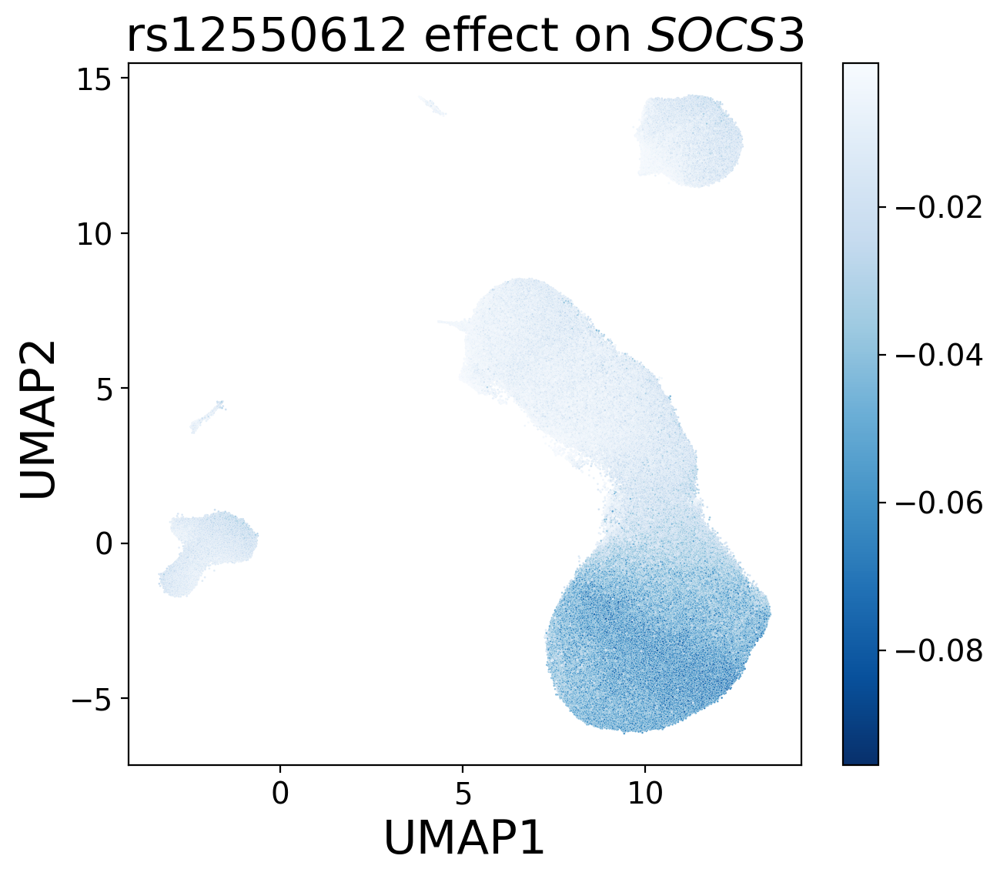

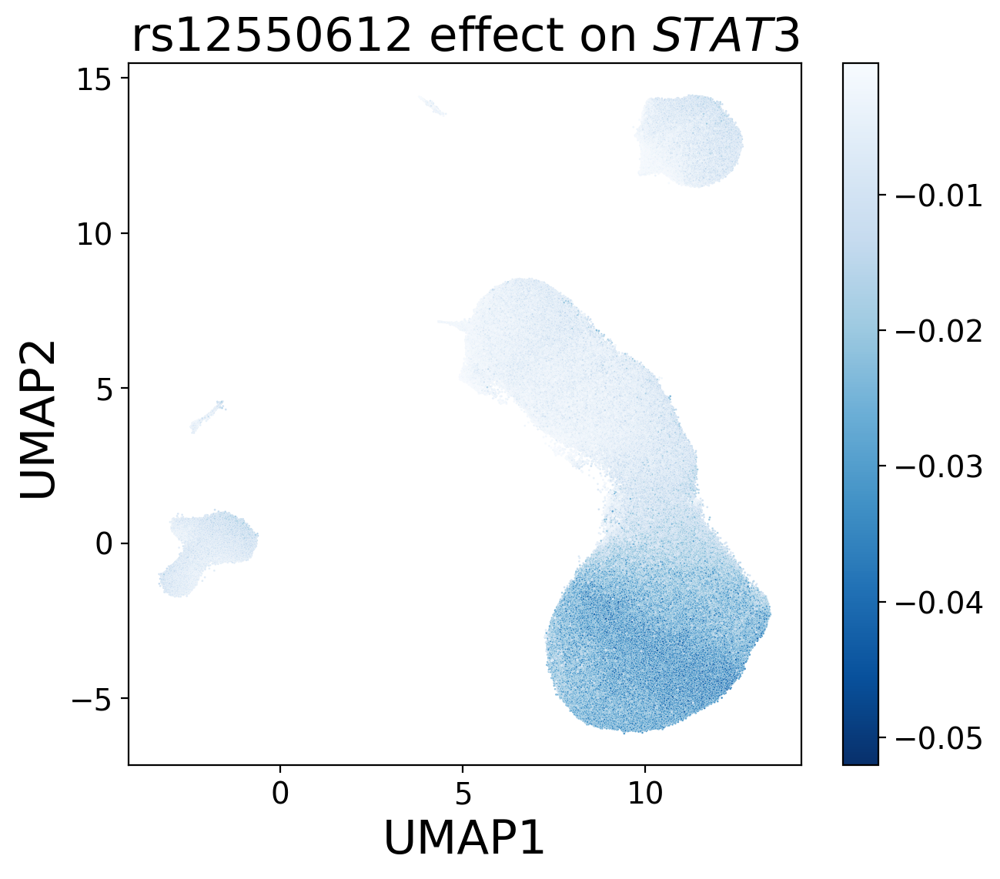

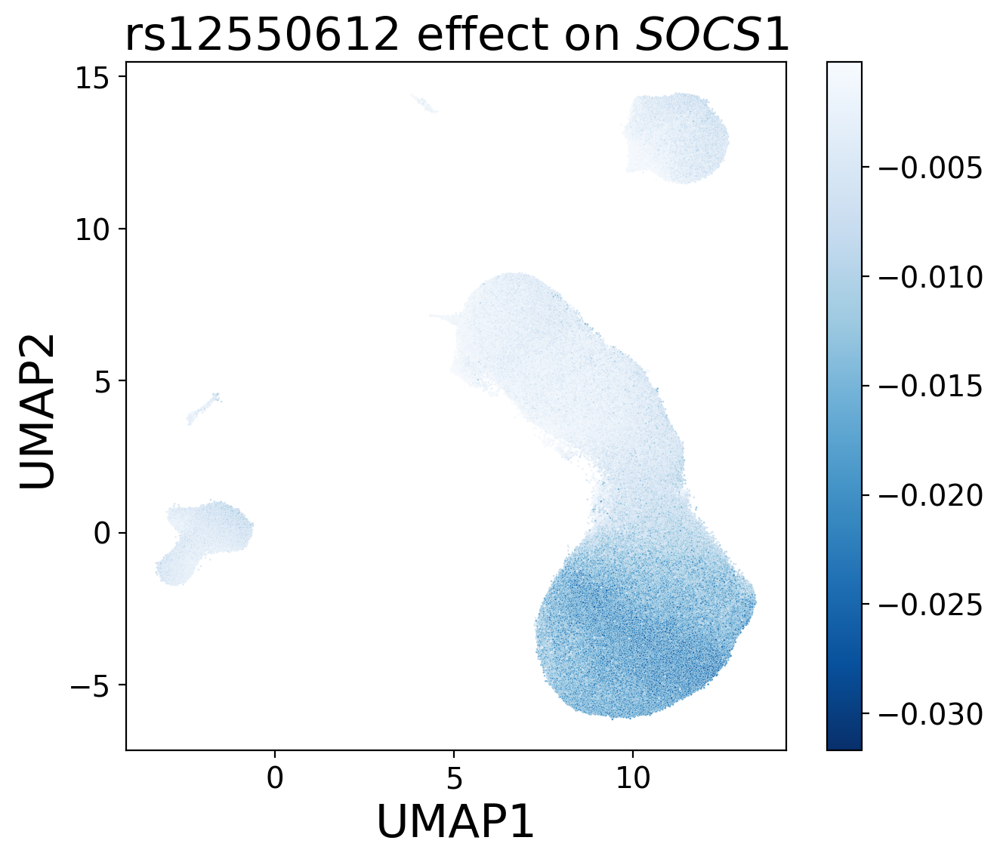

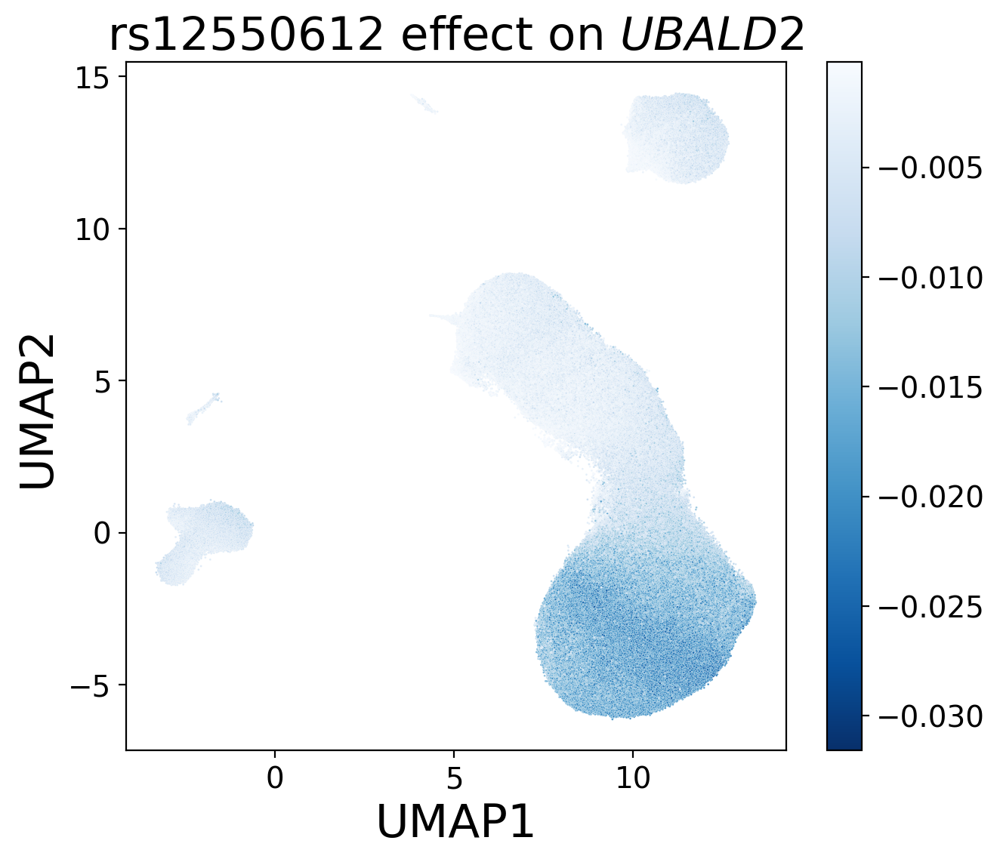

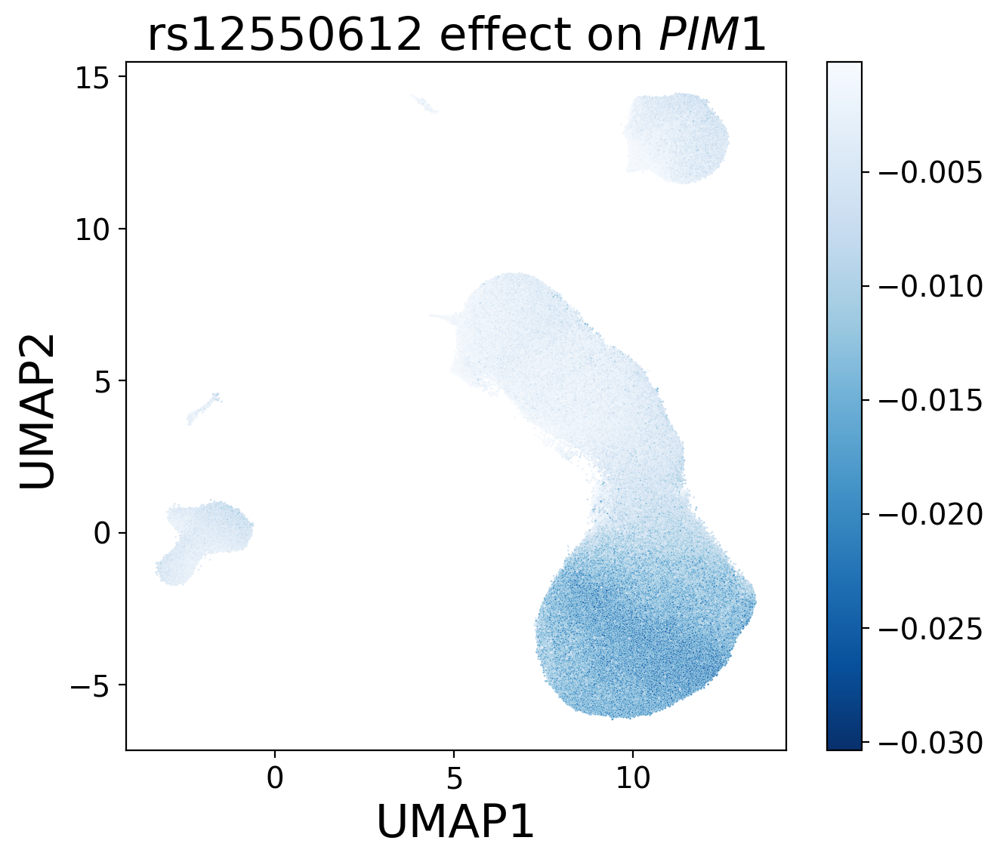

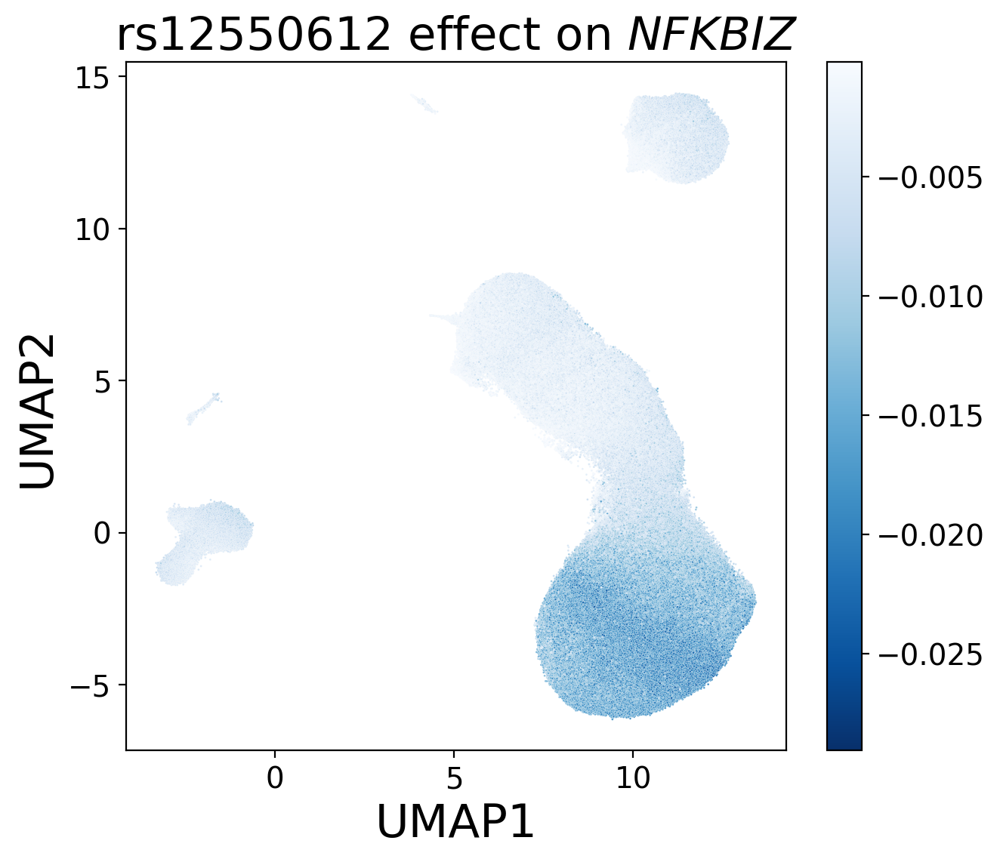

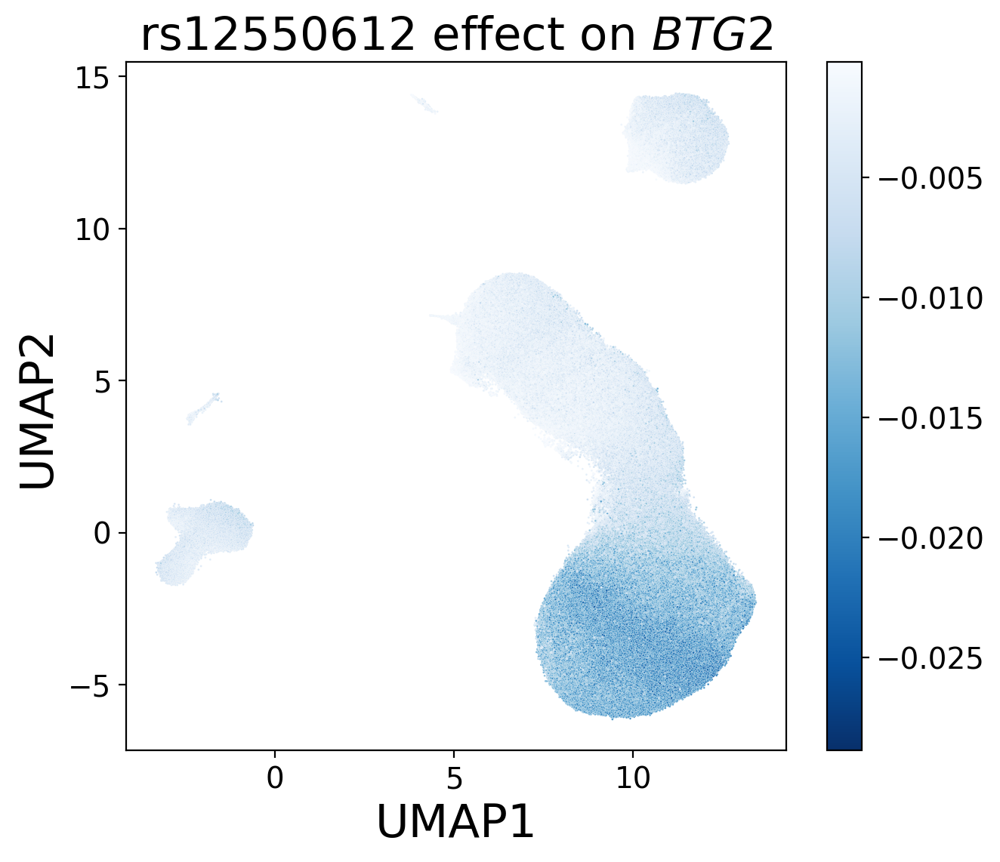

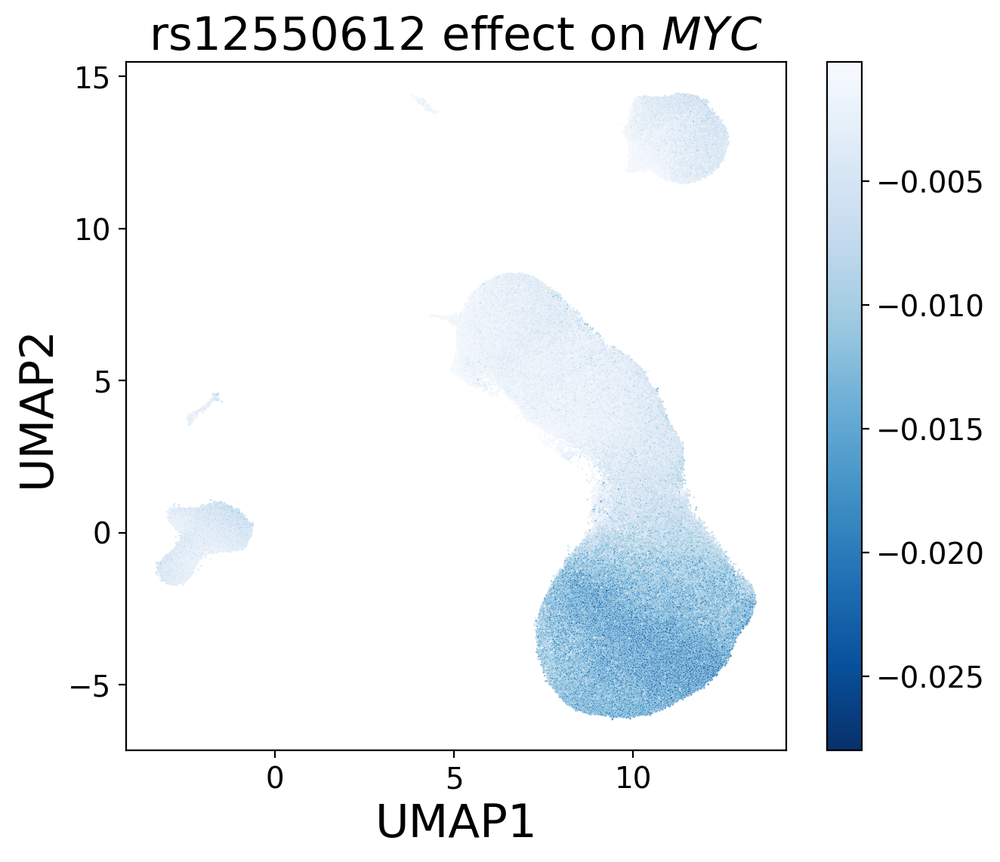

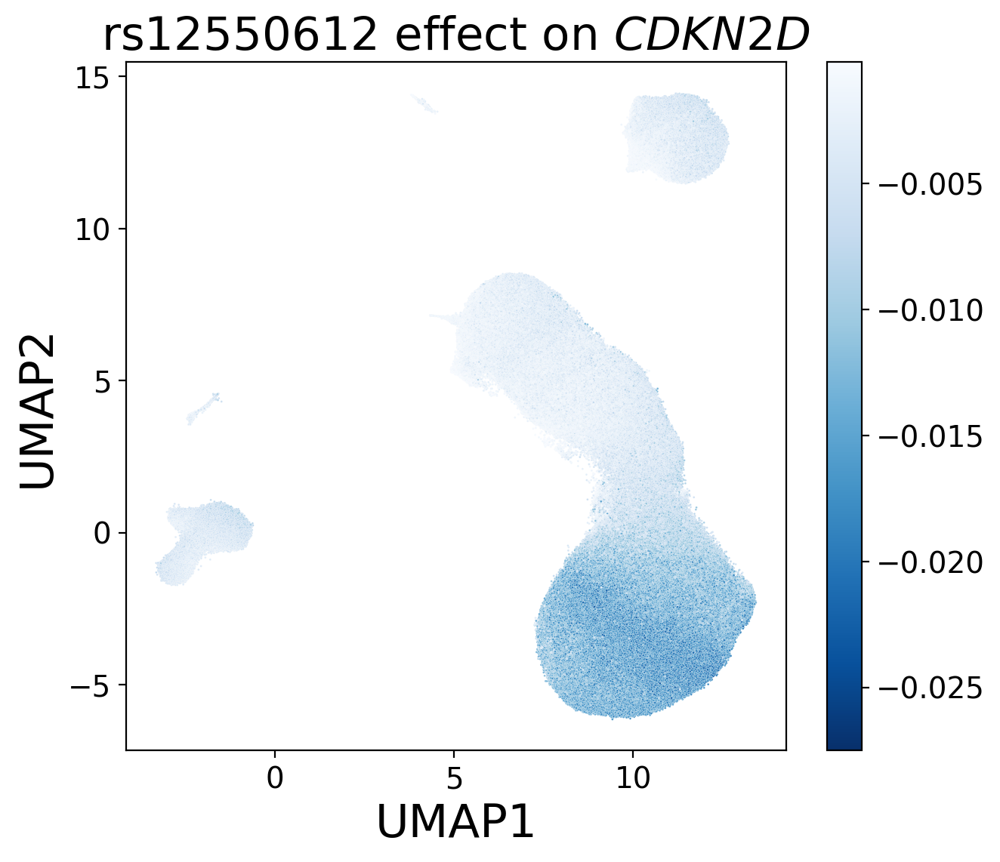

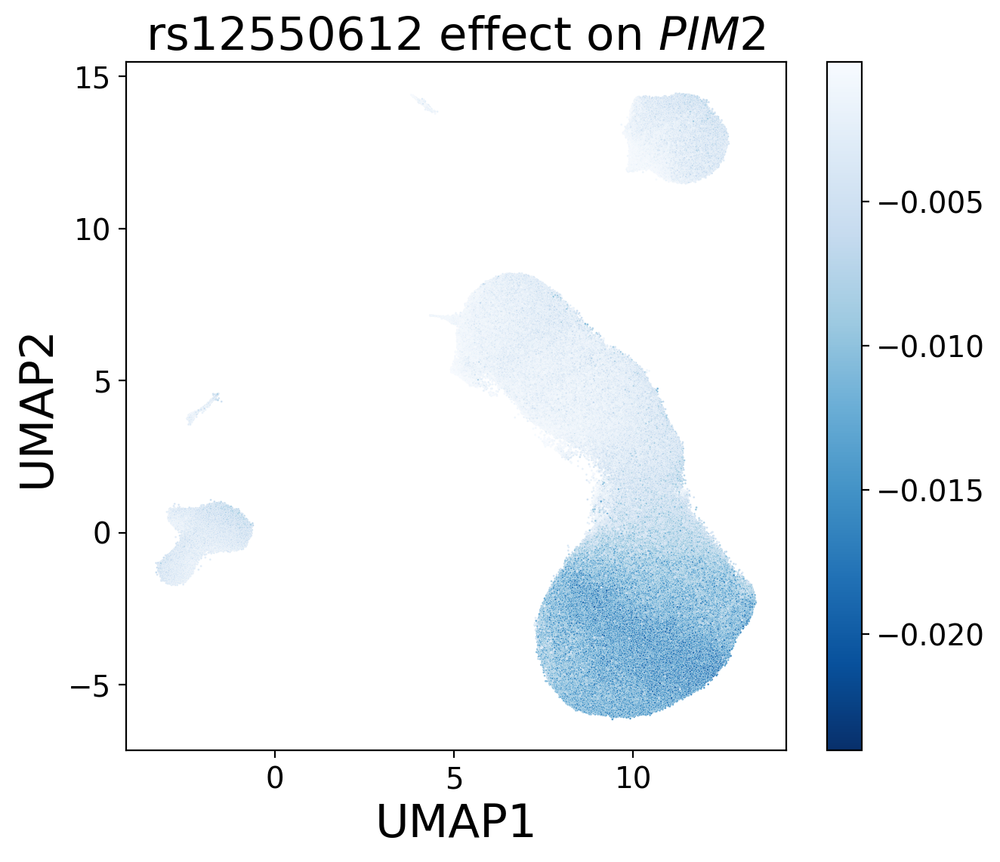

In [111]:
for g in GxC_decoder["GxC_Factor232"].abs().nlargest(10).index:

    hgnc_name = adata.var.loc[g].GeneSymbol
    if effect_on_genes[g].min() < 0 and effect_on_genes[g].max() > 0:
        comap = "RdBu_r" 
    elif effect_on_genes[g].min() < 0 and effect_on_genes[g].max() < 0:
        comap = "Blues_r"
    else:
        comap="Reds"
    
    fig, axs = plt.subplots(figsize=(7,6))
    sns.scatterplot(
        x="UMAP1",
        y="UMAP2",
        hue=g,
        data=umap_base.merge(effect_on_genes[g], right_index=True, left_index=True),
        ax=axs,
        s=1,
        palette=comap,
        rasterized=True,
        legend=False,
    )

    Norm = (colors.TwoSlopeNorm(vcenter=0.0, vmin=effect_on_genes[g].min(), vmax=effect_on_genes[g].max()) 
            if comap == "RdBu_r"
            else colors.Normalize(vmin=effect_on_genes[g].min(), vmax=effect_on_genes[g].max()))
    sm = cm.ScalarMappable(cmap=comap, norm=Norm)
    cb = plt.colorbar(sm, ax=axs)
    
    axs.set_title(
        label=f"{rsid} effect on ${hgnc_name}$", fontdict={"fontsize": 22}, loc="center"
    )
    axs.set_xlabel("UMAP1", fontsize=22)
    axs.set_ylabel("UMAP2", fontsize=22)
    
    plt.savefig(os.path.join(model_results_dir, "Figures", f"{model}_Softmax-GxC-SNP-effect-on-{hgnc_name}_U232_SNP-8-22966769.png"),
                             dpi=500, transparent=True, bbox_inches="tight")
    plt.savefig(os.path.join(model_results_dir, "Figures", f"{model}_Softmax-GxC-SNP-effect-on-{hgnc_name}_U232_SNP-8-22966769.pdf"),
                             dpi=800, transparent=True, bbox_inches="tight")

In [ ]:
effect_on_genes = effect_on_genes.filter(GxC_decoder["GxC_Factor232"].abs().nlargest(9).index)
effect_on_genes = effect_on_genes.merge(adata.obs.cell_label, right_index=True, left_index=True)

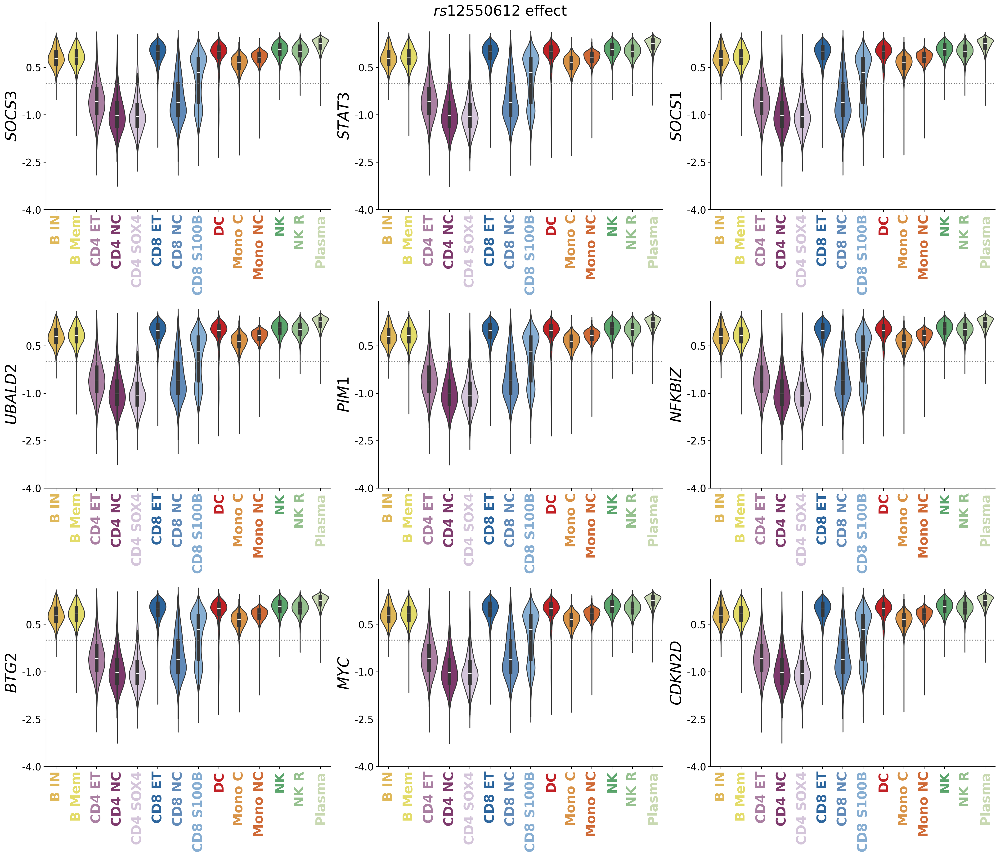

In [206]:
effect_on_genes_zscored = pd.DataFrame(zscore(effect_on_genes.filter(like="ENSG"), axis=0, ddof=1), 
                                       index=effect_on_genes.index, 
                                       columns=effect_on_genes.filter(like="ENSG").columns)
effect_on_genes_zscored = effect_on_genes_zscored.merge(adata.obs.cell_label, right_index=True, left_index=True)

fig, axs = plt.subplots(nrows=3, ncols=3,figsize=(21,18), constrained_layout=True)
axs = axs.flatten()

for i in range(effect_on_genes_zscored.filter(like="ENSG").shape[1]):
    GE = effect_on_genes_zscored.filter(like="ENSG").columns[i]
    GE_HGNC = adata.var.loc[GE].GeneSymbol
    violins = sns.violinplot(x="cell_label", y=GE, data=effect_on_genes_zscored,
                             hue="cell_label", palette=cell_label_colors, ax=axs[i])
    axs[i].axhline(y=0.0, color="grey", linestyle=":")
    # axs[i].set_ylabel(textwrap.fill(f"7:120903815 effect on {GE_HGNC}", width=15), fontsize=19)
    axs[i].set_ylabel(f"${GE_HGNC}$", fontsize=23)
    tick_interval = np.abs(axs[i].get_yticks().max() - axs[i].get_yticks().min())/4
    axs[i].set_yticks(np.arange(axs[i].get_yticks().min(), axs[i].get_yticks().max(), tick_interval),
                      np.round(np.arange(axs[i].get_yticks().min(), axs[i].get_yticks().max(), tick_interval),3), fontsize=15)
    axs[i].set_xlabel("")
    axs[i].set_xticks(axs[i].get_xticks(), axs[i].get_xticklabels(), rotation=90, fontsize=20)
    axs[i].spines["right"].set_visible(False)
    axs[i].spines["top"].set_visible(False)
    # Extract the colors used by the violins
    violin_colors = [child.get_facecolor() for child in violins.collections[::1]]
    for j, label in enumerate(axs[i].get_xticklabels()):
        label.set_color(violin_colors[j])
        label.set_fontweight("bold")

fig.suptitle(t=f"${rsid}$ effect", fontsize=22)

plt.savefig(os.path.join(model_results_dir, "Figures", f"{os.path.basename(model_results_dir)}_Violin-plots_Softmax-GxC-beta_8-22966769-effect-on-GENES_all-cells_U232_zscored.png"), 
            transparent=True, dpi=500, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", f"{os.path.basename(model_results_dir)}_Violin-plots_Softmax-GxC-beta_8-22966769-effect-on-GENES_all-cells_U232_zscored.eps"), 
            transparent=True, dpi=500, bbox_inches="tight")

### Circos plot

In [84]:
from pycirclize import Circos
from pycirclize.utils import load_eukaryote_example_dataset
# Load hg38 dataset (https://github.com/moshi4/pycirclize-data/tree/main/eukaryote/hg38)
chr_bed_file, cytoband_file, _ = load_eukaryote_example_dataset("hg38")

In [89]:
# Get positions of SNP and genes in GRCh38 coords
pos_hg38 = snp_mapping.loc[snp_mapping.SNP_id_hg19 == "8:22966769"].SNP_id_hg38.iloc[0]
pos_hg38

'8:23109256'

In [88]:
# Genomic coords obtaiend from biomart
genes_hg38 = pd.read_csv(
    os.path.join(model_results_dir, "TopGenes_IDs_GxC232_Biomart.txt"), 
    sep="\t")
genes_hg38.rename(columns={"Gene stable ID":"feature_id", 
                          "Gene name":"gene_name",
                          "Chromosome/scaffold name":"gene_chromosome", 
                          "Gene start (bp)":"gene_start", 
                          "Gene end (bp)":"gene_end"},
                 inplace=True)
genes_hg38.head()

,feature_id,gene_start,gene_end,gene_chromosome,gene_name
0,ENSG00000057657,105993463,106109939,6,PRDM1
1,ENSG00000059804,7919230,8019007,12,SLC2A3
2,ENSG00000062716,59707192,59842255,17,VMP1
3,ENSG00000102096,48913182,48919024,X,PIM2
4,ENSG00000129355,10566460,10569059,19,CDKN2D


In [90]:
genes_hg38 = genes_hg38.assign(gene_middle = (genes_hg38.gene_end + genes_hg38.gene_start)//2)

In [93]:
positive_effect = effect_on_genes.filter(like="ENSG").T.sum(axis=1) > 0
positive_effect = positive_effect.rename("positive_effect").to_frame().reset_index(names="feature_id")
positive_effect

,feature_id,positive_effect
0,ENSG00000184557,False
1,ENSG00000168610,False
2,ENSG00000185338,False
3,ENSG00000185262,False
4,ENSG00000137193,False
5,ENSG00000144802,False
6,ENSG00000159388,False
7,ENSG00000136997,False
8,ENSG00000129355,False
9,ENSG00000102096,False


In [94]:
genes_hg38 = genes_hg38.merge(positive_effect, on="feature_id", how="left")
genes_hg38

,feature_id,gene_start,gene_end,gene_chromosome,gene_name,gene_middle,positive_effect
0,ENSG00000057657,105993463,106109939,6,PRDM1,106051701,False
1,ENSG00000059804,7919230,8019007,12,SLC2A3,7969118,False
2,ENSG00000062716,59707192,59842255,17,VMP1,59774723,False
3,ENSG00000102096,48913182,48919024,X,PIM2,48916103,False
4,ENSG00000129355,10566460,10569059,19,CDKN2D,10567759,False
5,ENSG00000134333,18394347,18408425,11,LDHA,18401386,False
6,ENSG00000136997,127735434,127742951,8,MYC,127739192,False
7,ENSG00000137193,37170152,37175428,6,PIM1,37172790,False
8,ENSG00000144802,101827991,101861022,3,NFKBIZ,101844506,False
9,ENSG00000157514,107713221,107777342,X,TSC22D3,107745281,True


In [96]:
## Add SNP-gene links
links = []
chr_snp = "chr"+pos_hg38.split(":")[0]
pos_snp = int(pos_hg38.split(":")[1])
for _, row in genes_hg38.sort_values(["gene_chromosome", "gene_middle"], ascending=True).iterrows():
    links.append((chr_snp, pos_snp, "chr"+str(row.gene_chromosome), row.gene_middle, row.gene_name, row.positive_effect))

links[:3]

[('chr8', 23109256, 'chr1', 203307546, 'BTG2', False),
 ('chr8', 23109256, 'chr10', 72274979, 'DDIT4', False),
 ('chr8', 23109256, 'chr11', 18401386, 'LDHA', False)]

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


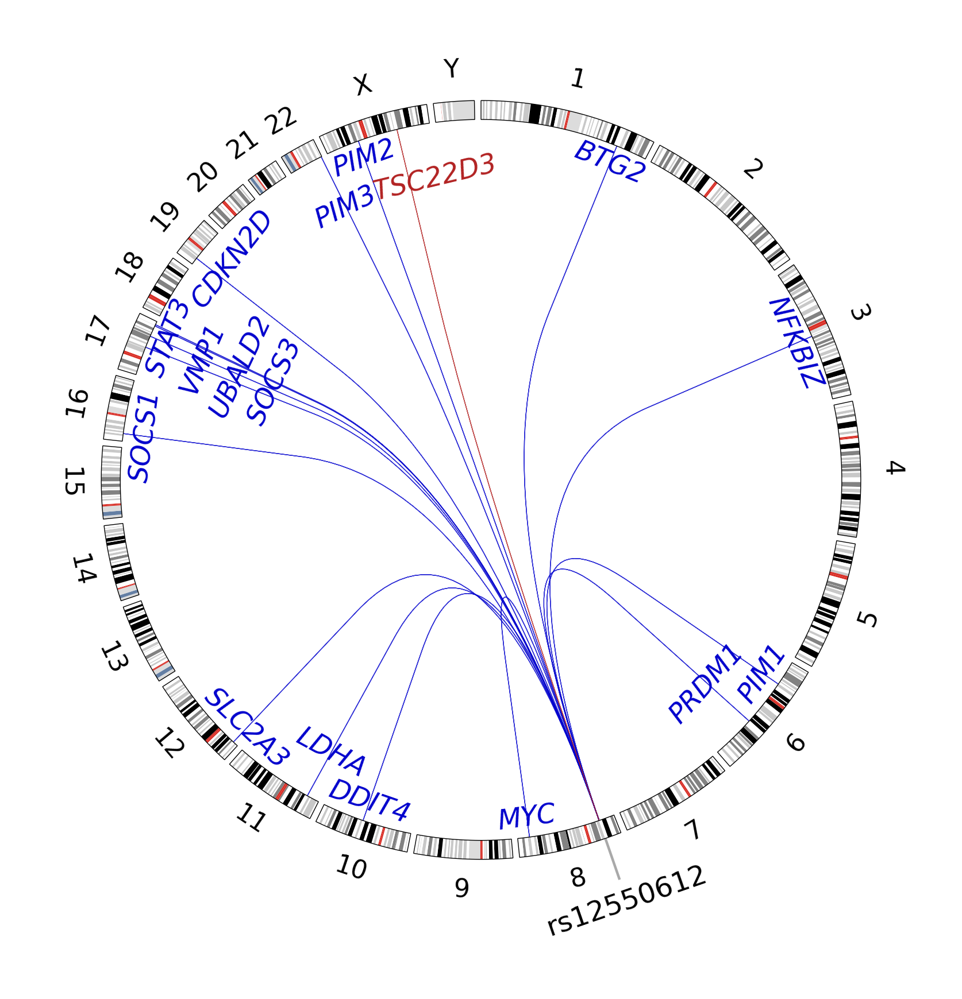

In [467]:
circos = Circos.initialize_from_bed(chr_bed_file, space=1)

# Add cytoband tracks from cytoband file
circos.add_cytoband_tracks((95, 100), cytoband_file)

# Plot chromosome name
for sector in circos.sectors:
    sector.text(sector.name.replace("chr", ""), size=16)

# Annotate SNP
sector = circos.get_sector(chr_snp)

track1 = sector.add_track((98, 100))
track1.xticks(
    x=[pos_snp],
    labels=[rsid],
    outer=True,
    tick_length=11.5, # 2.5,
    label_size=17.5,
    label_margin=2.5, # 0.3,
    label_orientation="horizontal", # "vertical",
    line_kws={"lw":1.6, "color":"darkgrey"},
    text_kws={"color":"black"},
)

# Annotate genes
# If there's already an annotation in this chrom, place the text more inside the circle to avoid overplotting
used_chroms = [chr_snp]
annotation_fontsize = 17
annotation_radius = 86.5
mradius = 10

for snp_chrom, snp_pos, gene_chrom, gene_pos, gene_name, effect in links:
    circos.link((snp_chrom, snp_pos, snp_pos), 
                (gene_chrom, gene_pos, gene_pos), 
                direction=1, arrow_length_ratio=0.5, color="firebrick" if effect else "mediumblue", alpha=0.8, lw=0.5)

    if gene_chrom == "chr11": # overplotting with chrom10
        sector = circos.get_sector(gene_chrom)
        sector.text(
            text=gene_name,
            x=gene_pos,
            r=annotation_radius-8,
            size=annotation_fontsize,
            color="firebrick" if effect else "mediumblue", # "black",
       #     fontweight="bold" if gene_name in enr_8_22966769_sign.loc[enr_8_22966769_sign.Term == "JAK-STAT signaling pathway"].Genes.str.split(";").iloc[0] else "normal",
            ha="center",
            va="center",
            fontstyle="italic",
            rotation="parallel"
        )
    elif gene_name == "PIM3": # overplotting with PIM2
        sector = circos.get_sector(gene_chrom)
        sector.text(
            text=gene_name,
            x=gene_pos,
            r=annotation_radius - mradius,
            size=annotation_fontsize,
            color="firebrick" if effect else "mediumblue", #"black",
        #    fontweight="bold" if gene_name in enr_8_22966769_sign.loc[enr_8_22966769_sign.Term == "JAK-STAT signaling pathway"].Genes.str.split(";").iloc[0] else "normal",
            ha="center",
            va="center",
            fontstyle="italic",
            rotation="parallel"
        )
    elif gene_name == "TSC22D3": # overplotting with PIM3
        sector = circos.get_sector(gene_chrom)
        sector.text(
            text="      "+gene_name,
            x=gene_pos,
            r=annotation_radius - mradius,
            size=annotation_fontsize,
            color="firebrick" if effect else "mediumblue", # "black",
         #   fontweight="bold" if gene_name in enr_8_22966769_sign.loc[enr_8_22966769_sign.Term == "JAK-STAT signaling pathway"].Genes.str.split(";").iloc[0] else "normal",
            ha="center",
            va="center",
            fontstyle="italic",
            rotation="parallel"
        )
    elif gene_name == "STAT3": # too close to SOCS1
        sector = circos.get_sector(gene_chrom)
        sector.text(
            text="    "+gene_name,
            x=gene_pos,
            r=annotation_radius,
            size=annotation_fontsize,
            color="firebrick" if effect else "mediumblue", # "black",
        #    fontweight="bold" if gene_name in enr_8_22966769_sign.loc[enr_8_22966769_sign.Term == "JAK-STAT signaling pathway"].Genes.str.split(";").iloc[0] else "normal",
            ha="center",
            va="center",
            fontstyle="italic",
            rotation="parallel"
        )
    elif gene_name == "CDKN2D": # too close to STAT3
        sector = circos.get_sector(gene_chrom)
        sector.text(
            text="     "+gene_name,
            x=gene_pos,
            r=annotation_radius-3,
            size=annotation_fontsize,
            color="firebrick" if effect else "mediumblue", # "black",
         #   fontweight="bold" if gene_name in enr_8_22966769_sign.loc[enr_8_22966769_sign.Term == "JAK-STAT signaling pathway"].Genes.str.split(";").iloc[0] else "normal",
            ha="center",
            va="center",
            fontstyle="italic",
            rotation="parallel"
        )
    elif gene_name == "MYC":
        sector = circos.get_sector(gene_chrom)
        sector.text(
            text=gene_name,
            x=gene_pos,
            r=annotation_radius,
            size=annotation_fontsize,
            color="firebrick" if effect else "mediumblue", # "black",
          #  fontweight="bold" if gene_name in enr_8_22966769_sign.loc[enr_8_22966769_sign.Term == "JAK-STAT signaling pathway"].Genes.str.split(";").iloc[0] else "normal",
            ha="center",
            va="center",
            fontstyle="italic",
            rotation="parallel"
        )
    elif gene_name == "SOCS1":
        sector = circos.get_sector(gene_chrom)
        sector.text(
            text=gene_name,
            x=gene_pos,
            r=annotation_radius-1,
            size=annotation_fontsize,
            color="firebrick" if effect else "mediumblue", # "black",
         #   fontweight="bold" if gene_name in enr_8_22966769_sign.loc[enr_8_22966769_sign.Term == "JAK-STAT signaling pathway"].Genes.str.split(";").iloc[0] else "normal",
            ha="center",
            va="center",
            fontstyle="italic",
            rotation="parallel"
        )
    else:
        if gene_chrom in used_chroms:
            occurences = used_chroms.count(gene_chrom)
            new_radius = annotation_radius - occurences*mradius
        else:
           new_radius = annotation_radius
        sector = circos.get_sector(gene_chrom)
        sector.text(
            text=gene_name,
            x=gene_pos,
            r=new_radius,
            size=annotation_fontsize,
            color="firebrick" if effect else "mediumblue",
      #      fontweight="bold" if gene_name in enr_8_22966769_sign.loc[enr_8_22966769_sign.Term == "JAK-STAT signaling pathway"].Genes.str.split(";").iloc[0] else "normal",
            ha="center",
            va="center",
            fontstyle="italic",
            rotation="parallel"
        )
    used_chroms.append(gene_chrom)

fig = circos.plotfig()
plt.savefig(os.path.join(model_results_dir, "Figures", "Circos-plot_SNP-8-22966769_top-17-genes-GxC232_horizontal-SNP-name_wo-bold.png"),
            dpi=400, bbox_inches="tight", transparent=True)
plt.savefig(os.path.join(model_results_dir, "Figures", "Circos-plot_SNP-8-22966769_top-17-genes-GxC232_horizontal-SNP-name_wo-bold.eps"),
            dpi=300, bbox_inches="tight", transparent=True)
plt.savefig(os.path.join(model_results_dir, "Figures", "Circos-plot_SNP-8-22966769_top-17-genes-GxC232_horizontal-SNP-name_wo-bold.pdf"),
            dpi=300, bbox_inches="tight", transparent=True)

In [133]:
enr_8_22966769_sign.loc[enr_8_22966769_sign.Term == "JAK-STAT signaling pathway"].Genes.str.split(";").iloc[0]

['SOCS3', 'SOCS1', 'MYC', 'STAT3', 'PIM1']